# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory 'data': File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:16, 11.3MB/s]                              
SVHN Testing Set: 64.3MB [00:05, 10.8MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

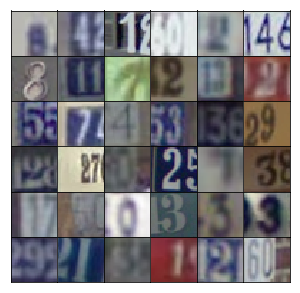

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4*4*512)
        # Reshape it to start the convolutional stack
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        # 4x4x512 now
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        # 8x8x256 now
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        # 16x16x128 now
        
        # Output layer
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        # 32x32x3 now
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've build before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU. 

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        relu1 = tf.maximum(alpha * x1, x1)
        # 16x16x64
        
        x2 = tf.layers.conv2d(relu1, 128, 5, strides=2, padding='same')
        bn2 = tf.layers.batch_normalization(x2, training=True)
        relu2 = tf.maximum(alpha * bn2, bn2)
        # 8x8x128
        
        x3 = tf.layers.conv2d(relu2, 256, 5, strides=2, padding='same')
        bn3 = tf.layers.batch_normalization(x3, training=True)
        relu3 = tf.maximum(alpha * bn3, bn3)
        # 4x4x256

        # Flatten it
        flat = tf.reshape(relu3, (-1, 4*4*256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

In [ ]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.2
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.4221... Generator Loss: 0.5389
Epoch 1/25... Discriminator Loss: 0.3327... Generator Loss: 2.0994
Epoch 1/25... Discriminator Loss: 0.1740... Generator Loss: 2.6098
Epoch 1/25... Discriminator Loss: 0.1329... Generator Loss: 2.9675
Epoch 1/25... Discriminator Loss: 0.1457... Generator Loss: 2.8174
Epoch 1/25... Discriminator Loss: 0.1094... Generator Loss: 2.9862
Epoch 1/25... Discriminator Loss: 0.1258... Generator Loss: 2.7310
Epoch 1/25... Discriminator Loss: 0.3017... Generator Loss: 2.4161
Epoch 1/25... Discriminator Loss: 1.3845... Generator Loss: 0.6789
Epoch 1/25... Discriminator Loss: 1.1453... Generator Loss: 1.3197


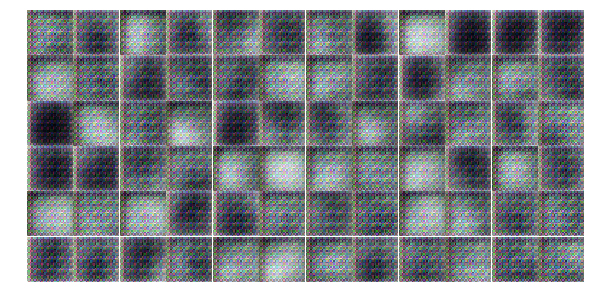

Epoch 1/25... Discriminator Loss: 0.4573... Generator Loss: 1.5958
Epoch 1/25... Discriminator Loss: 0.3148... Generator Loss: 2.4403
Epoch 1/25... Discriminator Loss: 0.9360... Generator Loss: 0.6366
Epoch 1/25... Discriminator Loss: 0.3932... Generator Loss: 1.8876
Epoch 1/25... Discriminator Loss: 0.9528... Generator Loss: 0.6756
Epoch 1/25... Discriminator Loss: 0.4726... Generator Loss: 1.5876
Epoch 1/25... Discriminator Loss: 0.2125... Generator Loss: 2.4299
Epoch 1/25... Discriminator Loss: 1.1804... Generator Loss: 3.4995
Epoch 1/25... Discriminator Loss: 0.6091... Generator Loss: 3.3102
Epoch 1/25... Discriminator Loss: 1.2047... Generator Loss: 2.5641


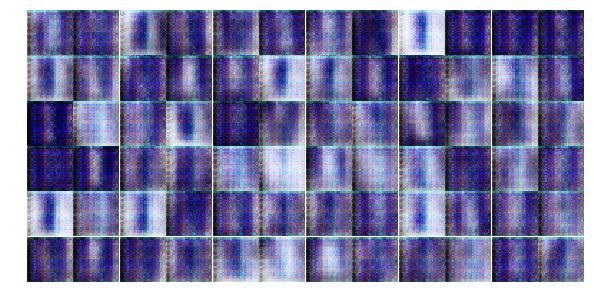

Epoch 1/25... Discriminator Loss: 0.7523... Generator Loss: 2.1704
Epoch 1/25... Discriminator Loss: 0.3157... Generator Loss: 4.1006
Epoch 1/25... Discriminator Loss: 3.1005... Generator Loss: 0.0720
Epoch 1/25... Discriminator Loss: 1.0529... Generator Loss: 0.9664
Epoch 1/25... Discriminator Loss: 0.8451... Generator Loss: 1.5788
Epoch 1/25... Discriminator Loss: 0.6186... Generator Loss: 1.5050
Epoch 1/25... Discriminator Loss: 0.8452... Generator Loss: 0.9846
Epoch 1/25... Discriminator Loss: 0.8081... Generator Loss: 0.9386
Epoch 1/25... Discriminator Loss: 0.5145... Generator Loss: 1.5756
Epoch 1/25... Discriminator Loss: 0.3908... Generator Loss: 2.3434


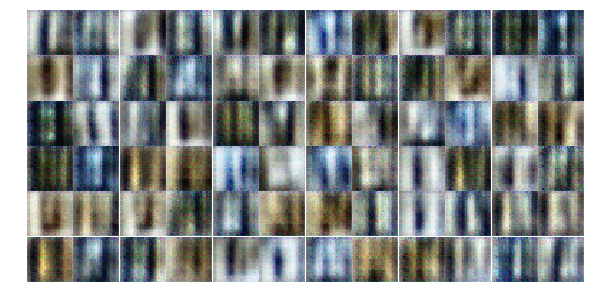

Epoch 1/25... Discriminator Loss: 0.7095... Generator Loss: 1.3085
Epoch 1/25... Discriminator Loss: 0.6259... Generator Loss: 1.1964
Epoch 1/25... Discriminator Loss: 0.3788... Generator Loss: 1.9091
Epoch 1/25... Discriminator Loss: 0.4556... Generator Loss: 1.3982
Epoch 1/25... Discriminator Loss: 0.4064... Generator Loss: 1.5455
Epoch 1/25... Discriminator Loss: 1.3254... Generator Loss: 0.6877
Epoch 1/25... Discriminator Loss: 0.4553... Generator Loss: 2.0658
Epoch 1/25... Discriminator Loss: 0.4103... Generator Loss: 3.2380
Epoch 1/25... Discriminator Loss: 0.6674... Generator Loss: 1.4225
Epoch 1/25... Discriminator Loss: 0.7721... Generator Loss: 1.1557


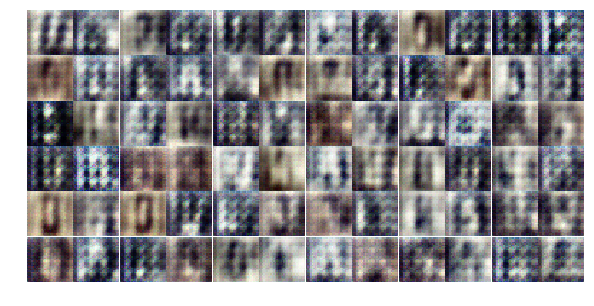

Epoch 1/25... Discriminator Loss: 0.6279... Generator Loss: 1.2956
Epoch 1/25... Discriminator Loss: 0.4539... Generator Loss: 2.1475
Epoch 1/25... Discriminator Loss: 0.8111... Generator Loss: 0.9117
Epoch 1/25... Discriminator Loss: 1.4321... Generator Loss: 0.6625
Epoch 1/25... Discriminator Loss: 0.9168... Generator Loss: 0.9000
Epoch 1/25... Discriminator Loss: 0.9103... Generator Loss: 0.9601
Epoch 1/25... Discriminator Loss: 0.7879... Generator Loss: 1.4554
Epoch 1/25... Discriminator Loss: 0.7789... Generator Loss: 1.4050
Epoch 1/25... Discriminator Loss: 0.5320... Generator Loss: 1.3792
Epoch 1/25... Discriminator Loss: 0.7927... Generator Loss: 1.2461


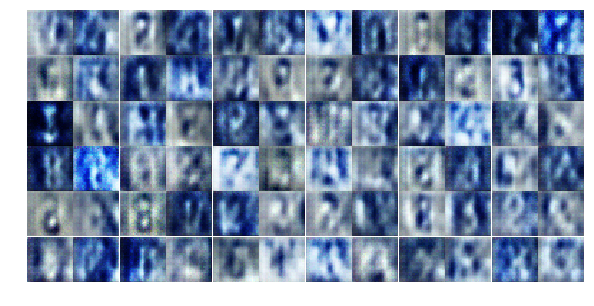

Epoch 1/25... Discriminator Loss: 0.6969... Generator Loss: 1.7393
Epoch 1/25... Discriminator Loss: 0.8134... Generator Loss: 1.3550
Epoch 1/25... Discriminator Loss: 0.8869... Generator Loss: 1.0111
Epoch 1/25... Discriminator Loss: 0.7556... Generator Loss: 1.0847
Epoch 1/25... Discriminator Loss: 0.6293... Generator Loss: 1.9729
Epoch 1/25... Discriminator Loss: 0.9045... Generator Loss: 0.8780
Epoch 1/25... Discriminator Loss: 0.7458... Generator Loss: 1.5140
Epoch 2/25... Discriminator Loss: 0.8619... Generator Loss: 1.4695
Epoch 2/25... Discriminator Loss: 0.5971... Generator Loss: 1.5591
Epoch 2/25... Discriminator Loss: 1.1002... Generator Loss: 0.7581


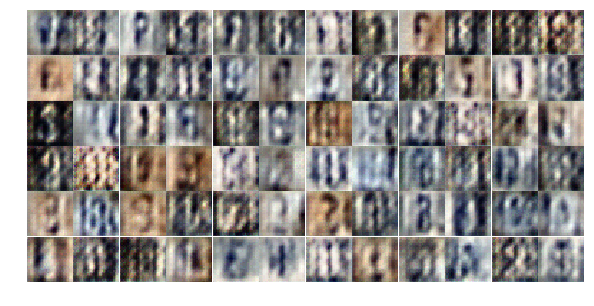

Epoch 2/25... Discriminator Loss: 0.9395... Generator Loss: 1.8614
Epoch 2/25... Discriminator Loss: 1.7091... Generator Loss: 0.3566
Epoch 2/25... Discriminator Loss: 1.2670... Generator Loss: 0.6876
Epoch 2/25... Discriminator Loss: 1.6477... Generator Loss: 0.5271
Epoch 2/25... Discriminator Loss: 1.3844... Generator Loss: 0.8620
Epoch 2/25... Discriminator Loss: 0.9933... Generator Loss: 1.3395
Epoch 2/25... Discriminator Loss: 0.8050... Generator Loss: 1.1983
Epoch 2/25... Discriminator Loss: 0.9130... Generator Loss: 1.2131
Epoch 2/25... Discriminator Loss: 0.7693... Generator Loss: 1.0878
Epoch 2/25... Discriminator Loss: 0.7357... Generator Loss: 1.2994


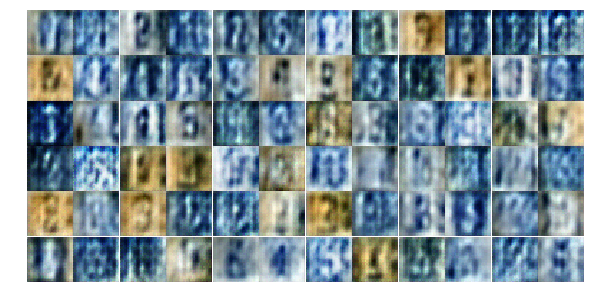

Epoch 2/25... Discriminator Loss: 1.0227... Generator Loss: 1.1508
Epoch 2/25... Discriminator Loss: 1.0100... Generator Loss: 1.9872
Epoch 2/25... Discriminator Loss: 0.8809... Generator Loss: 1.2913
Epoch 2/25... Discriminator Loss: 0.7476... Generator Loss: 1.0831
Epoch 2/25... Discriminator Loss: 1.0396... Generator Loss: 1.2810
Epoch 2/25... Discriminator Loss: 0.9093... Generator Loss: 1.2550
Epoch 2/25... Discriminator Loss: 0.8458... Generator Loss: 1.0944
Epoch 2/25... Discriminator Loss: 1.1564... Generator Loss: 0.6830
Epoch 2/25... Discriminator Loss: 1.2280... Generator Loss: 0.9156
Epoch 2/25... Discriminator Loss: 1.0399... Generator Loss: 0.7474


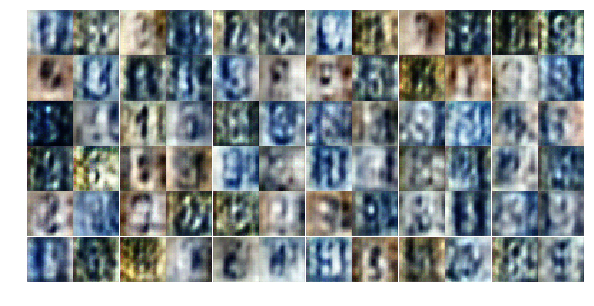

Epoch 2/25... Discriminator Loss: 1.1824... Generator Loss: 0.7055
Epoch 2/25... Discriminator Loss: 1.1390... Generator Loss: 0.6281
Epoch 2/25... Discriminator Loss: 1.0400... Generator Loss: 0.8763
Epoch 2/25... Discriminator Loss: 1.0394... Generator Loss: 1.2267
Epoch 2/25... Discriminator Loss: 1.0267... Generator Loss: 0.8842
Epoch 2/25... Discriminator Loss: 1.1503... Generator Loss: 1.0843
Epoch 2/25... Discriminator Loss: 1.2061... Generator Loss: 0.6707
Epoch 2/25... Discriminator Loss: 1.0490... Generator Loss: 0.7586
Epoch 2/25... Discriminator Loss: 0.9565... Generator Loss: 0.9883
Epoch 2/25... Discriminator Loss: 0.9433... Generator Loss: 0.9137


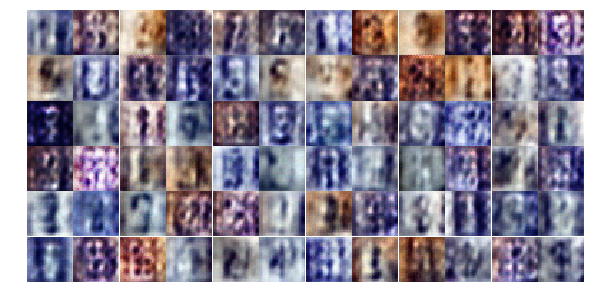

Epoch 2/25... Discriminator Loss: 1.0030... Generator Loss: 1.1645
Epoch 2/25... Discriminator Loss: 1.0308... Generator Loss: 0.9252
Epoch 2/25... Discriminator Loss: 1.4247... Generator Loss: 0.4798
Epoch 2/25... Discriminator Loss: 1.9235... Generator Loss: 0.2336
Epoch 2/25... Discriminator Loss: 0.9700... Generator Loss: 1.1831
Epoch 2/25... Discriminator Loss: 1.5393... Generator Loss: 0.6996
Epoch 2/25... Discriminator Loss: 1.1941... Generator Loss: 1.1199
Epoch 2/25... Discriminator Loss: 0.8463... Generator Loss: 1.4491
Epoch 2/25... Discriminator Loss: 0.8706... Generator Loss: 1.1431
Epoch 2/25... Discriminator Loss: 1.0706... Generator Loss: 1.1580


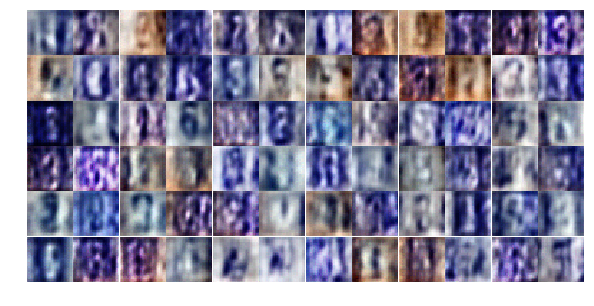

Epoch 2/25... Discriminator Loss: 0.8667... Generator Loss: 0.9525
Epoch 2/25... Discriminator Loss: 1.0777... Generator Loss: 1.2131
Epoch 2/25... Discriminator Loss: 1.0154... Generator Loss: 0.8356
Epoch 2/25... Discriminator Loss: 1.2399... Generator Loss: 0.6164
Epoch 2/25... Discriminator Loss: 1.3900... Generator Loss: 0.5804
Epoch 2/25... Discriminator Loss: 0.8616... Generator Loss: 0.9585
Epoch 2/25... Discriminator Loss: 0.9508... Generator Loss: 2.5009
Epoch 2/25... Discriminator Loss: 0.9424... Generator Loss: 0.9717
Epoch 2/25... Discriminator Loss: 0.7822... Generator Loss: 1.8064
Epoch 2/25... Discriminator Loss: 0.9429... Generator Loss: 1.1810


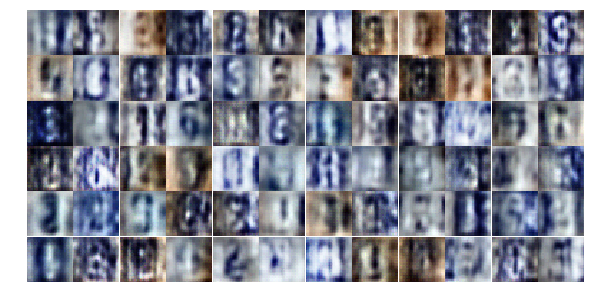

Epoch 2/25... Discriminator Loss: 0.9428... Generator Loss: 1.6981
Epoch 2/25... Discriminator Loss: 0.8316... Generator Loss: 1.9039
Epoch 2/25... Discriminator Loss: 1.3086... Generator Loss: 0.5252
Epoch 2/25... Discriminator Loss: 0.9640... Generator Loss: 0.7798
Epoch 3/25... Discriminator Loss: 0.5344... Generator Loss: 2.3981
Epoch 3/25... Discriminator Loss: 0.8231... Generator Loss: 1.1613
Epoch 3/25... Discriminator Loss: 1.4992... Generator Loss: 2.0856
Epoch 3/25... Discriminator Loss: 0.5402... Generator Loss: 1.5252
Epoch 3/25... Discriminator Loss: 1.3842... Generator Loss: 2.9714
Epoch 3/25... Discriminator Loss: 0.7986... Generator Loss: 1.0813


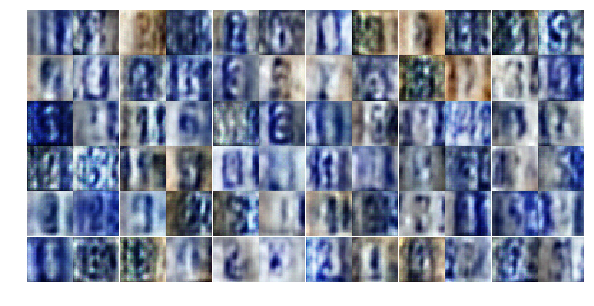

Epoch 3/25... Discriminator Loss: 0.5796... Generator Loss: 1.5656
Epoch 3/25... Discriminator Loss: 0.7350... Generator Loss: 2.0210
Epoch 3/25... Discriminator Loss: 0.8688... Generator Loss: 0.8883
Epoch 3/25... Discriminator Loss: 0.7184... Generator Loss: 1.1686
Epoch 3/25... Discriminator Loss: 0.7692... Generator Loss: 0.9484
Epoch 3/25... Discriminator Loss: 0.9159... Generator Loss: 2.0468
Epoch 3/25... Discriminator Loss: 0.8210... Generator Loss: 1.1965
Epoch 3/25... Discriminator Loss: 0.7551... Generator Loss: 1.1088
Epoch 3/25... Discriminator Loss: 0.4779... Generator Loss: 2.1350
Epoch 3/25... Discriminator Loss: 0.5097... Generator Loss: 1.2868


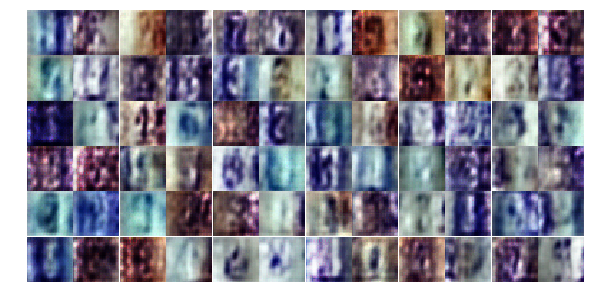

Epoch 3/25... Discriminator Loss: 1.3074... Generator Loss: 2.5688
Epoch 3/25... Discriminator Loss: 0.8958... Generator Loss: 1.1672
Epoch 3/25... Discriminator Loss: 0.5954... Generator Loss: 1.1470
Epoch 3/25... Discriminator Loss: 0.3970... Generator Loss: 2.0695
Epoch 3/25... Discriminator Loss: 1.1133... Generator Loss: 0.5942
Epoch 3/25... Discriminator Loss: 0.5404... Generator Loss: 2.1957
Epoch 3/25... Discriminator Loss: 0.6874... Generator Loss: 1.1668
Epoch 3/25... Discriminator Loss: 0.2589... Generator Loss: 2.4034
Epoch 3/25... Discriminator Loss: 0.5469... Generator Loss: 1.2431
Epoch 3/25... Discriminator Loss: 0.4722... Generator Loss: 1.3900


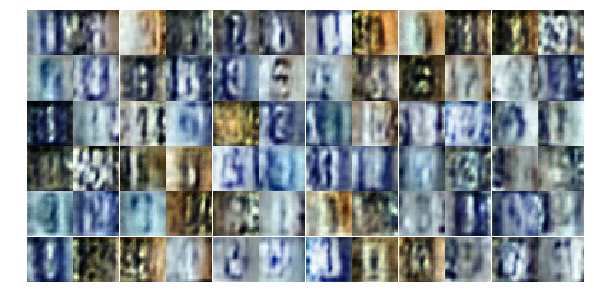

Epoch 3/25... Discriminator Loss: 0.6648... Generator Loss: 1.6041
Epoch 3/25... Discriminator Loss: 0.9664... Generator Loss: 1.3436
Epoch 3/25... Discriminator Loss: 0.9749... Generator Loss: 1.4567
Epoch 3/25... Discriminator Loss: 1.1504... Generator Loss: 0.5446
Epoch 3/25... Discriminator Loss: 0.4238... Generator Loss: 2.1642
Epoch 3/25... Discriminator Loss: 0.3675... Generator Loss: 2.3047
Epoch 3/25... Discriminator Loss: 0.7240... Generator Loss: 1.1038
Epoch 3/25... Discriminator Loss: 0.4984... Generator Loss: 2.4172
Epoch 3/25... Discriminator Loss: 0.4878... Generator Loss: 1.6220
Epoch 3/25... Discriminator Loss: 0.5069... Generator Loss: 1.5710


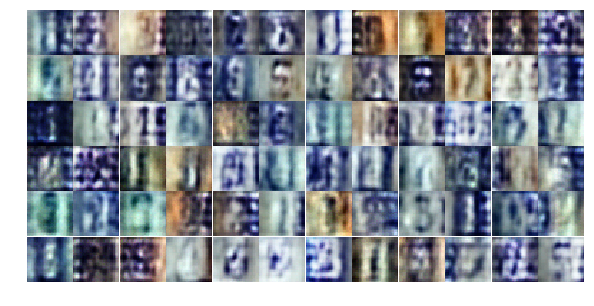

Epoch 3/25... Discriminator Loss: 0.4828... Generator Loss: 1.8543
Epoch 3/25... Discriminator Loss: 0.7376... Generator Loss: 3.0529
Epoch 3/25... Discriminator Loss: 0.5922... Generator Loss: 1.4502
Epoch 3/25... Discriminator Loss: 0.8469... Generator Loss: 2.6427
Epoch 3/25... Discriminator Loss: 0.6035... Generator Loss: 1.4345
Epoch 3/25... Discriminator Loss: 0.8544... Generator Loss: 2.2795
Epoch 3/25... Discriminator Loss: 0.5607... Generator Loss: 1.4998
Epoch 3/25... Discriminator Loss: 0.3445... Generator Loss: 2.4434
Epoch 3/25... Discriminator Loss: 0.5844... Generator Loss: 4.4114
Epoch 3/25... Discriminator Loss: 2.0869... Generator Loss: 4.2912


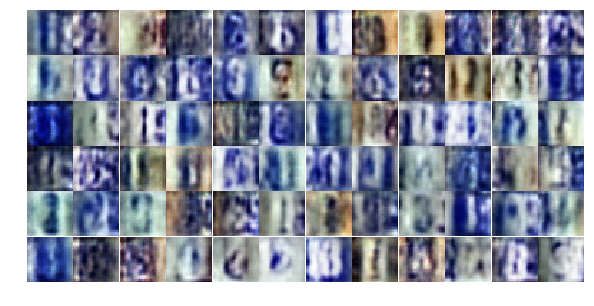

Epoch 3/25... Discriminator Loss: 0.6255... Generator Loss: 1.7348
Epoch 3/25... Discriminator Loss: 0.5764... Generator Loss: 1.7063
Epoch 3/25... Discriminator Loss: 0.4788... Generator Loss: 1.3769
Epoch 3/25... Discriminator Loss: 0.3248... Generator Loss: 2.1052
Epoch 3/25... Discriminator Loss: 0.5342... Generator Loss: 1.9211
Epoch 3/25... Discriminator Loss: 0.5333... Generator Loss: 1.4430
Epoch 3/25... Discriminator Loss: 0.7158... Generator Loss: 1.1156
Epoch 3/25... Discriminator Loss: 0.5632... Generator Loss: 1.8700
Epoch 3/25... Discriminator Loss: 0.3974... Generator Loss: 1.9936
Epoch 3/25... Discriminator Loss: 0.5922... Generator Loss: 1.2704


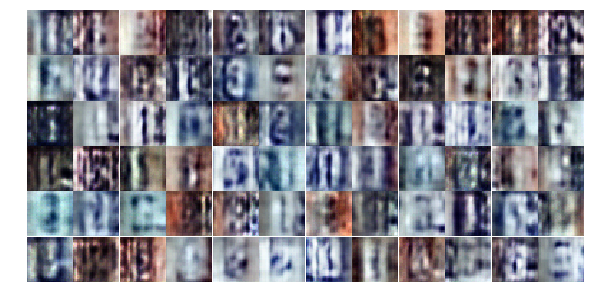

Epoch 3/25... Discriminator Loss: 0.3984... Generator Loss: 1.7385
Epoch 4/25... Discriminator Loss: 0.8368... Generator Loss: 0.9808
Epoch 4/25... Discriminator Loss: 0.4640... Generator Loss: 2.0860
Epoch 4/25... Discriminator Loss: 0.7126... Generator Loss: 1.2124
Epoch 4/25... Discriminator Loss: 0.5082... Generator Loss: 1.7325
Epoch 4/25... Discriminator Loss: 0.4577... Generator Loss: 2.7380
Epoch 4/25... Discriminator Loss: 0.7831... Generator Loss: 0.9056
Epoch 4/25... Discriminator Loss: 0.7351... Generator Loss: 1.3016
Epoch 4/25... Discriminator Loss: 0.3897... Generator Loss: 2.5394
Epoch 4/25... Discriminator Loss: 0.7715... Generator Loss: 1.0660


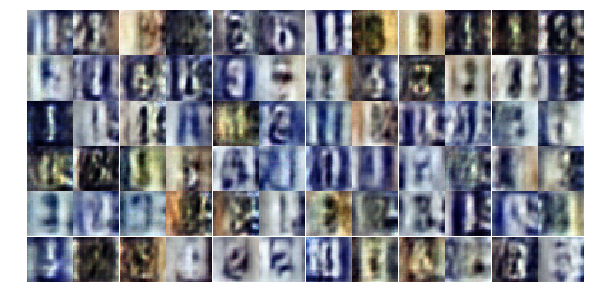

Epoch 4/25... Discriminator Loss: 0.2466... Generator Loss: 2.6362
Epoch 4/25... Discriminator Loss: 0.4582... Generator Loss: 1.3522
Epoch 4/25... Discriminator Loss: 1.2628... Generator Loss: 0.7029
Epoch 4/25... Discriminator Loss: 0.5138... Generator Loss: 1.4034
Epoch 4/25... Discriminator Loss: 0.8429... Generator Loss: 2.5324
Epoch 4/25... Discriminator Loss: 1.4641... Generator Loss: 0.3686
Epoch 4/25... Discriminator Loss: 0.6208... Generator Loss: 1.2317
Epoch 4/25... Discriminator Loss: 1.4988... Generator Loss: 0.3927
Epoch 4/25... Discriminator Loss: 0.6853... Generator Loss: 1.7016
Epoch 4/25... Discriminator Loss: 0.5294... Generator Loss: 2.2233


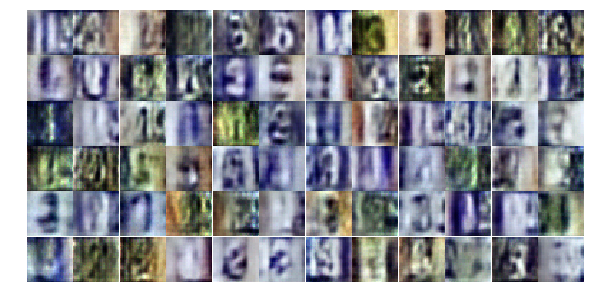

Epoch 4/25... Discriminator Loss: 0.5286... Generator Loss: 1.3865
Epoch 4/25... Discriminator Loss: 1.1269... Generator Loss: 0.5178
Epoch 4/25... Discriminator Loss: 0.9265... Generator Loss: 0.7369
Epoch 4/25... Discriminator Loss: 0.5480... Generator Loss: 1.3740
Epoch 4/25... Discriminator Loss: 0.3931... Generator Loss: 1.7901
Epoch 4/25... Discriminator Loss: 0.4020... Generator Loss: 2.2163
Epoch 4/25... Discriminator Loss: 1.2338... Generator Loss: 0.5169
Epoch 4/25... Discriminator Loss: 0.8545... Generator Loss: 0.9734
Epoch 4/25... Discriminator Loss: 0.3343... Generator Loss: 2.0456
Epoch 4/25... Discriminator Loss: 0.4467... Generator Loss: 1.5497


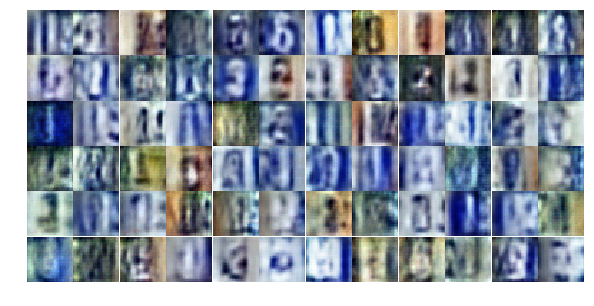

Epoch 4/25... Discriminator Loss: 0.5668... Generator Loss: 1.2902
Epoch 4/25... Discriminator Loss: 0.4584... Generator Loss: 1.5994
Epoch 4/25... Discriminator Loss: 0.7202... Generator Loss: 1.0181
Epoch 4/25... Discriminator Loss: 0.3519... Generator Loss: 2.4903
Epoch 4/25... Discriminator Loss: 0.4712... Generator Loss: 1.7246
Epoch 4/25... Discriminator Loss: 0.2602... Generator Loss: 2.7788
Epoch 4/25... Discriminator Loss: 0.2494... Generator Loss: 1.9938
Epoch 4/25... Discriminator Loss: 1.0181... Generator Loss: 0.7148
Epoch 4/25... Discriminator Loss: 0.7829... Generator Loss: 2.0450
Epoch 4/25... Discriminator Loss: 0.6524... Generator Loss: 1.0008


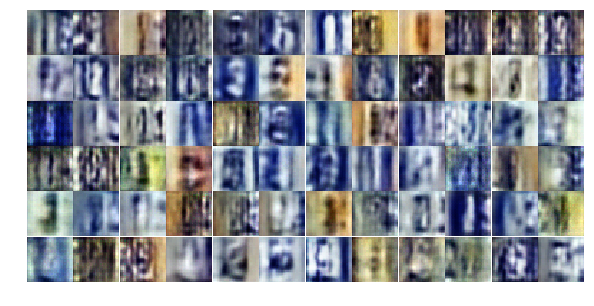

Epoch 4/25... Discriminator Loss: 0.7470... Generator Loss: 1.5067
Epoch 4/25... Discriminator Loss: 0.5848... Generator Loss: 1.1140
Epoch 4/25... Discriminator Loss: 0.9933... Generator Loss: 3.1121
Epoch 4/25... Discriminator Loss: 0.3832... Generator Loss: 1.9549
Epoch 4/25... Discriminator Loss: 0.4537... Generator Loss: 1.6544
Epoch 4/25... Discriminator Loss: 0.8635... Generator Loss: 0.9731
Epoch 4/25... Discriminator Loss: 0.4891... Generator Loss: 2.3872
Epoch 4/25... Discriminator Loss: 0.5952... Generator Loss: 2.8929
Epoch 4/25... Discriminator Loss: 0.8420... Generator Loss: 2.4653
Epoch 4/25... Discriminator Loss: 0.3502... Generator Loss: 1.8359


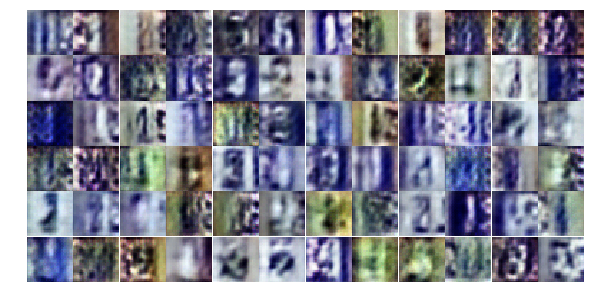

Epoch 4/25... Discriminator Loss: 0.5147... Generator Loss: 1.4151
Epoch 4/25... Discriminator Loss: 0.5841... Generator Loss: 1.3118
Epoch 4/25... Discriminator Loss: 0.3740... Generator Loss: 1.6730
Epoch 4/25... Discriminator Loss: 0.3341... Generator Loss: 2.4807
Epoch 4/25... Discriminator Loss: 2.1948... Generator Loss: 4.5851
Epoch 4/25... Discriminator Loss: 0.8015... Generator Loss: 0.9465
Epoch 4/25... Discriminator Loss: 0.9591... Generator Loss: 2.5467
Epoch 4/25... Discriminator Loss: 0.5140... Generator Loss: 1.6328
Epoch 4/25... Discriminator Loss: 0.5041... Generator Loss: 1.3584
Epoch 5/25... Discriminator Loss: 0.5767... Generator Loss: 1.9727


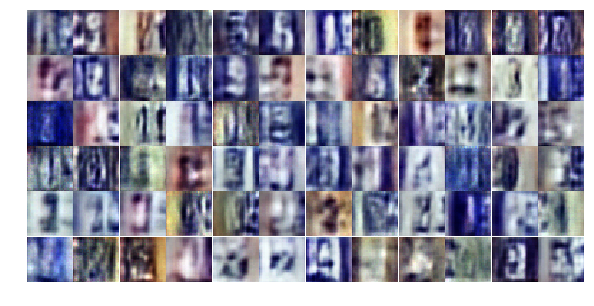

Epoch 5/25... Discriminator Loss: 1.4176... Generator Loss: 0.4324
Epoch 5/25... Discriminator Loss: 0.4883... Generator Loss: 1.4281
Epoch 5/25... Discriminator Loss: 0.5826... Generator Loss: 1.2041
Epoch 5/25... Discriminator Loss: 0.8790... Generator Loss: 0.6877
Epoch 5/25... Discriminator Loss: 0.3611... Generator Loss: 2.2085
Epoch 5/25... Discriminator Loss: 1.2310... Generator Loss: 0.4395
Epoch 5/25... Discriminator Loss: 0.7189... Generator Loss: 0.9530
Epoch 5/25... Discriminator Loss: 0.5869... Generator Loss: 1.2032
Epoch 5/25... Discriminator Loss: 0.5963... Generator Loss: 1.1763
Epoch 5/25... Discriminator Loss: 0.6780... Generator Loss: 1.1445


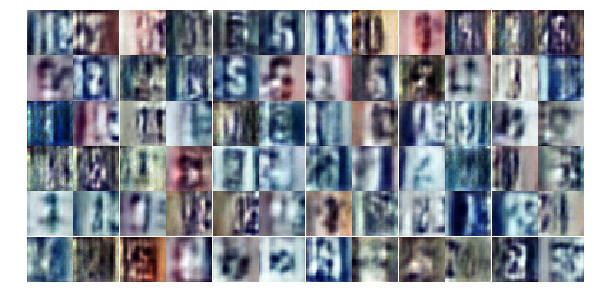

Epoch 5/25... Discriminator Loss: 0.3663... Generator Loss: 1.8080
Epoch 5/25... Discriminator Loss: 0.4882... Generator Loss: 1.3214
Epoch 5/25... Discriminator Loss: 0.4782... Generator Loss: 2.9921
Epoch 5/25... Discriminator Loss: 1.1751... Generator Loss: 0.6224
Epoch 5/25... Discriminator Loss: 0.5542... Generator Loss: 2.1924
Epoch 5/25... Discriminator Loss: 0.5018... Generator Loss: 1.9616
Epoch 5/25... Discriminator Loss: 0.3658... Generator Loss: 1.8525
Epoch 5/25... Discriminator Loss: 0.8626... Generator Loss: 0.9632
Epoch 5/25... Discriminator Loss: 0.3507... Generator Loss: 1.9154
Epoch 5/25... Discriminator Loss: 0.4262... Generator Loss: 1.6836


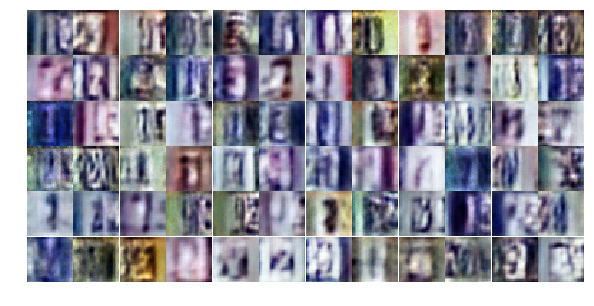

Epoch 5/25... Discriminator Loss: 0.4348... Generator Loss: 1.4353
Epoch 5/25... Discriminator Loss: 1.0142... Generator Loss: 3.2105
Epoch 5/25... Discriminator Loss: 0.5063... Generator Loss: 1.3856
Epoch 5/25... Discriminator Loss: 0.4822... Generator Loss: 1.8313
Epoch 5/25... Discriminator Loss: 0.9436... Generator Loss: 0.6259
Epoch 5/25... Discriminator Loss: 0.7820... Generator Loss: 0.8826
Epoch 5/25... Discriminator Loss: 0.6706... Generator Loss: 1.0076
Epoch 5/25... Discriminator Loss: 0.4153... Generator Loss: 2.0305
Epoch 5/25... Discriminator Loss: 1.1798... Generator Loss: 0.5745
Epoch 5/25... Discriminator Loss: 0.3760... Generator Loss: 1.7085


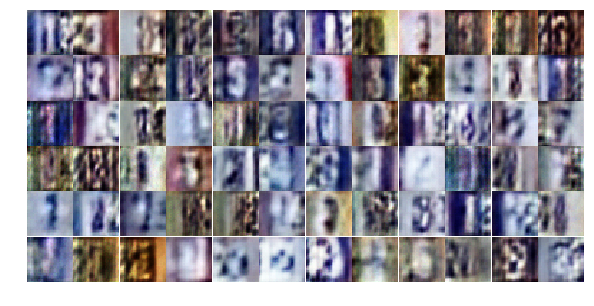

Epoch 5/25... Discriminator Loss: 0.5464... Generator Loss: 1.3729
Epoch 5/25... Discriminator Loss: 0.3657... Generator Loss: 1.7616
Epoch 5/25... Discriminator Loss: 0.5663... Generator Loss: 1.1678
Epoch 5/25... Discriminator Loss: 1.2207... Generator Loss: 0.6075
Epoch 5/25... Discriminator Loss: 0.7764... Generator Loss: 1.5363
Epoch 5/25... Discriminator Loss: 0.4989... Generator Loss: 2.7060
Epoch 5/25... Discriminator Loss: 0.8236... Generator Loss: 0.9086
Epoch 5/25... Discriminator Loss: 0.6744... Generator Loss: 0.9990
Epoch 5/25... Discriminator Loss: 0.7637... Generator Loss: 0.8737
Epoch 5/25... Discriminator Loss: 0.7333... Generator Loss: 0.8820


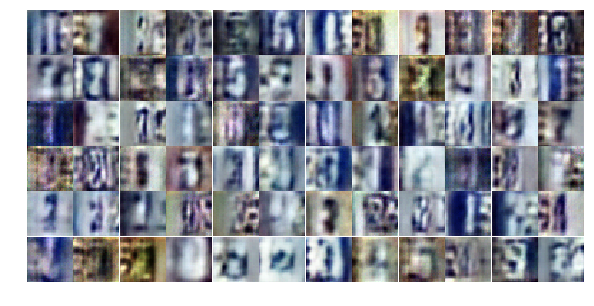

Epoch 5/25... Discriminator Loss: 0.3048... Generator Loss: 2.0144
Epoch 5/25... Discriminator Loss: 0.3875... Generator Loss: 1.5682
Epoch 5/25... Discriminator Loss: 0.4145... Generator Loss: 1.6347
Epoch 5/25... Discriminator Loss: 0.5954... Generator Loss: 1.0960
Epoch 5/25... Discriminator Loss: 1.5675... Generator Loss: 2.8934
Epoch 5/25... Discriminator Loss: 1.4340... Generator Loss: 0.4047
Epoch 5/25... Discriminator Loss: 0.5843... Generator Loss: 1.6942
Epoch 5/25... Discriminator Loss: 0.5064... Generator Loss: 1.3037
Epoch 5/25... Discriminator Loss: 0.6888... Generator Loss: 1.0074
Epoch 5/25... Discriminator Loss: 0.4423... Generator Loss: 1.5568


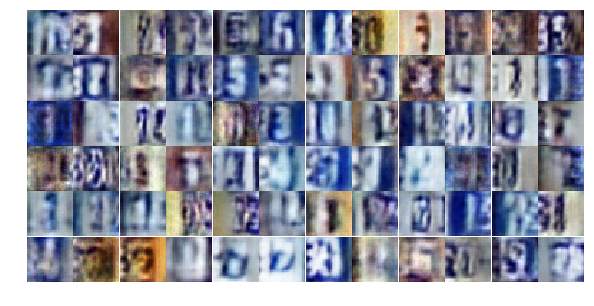

Epoch 5/25... Discriminator Loss: 0.8712... Generator Loss: 0.7785
Epoch 5/25... Discriminator Loss: 0.6037... Generator Loss: 1.1555
Epoch 5/25... Discriminator Loss: 1.5264... Generator Loss: 3.9991
Epoch 5/25... Discriminator Loss: 0.7325... Generator Loss: 0.8871
Epoch 5/25... Discriminator Loss: 0.4478... Generator Loss: 1.5899
Epoch 5/25... Discriminator Loss: 1.0054... Generator Loss: 0.6310
Epoch 6/25... Discriminator Loss: 0.7434... Generator Loss: 0.8687
Epoch 6/25... Discriminator Loss: 0.6808... Generator Loss: 0.9768
Epoch 6/25... Discriminator Loss: 0.6122... Generator Loss: 1.3886
Epoch 6/25... Discriminator Loss: 0.6790... Generator Loss: 1.1513


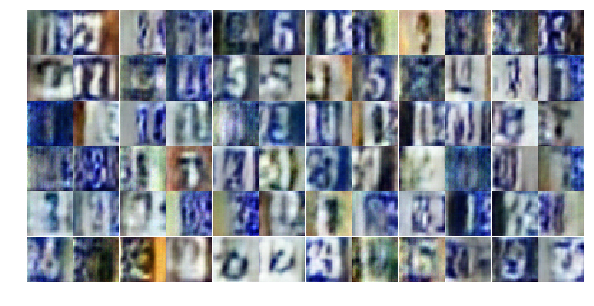

Epoch 6/25... Discriminator Loss: 0.5740... Generator Loss: 1.1759
Epoch 6/25... Discriminator Loss: 0.9315... Generator Loss: 0.6896
Epoch 6/25... Discriminator Loss: 1.1706... Generator Loss: 0.5783
Epoch 6/25... Discriminator Loss: 0.6808... Generator Loss: 1.4272
Epoch 6/25... Discriminator Loss: 1.5342... Generator Loss: 0.3223
Epoch 6/25... Discriminator Loss: 0.7642... Generator Loss: 0.8892
Epoch 6/25... Discriminator Loss: 0.4807... Generator Loss: 1.6453
Epoch 6/25... Discriminator Loss: 1.0365... Generator Loss: 0.6349
Epoch 6/25... Discriminator Loss: 0.6918... Generator Loss: 0.9266
Epoch 6/25... Discriminator Loss: 0.5177... Generator Loss: 2.0245


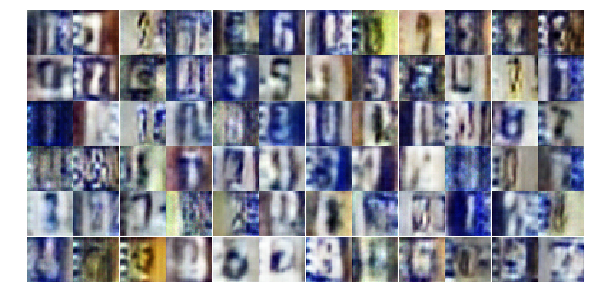

Epoch 6/25... Discriminator Loss: 0.6418... Generator Loss: 2.2354
Epoch 6/25... Discriminator Loss: 0.6262... Generator Loss: 2.1924
Epoch 6/25... Discriminator Loss: 1.4632... Generator Loss: 0.3394
Epoch 6/25... Discriminator Loss: 0.5720... Generator Loss: 1.2298
Epoch 6/25... Discriminator Loss: 0.4471... Generator Loss: 2.0979
Epoch 6/25... Discriminator Loss: 0.4617... Generator Loss: 1.6509
Epoch 6/25... Discriminator Loss: 0.6290... Generator Loss: 1.4476
Epoch 6/25... Discriminator Loss: 0.8250... Generator Loss: 0.8545
Epoch 6/25... Discriminator Loss: 0.5138... Generator Loss: 2.3465
Epoch 6/25... Discriminator Loss: 0.6453... Generator Loss: 1.6010


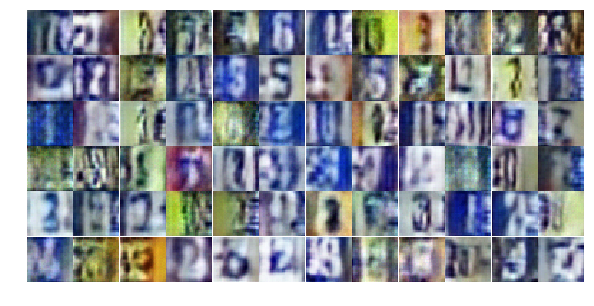

Epoch 6/25... Discriminator Loss: 0.5939... Generator Loss: 1.1052
Epoch 6/25... Discriminator Loss: 0.6490... Generator Loss: 1.2384
Epoch 6/25... Discriminator Loss: 1.1133... Generator Loss: 0.5588
Epoch 6/25... Discriminator Loss: 0.9120... Generator Loss: 0.7425
Epoch 6/25... Discriminator Loss: 0.4874... Generator Loss: 1.6428
Epoch 6/25... Discriminator Loss: 1.0601... Generator Loss: 0.5981
Epoch 6/25... Discriminator Loss: 0.4736... Generator Loss: 1.5031
Epoch 6/25... Discriminator Loss: 0.4601... Generator Loss: 1.4723
Epoch 6/25... Discriminator Loss: 0.7335... Generator Loss: 0.8784
Epoch 6/25... Discriminator Loss: 0.4267... Generator Loss: 1.6907


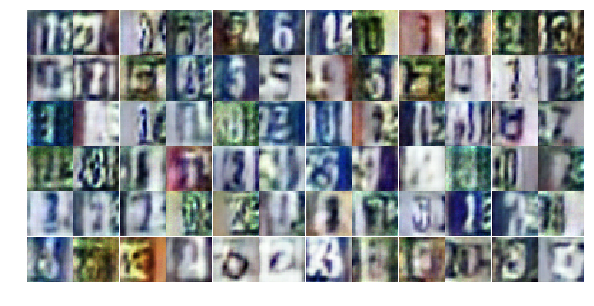

Epoch 6/25... Discriminator Loss: 0.6151... Generator Loss: 1.8283
Epoch 6/25... Discriminator Loss: 0.9439... Generator Loss: 1.5866
Epoch 6/25... Discriminator Loss: 1.4528... Generator Loss: 0.5220
Epoch 6/25... Discriminator Loss: 0.5410... Generator Loss: 1.6723
Epoch 6/25... Discriminator Loss: 0.8376... Generator Loss: 0.8540
Epoch 6/25... Discriminator Loss: 0.7105... Generator Loss: 1.0364
Epoch 6/25... Discriminator Loss: 0.5059... Generator Loss: 1.2899
Epoch 6/25... Discriminator Loss: 0.5030... Generator Loss: 1.2576
Epoch 6/25... Discriminator Loss: 0.6673... Generator Loss: 1.8504
Epoch 6/25... Discriminator Loss: 0.7129... Generator Loss: 0.8847


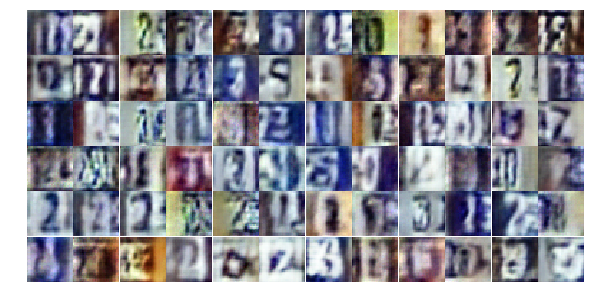

Epoch 6/25... Discriminator Loss: 0.7284... Generator Loss: 2.3982
Epoch 6/25... Discriminator Loss: 0.5641... Generator Loss: 1.4931
Epoch 6/25... Discriminator Loss: 1.0072... Generator Loss: 0.5997
Epoch 6/25... Discriminator Loss: 0.5638... Generator Loss: 1.3868
Epoch 6/25... Discriminator Loss: 0.7510... Generator Loss: 2.0828
Epoch 6/25... Discriminator Loss: 0.5431... Generator Loss: 1.3578
Epoch 6/25... Discriminator Loss: 0.9060... Generator Loss: 0.6714
Epoch 6/25... Discriminator Loss: 1.1391... Generator Loss: 0.6118
Epoch 6/25... Discriminator Loss: 0.9753... Generator Loss: 0.6628
Epoch 6/25... Discriminator Loss: 1.1172... Generator Loss: 0.5665


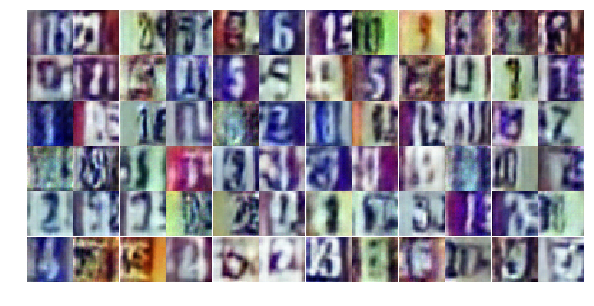

Epoch 6/25... Discriminator Loss: 0.4683... Generator Loss: 1.5437
Epoch 6/25... Discriminator Loss: 0.5366... Generator Loss: 1.2152
Epoch 6/25... Discriminator Loss: 0.6450... Generator Loss: 1.3611
Epoch 7/25... Discriminator Loss: 0.4633... Generator Loss: 1.7512
Epoch 7/25... Discriminator Loss: 0.7020... Generator Loss: 1.2599
Epoch 7/25... Discriminator Loss: 0.5824... Generator Loss: 1.2352
Epoch 7/25... Discriminator Loss: 0.4944... Generator Loss: 1.3730
Epoch 7/25... Discriminator Loss: 0.4575... Generator Loss: 1.4114
Epoch 7/25... Discriminator Loss: 0.3770... Generator Loss: 1.8134
Epoch 7/25... Discriminator Loss: 1.6702... Generator Loss: 0.2954


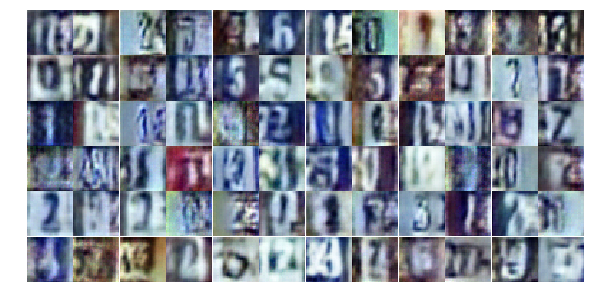

Epoch 7/25... Discriminator Loss: 1.2564... Generator Loss: 0.4687
Epoch 7/25... Discriminator Loss: 0.6676... Generator Loss: 2.2408
Epoch 7/25... Discriminator Loss: 0.8993... Generator Loss: 0.9851
Epoch 7/25... Discriminator Loss: 0.6366... Generator Loss: 1.4783
Epoch 7/25... Discriminator Loss: 0.5754... Generator Loss: 1.2146
Epoch 7/25... Discriminator Loss: 0.6903... Generator Loss: 0.9823
Epoch 7/25... Discriminator Loss: 0.6758... Generator Loss: 2.2554
Epoch 7/25... Discriminator Loss: 0.5939... Generator Loss: 1.6892
Epoch 7/25... Discriminator Loss: 0.5305... Generator Loss: 2.0700
Epoch 7/25... Discriminator Loss: 0.6889... Generator Loss: 1.0647


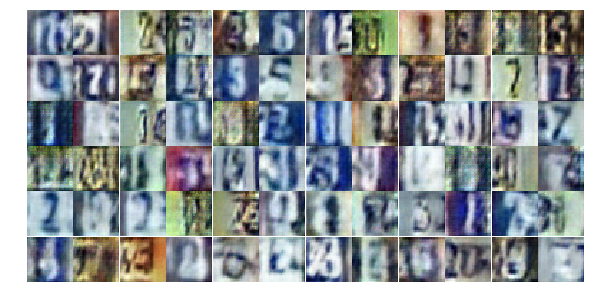

Epoch 7/25... Discriminator Loss: 1.3296... Generator Loss: 0.4077
Epoch 7/25... Discriminator Loss: 0.5320... Generator Loss: 1.6554
Epoch 7/25... Discriminator Loss: 0.9648... Generator Loss: 0.6503
Epoch 7/25... Discriminator Loss: 0.5693... Generator Loss: 1.4899
Epoch 7/25... Discriminator Loss: 0.4546... Generator Loss: 1.3492
Epoch 7/25... Discriminator Loss: 0.4886... Generator Loss: 1.3834
Epoch 7/25... Discriminator Loss: 0.5391... Generator Loss: 1.2151
Epoch 7/25... Discriminator Loss: 1.0973... Generator Loss: 0.5842
Epoch 7/25... Discriminator Loss: 0.4486... Generator Loss: 1.6170
Epoch 7/25... Discriminator Loss: 0.5920... Generator Loss: 2.0034


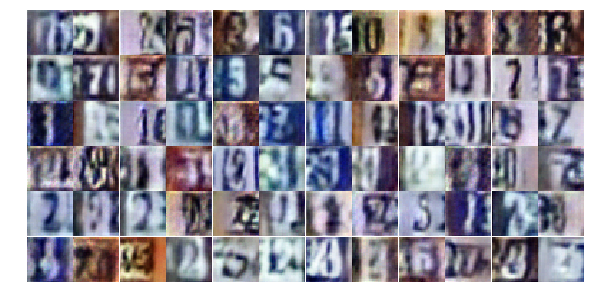

Epoch 7/25... Discriminator Loss: 0.7813... Generator Loss: 0.8642
Epoch 7/25... Discriminator Loss: 1.3853... Generator Loss: 0.4407
Epoch 7/25... Discriminator Loss: 0.4050... Generator Loss: 1.6042
Epoch 7/25... Discriminator Loss: 0.8276... Generator Loss: 0.7617
Epoch 7/25... Discriminator Loss: 0.5598... Generator Loss: 1.4300
Epoch 7/25... Discriminator Loss: 0.8031... Generator Loss: 1.0165
Epoch 7/25... Discriminator Loss: 0.6166... Generator Loss: 1.1532
Epoch 7/25... Discriminator Loss: 0.7216... Generator Loss: 0.9755
Epoch 7/25... Discriminator Loss: 0.9621... Generator Loss: 0.6996
Epoch 7/25... Discriminator Loss: 0.5423... Generator Loss: 2.6962


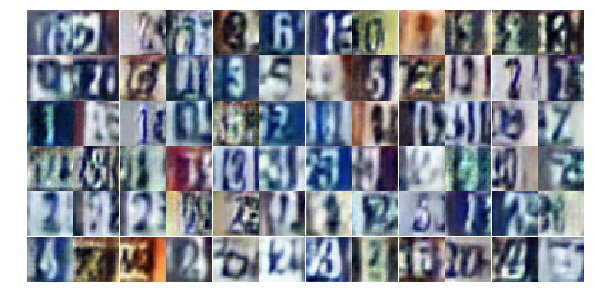

Epoch 7/25... Discriminator Loss: 0.7633... Generator Loss: 1.2566
Epoch 7/25... Discriminator Loss: 0.7060... Generator Loss: 1.4409
Epoch 7/25... Discriminator Loss: 0.4109... Generator Loss: 1.6597
Epoch 7/25... Discriminator Loss: 0.5967... Generator Loss: 2.1531
Epoch 7/25... Discriminator Loss: 1.1882... Generator Loss: 0.4926
Epoch 7/25... Discriminator Loss: 0.4406... Generator Loss: 2.2337
Epoch 7/25... Discriminator Loss: 0.5556... Generator Loss: 1.2671
Epoch 7/25... Discriminator Loss: 1.7281... Generator Loss: 2.8139
Epoch 7/25... Discriminator Loss: 0.5548... Generator Loss: 4.1406
Epoch 7/25... Discriminator Loss: 0.5894... Generator Loss: 1.8354


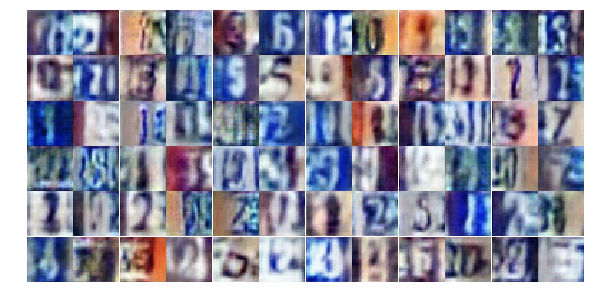

Epoch 7/25... Discriminator Loss: 0.2640... Generator Loss: 2.3038
Epoch 7/25... Discriminator Loss: 0.7664... Generator Loss: 0.8584
Epoch 7/25... Discriminator Loss: 0.5917... Generator Loss: 1.3142
Epoch 7/25... Discriminator Loss: 0.9154... Generator Loss: 0.7260
Epoch 7/25... Discriminator Loss: 0.5030... Generator Loss: 1.2367
Epoch 7/25... Discriminator Loss: 1.0389... Generator Loss: 0.7116
Epoch 7/25... Discriminator Loss: 1.0640... Generator Loss: 0.5875
Epoch 7/25... Discriminator Loss: 0.5963... Generator Loss: 1.1722
Epoch 7/25... Discriminator Loss: 0.7430... Generator Loss: 1.0697
Epoch 7/25... Discriminator Loss: 0.4971... Generator Loss: 1.2137


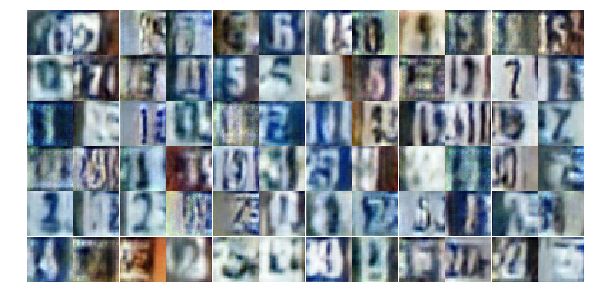

Epoch 7/25... Discriminator Loss: 0.6223... Generator Loss: 2.2342
Epoch 8/25... Discriminator Loss: 0.5803... Generator Loss: 1.1435
Epoch 8/25... Discriminator Loss: 1.0559... Generator Loss: 0.5600
Epoch 8/25... Discriminator Loss: 0.6964... Generator Loss: 0.9789
Epoch 8/25... Discriminator Loss: 0.7403... Generator Loss: 0.8670
Epoch 8/25... Discriminator Loss: 1.0336... Generator Loss: 0.5848
Epoch 8/25... Discriminator Loss: 1.2581... Generator Loss: 0.5465
Epoch 8/25... Discriminator Loss: 0.3995... Generator Loss: 1.7621
Epoch 8/25... Discriminator Loss: 0.8503... Generator Loss: 0.8120
Epoch 8/25... Discriminator Loss: 0.9457... Generator Loss: 0.6642


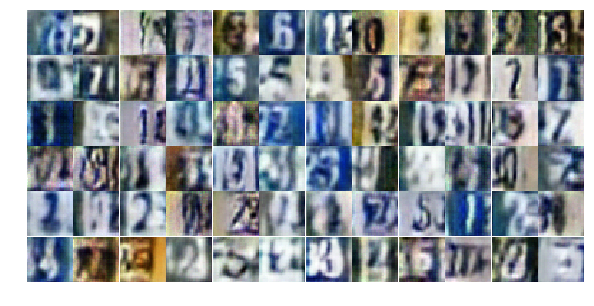

Epoch 8/25... Discriminator Loss: 0.4965... Generator Loss: 1.5247
Epoch 8/25... Discriminator Loss: 0.3810... Generator Loss: 1.5327
Epoch 8/25... Discriminator Loss: 1.1282... Generator Loss: 0.5729
Epoch 8/25... Discriminator Loss: 0.5371... Generator Loss: 1.4411
Epoch 8/25... Discriminator Loss: 0.7300... Generator Loss: 0.9549
Epoch 8/25... Discriminator Loss: 1.4143... Generator Loss: 3.6116
Epoch 8/25... Discriminator Loss: 0.7175... Generator Loss: 1.1461
Epoch 8/25... Discriminator Loss: 1.3147... Generator Loss: 0.5023
Epoch 8/25... Discriminator Loss: 0.7675... Generator Loss: 0.9888
Epoch 8/25... Discriminator Loss: 1.6505... Generator Loss: 0.3136


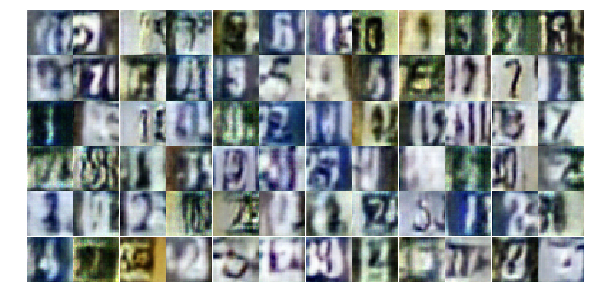

Epoch 8/25... Discriminator Loss: 0.4742... Generator Loss: 1.5733
Epoch 8/25... Discriminator Loss: 0.5556... Generator Loss: 1.3904
Epoch 8/25... Discriminator Loss: 0.8811... Generator Loss: 0.7759
Epoch 8/25... Discriminator Loss: 0.6201... Generator Loss: 1.3329
Epoch 8/25... Discriminator Loss: 0.4436... Generator Loss: 1.6979
Epoch 8/25... Discriminator Loss: 0.4432... Generator Loss: 1.6132
Epoch 8/25... Discriminator Loss: 0.5769... Generator Loss: 1.2973
Epoch 8/25... Discriminator Loss: 0.4752... Generator Loss: 1.5490
Epoch 8/25... Discriminator Loss: 0.6985... Generator Loss: 1.4783
Epoch 8/25... Discriminator Loss: 0.4964... Generator Loss: 1.3920


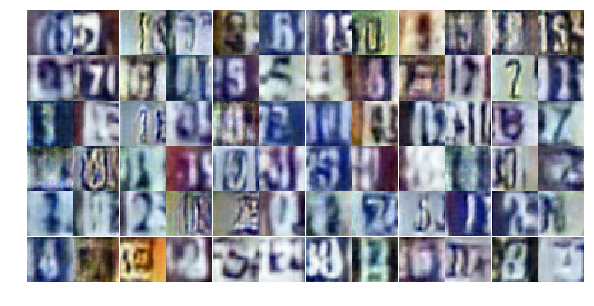

Epoch 8/25... Discriminator Loss: 0.5866... Generator Loss: 1.2176
Epoch 8/25... Discriminator Loss: 0.7607... Generator Loss: 0.9324
Epoch 8/25... Discriminator Loss: 0.6022... Generator Loss: 1.3792
Epoch 8/25... Discriminator Loss: 1.1608... Generator Loss: 0.4848
Epoch 8/25... Discriminator Loss: 0.8471... Generator Loss: 0.7496
Epoch 8/25... Discriminator Loss: 0.2272... Generator Loss: 2.3646
Epoch 8/25... Discriminator Loss: 0.6583... Generator Loss: 2.8315
Epoch 8/25... Discriminator Loss: 1.0228... Generator Loss: 0.7509
Epoch 8/25... Discriminator Loss: 0.7913... Generator Loss: 1.7035
Epoch 8/25... Discriminator Loss: 0.7093... Generator Loss: 0.9611


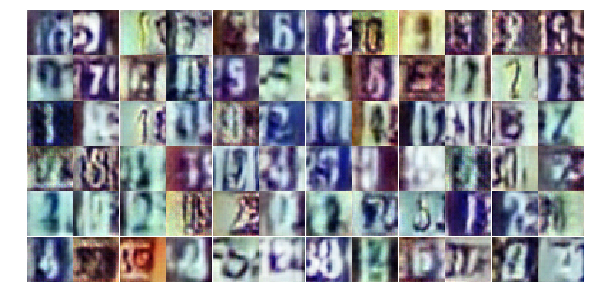

Epoch 8/25... Discriminator Loss: 0.4916... Generator Loss: 1.5279
Epoch 8/25... Discriminator Loss: 0.7941... Generator Loss: 0.9256
Epoch 8/25... Discriminator Loss: 0.5250... Generator Loss: 1.2018
Epoch 8/25... Discriminator Loss: 0.6836... Generator Loss: 1.0676
Epoch 8/25... Discriminator Loss: 0.6162... Generator Loss: 1.2812
Epoch 8/25... Discriminator Loss: 0.5501... Generator Loss: 1.3499
Epoch 8/25... Discriminator Loss: 0.4799... Generator Loss: 1.3926
Epoch 8/25... Discriminator Loss: 0.3674... Generator Loss: 2.7768
Epoch 8/25... Discriminator Loss: 0.8055... Generator Loss: 0.9819
Epoch 8/25... Discriminator Loss: 0.5497... Generator Loss: 1.6772


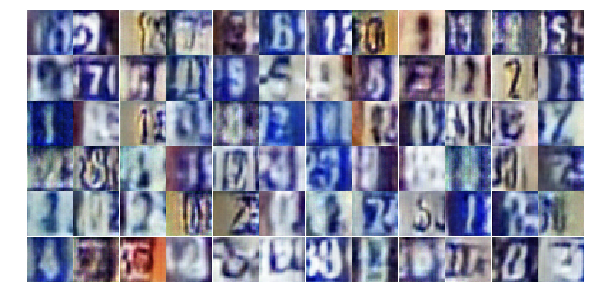

Epoch 8/25... Discriminator Loss: 0.6731... Generator Loss: 1.0247
Epoch 8/25... Discriminator Loss: 0.6015... Generator Loss: 1.1738
Epoch 8/25... Discriminator Loss: 0.4736... Generator Loss: 1.8934
Epoch 8/25... Discriminator Loss: 0.6896... Generator Loss: 0.9969
Epoch 8/25... Discriminator Loss: 0.3527... Generator Loss: 2.6891
Epoch 8/25... Discriminator Loss: 1.0705... Generator Loss: 0.6120
Epoch 8/25... Discriminator Loss: 0.6183... Generator Loss: 1.0221
Epoch 8/25... Discriminator Loss: 0.4448... Generator Loss: 2.2981
Epoch 9/25... Discriminator Loss: 0.9116... Generator Loss: 0.7455
Epoch 9/25... Discriminator Loss: 0.8522... Generator Loss: 0.7280


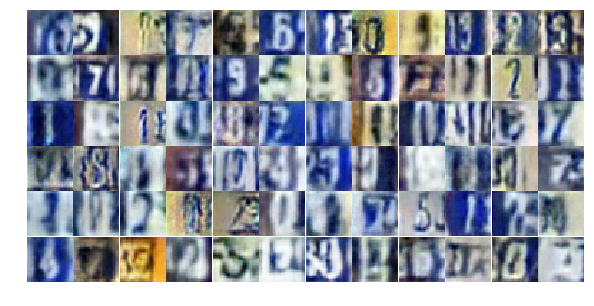

Epoch 9/25... Discriminator Loss: 0.9891... Generator Loss: 0.6241
Epoch 9/25... Discriminator Loss: 0.6802... Generator Loss: 1.0193
Epoch 9/25... Discriminator Loss: 1.1885... Generator Loss: 0.4830
Epoch 9/25... Discriminator Loss: 1.1122... Generator Loss: 0.6107
Epoch 9/25... Discriminator Loss: 1.2651... Generator Loss: 0.4908
Epoch 9/25... Discriminator Loss: 0.6973... Generator Loss: 1.5065
Epoch 9/25... Discriminator Loss: 0.7395... Generator Loss: 1.0637
Epoch 9/25... Discriminator Loss: 0.4873... Generator Loss: 1.7349
Epoch 9/25... Discriminator Loss: 0.6765... Generator Loss: 1.0424
Epoch 9/25... Discriminator Loss: 0.5700... Generator Loss: 1.2538


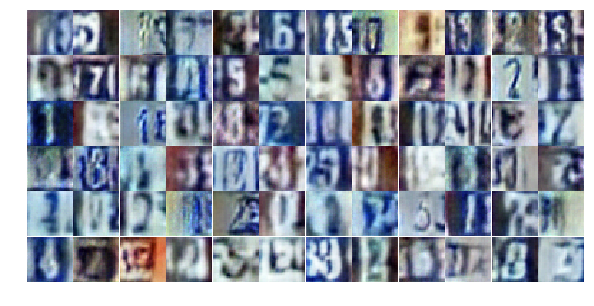

Epoch 9/25... Discriminator Loss: 0.6632... Generator Loss: 0.9870
Epoch 9/25... Discriminator Loss: 0.7831... Generator Loss: 1.0569
Epoch 9/25... Discriminator Loss: 0.7910... Generator Loss: 1.0004
Epoch 9/25... Discriminator Loss: 1.3317... Generator Loss: 0.4245
Epoch 9/25... Discriminator Loss: 0.4864... Generator Loss: 1.3474
Epoch 9/25... Discriminator Loss: 0.7256... Generator Loss: 0.9495
Epoch 9/25... Discriminator Loss: 1.2070... Generator Loss: 0.5853
Epoch 9/25... Discriminator Loss: 0.6301... Generator Loss: 1.4436
Epoch 9/25... Discriminator Loss: 1.1528... Generator Loss: 0.4819
Epoch 9/25... Discriminator Loss: 0.8330... Generator Loss: 0.8546


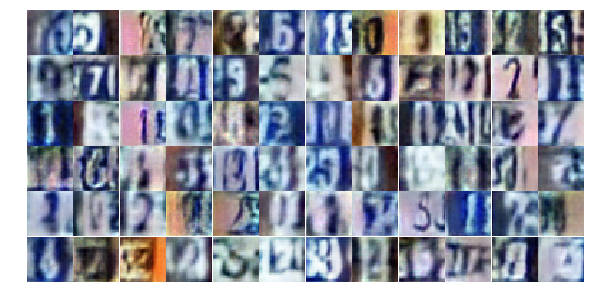

Epoch 9/25... Discriminator Loss: 0.8438... Generator Loss: 0.8528
Epoch 9/25... Discriminator Loss: 0.4334... Generator Loss: 1.4785
Epoch 9/25... Discriminator Loss: 0.6080... Generator Loss: 1.3776
Epoch 9/25... Discriminator Loss: 0.8732... Generator Loss: 0.8308
Epoch 9/25... Discriminator Loss: 0.5038... Generator Loss: 1.7253
Epoch 9/25... Discriminator Loss: 0.5109... Generator Loss: 1.3513
Epoch 9/25... Discriminator Loss: 1.1128... Generator Loss: 0.5634
Epoch 9/25... Discriminator Loss: 0.3977... Generator Loss: 1.6030
Epoch 9/25... Discriminator Loss: 0.5105... Generator Loss: 1.2201
Epoch 9/25... Discriminator Loss: 0.4810... Generator Loss: 1.3679


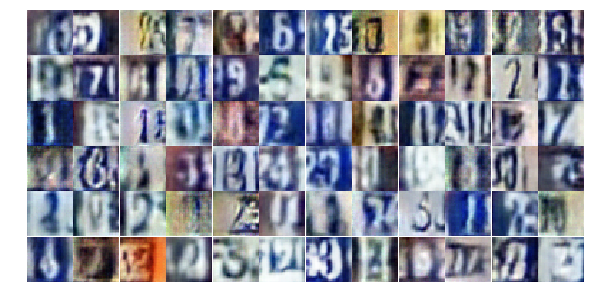

Epoch 9/25... Discriminator Loss: 0.6433... Generator Loss: 1.0748
Epoch 9/25... Discriminator Loss: 0.3947... Generator Loss: 1.6081
Epoch 9/25... Discriminator Loss: 0.5328... Generator Loss: 1.6303
Epoch 9/25... Discriminator Loss: 0.5576... Generator Loss: 1.1776
Epoch 9/25... Discriminator Loss: 0.7176... Generator Loss: 1.1519
Epoch 9/25... Discriminator Loss: 0.5912... Generator Loss: 1.4486
Epoch 9/25... Discriminator Loss: 0.8039... Generator Loss: 0.9557
Epoch 9/25... Discriminator Loss: 0.4130... Generator Loss: 1.6346
Epoch 9/25... Discriminator Loss: 0.6633... Generator Loss: 1.0819
Epoch 9/25... Discriminator Loss: 0.5617... Generator Loss: 1.1316


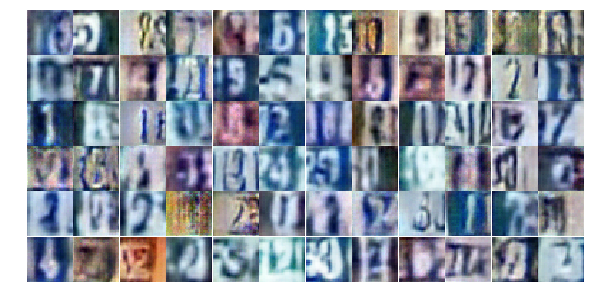

Epoch 9/25... Discriminator Loss: 0.5560... Generator Loss: 1.4216
Epoch 9/25... Discriminator Loss: 0.4651... Generator Loss: 1.3820
Epoch 9/25... Discriminator Loss: 0.5834... Generator Loss: 1.3953
Epoch 9/25... Discriminator Loss: 0.6123... Generator Loss: 1.5050
Epoch 9/25... Discriminator Loss: 0.3370... Generator Loss: 1.7546
Epoch 9/25... Discriminator Loss: 0.6025... Generator Loss: 1.1227
Epoch 9/25... Discriminator Loss: 0.6087... Generator Loss: 1.8954
Epoch 9/25... Discriminator Loss: 1.1275... Generator Loss: 0.5136
Epoch 9/25... Discriminator Loss: 0.4686... Generator Loss: 1.7832
Epoch 9/25... Discriminator Loss: 0.9187... Generator Loss: 3.0888


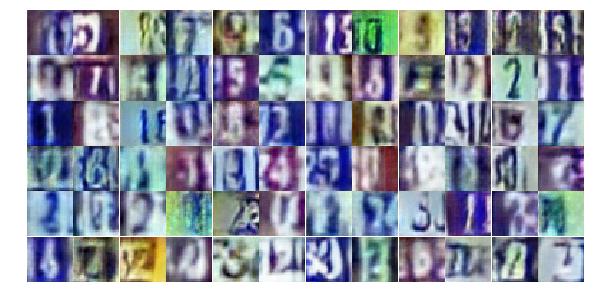

Epoch 9/25... Discriminator Loss: 1.2153... Generator Loss: 0.7246
Epoch 9/25... Discriminator Loss: 0.7466... Generator Loss: 1.5669
Epoch 9/25... Discriminator Loss: 0.6152... Generator Loss: 1.2348
Epoch 9/25... Discriminator Loss: 1.2107... Generator Loss: 0.4940
Epoch 9/25... Discriminator Loss: 0.5656... Generator Loss: 1.2923
Epoch 10/25... Discriminator Loss: 0.4888... Generator Loss: 1.2856
Epoch 10/25... Discriminator Loss: 0.5911... Generator Loss: 1.3537
Epoch 10/25... Discriminator Loss: 0.6972... Generator Loss: 0.9399
Epoch 10/25... Discriminator Loss: 0.8316... Generator Loss: 0.7934
Epoch 10/25... Discriminator Loss: 1.4887... Generator Loss: 0.3363


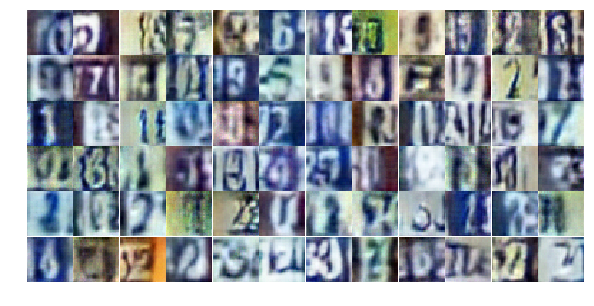

Epoch 10/25... Discriminator Loss: 0.7984... Generator Loss: 0.9083
Epoch 10/25... Discriminator Loss: 0.6061... Generator Loss: 1.2535
Epoch 10/25... Discriminator Loss: 0.5269... Generator Loss: 1.3311
Epoch 10/25... Discriminator Loss: 0.6924... Generator Loss: 2.5792
Epoch 10/25... Discriminator Loss: 0.5543... Generator Loss: 1.3978
Epoch 10/25... Discriminator Loss: 0.6320... Generator Loss: 1.8895
Epoch 10/25... Discriminator Loss: 0.7494... Generator Loss: 0.8407
Epoch 10/25... Discriminator Loss: 1.2124... Generator Loss: 0.5205
Epoch 10/25... Discriminator Loss: 1.0742... Generator Loss: 0.7021
Epoch 10/25... Discriminator Loss: 0.9624... Generator Loss: 0.7377


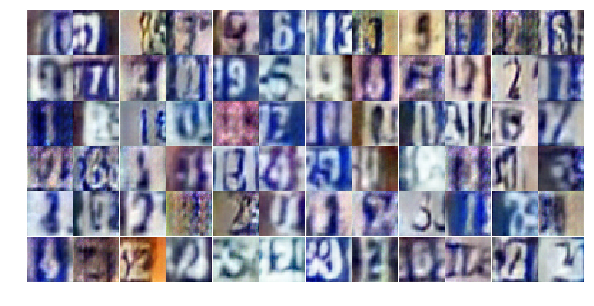

Epoch 10/25... Discriminator Loss: 0.6864... Generator Loss: 1.4006
Epoch 10/25... Discriminator Loss: 1.3815... Generator Loss: 0.4065
Epoch 10/25... Discriminator Loss: 0.7022... Generator Loss: 0.9410
Epoch 10/25... Discriminator Loss: 1.3550... Generator Loss: 0.4100
Epoch 10/25... Discriminator Loss: 0.6702... Generator Loss: 2.1358
Epoch 10/25... Discriminator Loss: 0.6878... Generator Loss: 1.0678
Epoch 10/25... Discriminator Loss: 0.8833... Generator Loss: 0.7285
Epoch 10/25... Discriminator Loss: 0.4549... Generator Loss: 1.3861
Epoch 10/25... Discriminator Loss: 0.6367... Generator Loss: 1.1523
Epoch 10/25... Discriminator Loss: 0.2961... Generator Loss: 2.0803


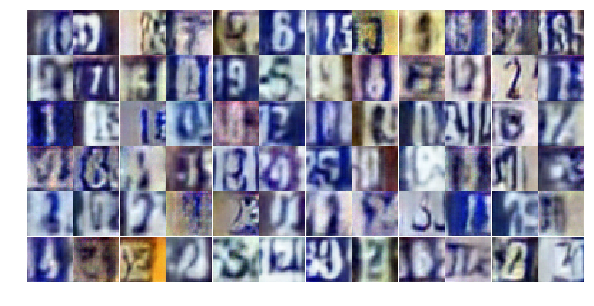

Epoch 10/25... Discriminator Loss: 0.6156... Generator Loss: 1.0359
Epoch 10/25... Discriminator Loss: 1.1886... Generator Loss: 0.5344
Epoch 10/25... Discriminator Loss: 0.4198... Generator Loss: 1.6645
Epoch 10/25... Discriminator Loss: 1.1783... Generator Loss: 2.8979
Epoch 10/25... Discriminator Loss: 1.0932... Generator Loss: 0.5741
Epoch 10/25... Discriminator Loss: 0.6112... Generator Loss: 1.4893
Epoch 10/25... Discriminator Loss: 0.3144... Generator Loss: 1.9972
Epoch 10/25... Discriminator Loss: 0.7755... Generator Loss: 1.3665
Epoch 10/25... Discriminator Loss: 0.6792... Generator Loss: 0.9576
Epoch 10/25... Discriminator Loss: 0.7173... Generator Loss: 0.8764


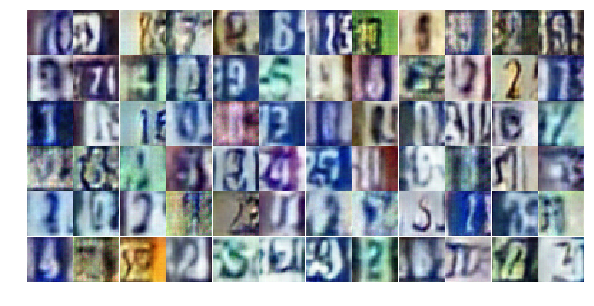

Epoch 10/25... Discriminator Loss: 0.8681... Generator Loss: 2.3095
Epoch 10/25... Discriminator Loss: 0.5467... Generator Loss: 1.4930
Epoch 10/25... Discriminator Loss: 0.6308... Generator Loss: 1.5953
Epoch 10/25... Discriminator Loss: 0.5178... Generator Loss: 1.7624
Epoch 10/25... Discriminator Loss: 1.0133... Generator Loss: 0.6550
Epoch 10/25... Discriminator Loss: 0.9166... Generator Loss: 0.7879
Epoch 10/25... Discriminator Loss: 0.7024... Generator Loss: 0.9497
Epoch 10/25... Discriminator Loss: 1.1855... Generator Loss: 0.5215
Epoch 10/25... Discriminator Loss: 0.5565... Generator Loss: 1.1794
Epoch 10/25... Discriminator Loss: 1.4036... Generator Loss: 0.4806


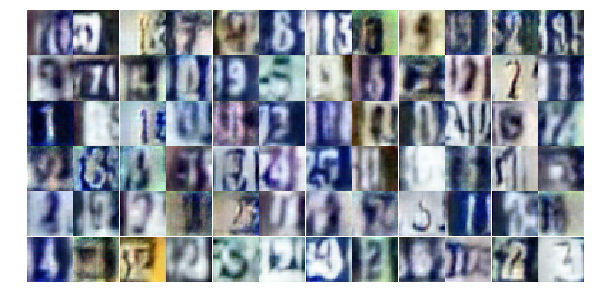

Epoch 10/25... Discriminator Loss: 0.5344... Generator Loss: 1.3070
Epoch 10/25... Discriminator Loss: 0.8456... Generator Loss: 0.8110
Epoch 10/25... Discriminator Loss: 0.6187... Generator Loss: 1.2268
Epoch 10/25... Discriminator Loss: 0.6441... Generator Loss: 1.3485
Epoch 10/25... Discriminator Loss: 1.0468... Generator Loss: 0.6710
Epoch 10/25... Discriminator Loss: 0.9068... Generator Loss: 2.1553
Epoch 10/25... Discriminator Loss: 0.7144... Generator Loss: 1.0282
Epoch 10/25... Discriminator Loss: 0.4941... Generator Loss: 1.5067
Epoch 10/25... Discriminator Loss: 0.8225... Generator Loss: 2.7432
Epoch 10/25... Discriminator Loss: 0.6462... Generator Loss: 1.2740


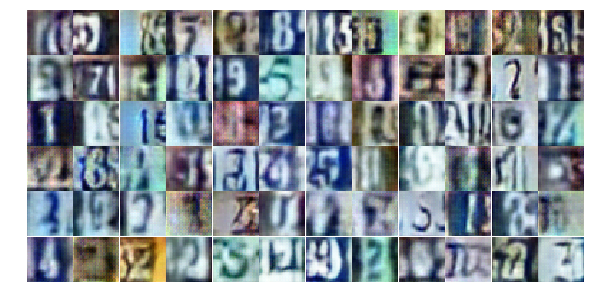

Epoch 10/25... Discriminator Loss: 0.6760... Generator Loss: 2.1654
Epoch 10/25... Discriminator Loss: 0.6113... Generator Loss: 1.1128
Epoch 10/25... Discriminator Loss: 0.5103... Generator Loss: 1.2541
Epoch 11/25... Discriminator Loss: 0.8988... Generator Loss: 0.7628
Epoch 11/25... Discriminator Loss: 0.6205... Generator Loss: 1.1072
Epoch 11/25... Discriminator Loss: 1.0166... Generator Loss: 0.6641
Epoch 11/25... Discriminator Loss: 0.5438... Generator Loss: 1.3825
Epoch 11/25... Discriminator Loss: 0.8071... Generator Loss: 1.8150
Epoch 11/25... Discriminator Loss: 1.5805... Generator Loss: 0.3808
Epoch 11/25... Discriminator Loss: 1.2714... Generator Loss: 1.4213


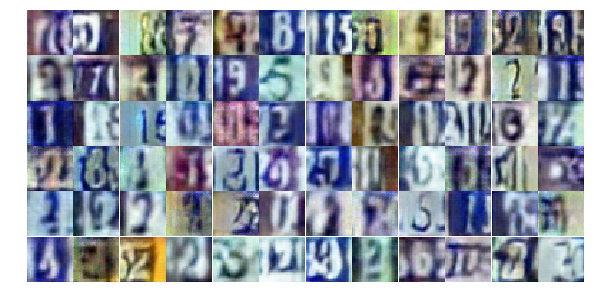

Epoch 11/25... Discriminator Loss: 0.4580... Generator Loss: 1.7263
Epoch 11/25... Discriminator Loss: 0.7399... Generator Loss: 1.1091
Epoch 11/25... Discriminator Loss: 0.4959... Generator Loss: 1.4390
Epoch 11/25... Discriminator Loss: 0.7453... Generator Loss: 0.9368
Epoch 11/25... Discriminator Loss: 0.9565... Generator Loss: 0.7459
Epoch 11/25... Discriminator Loss: 0.4005... Generator Loss: 1.8585
Epoch 11/25... Discriminator Loss: 0.7470... Generator Loss: 0.9263
Epoch 11/25... Discriminator Loss: 0.3957... Generator Loss: 1.4990
Epoch 11/25... Discriminator Loss: 0.5830... Generator Loss: 1.1303
Epoch 11/25... Discriminator Loss: 1.1617... Generator Loss: 0.5554


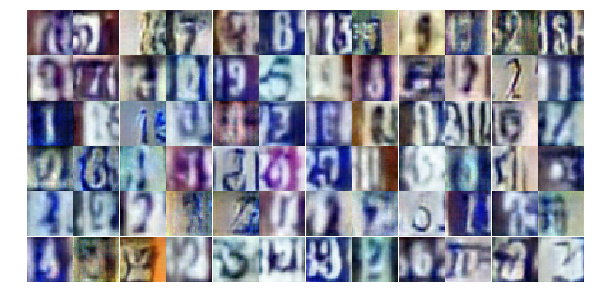

Epoch 11/25... Discriminator Loss: 0.6941... Generator Loss: 0.9547
Epoch 11/25... Discriminator Loss: 0.4655... Generator Loss: 2.0831
Epoch 11/25... Discriminator Loss: 0.8691... Generator Loss: 0.7912
Epoch 11/25... Discriminator Loss: 0.5701... Generator Loss: 1.4007
Epoch 11/25... Discriminator Loss: 0.3932... Generator Loss: 2.0955
Epoch 11/25... Discriminator Loss: 0.3942... Generator Loss: 1.7711
Epoch 11/25... Discriminator Loss: 0.5653... Generator Loss: 1.2142
Epoch 11/25... Discriminator Loss: 0.9335... Generator Loss: 0.7818
Epoch 11/25... Discriminator Loss: 0.4634... Generator Loss: 1.4353
Epoch 11/25... Discriminator Loss: 0.7500... Generator Loss: 0.8704


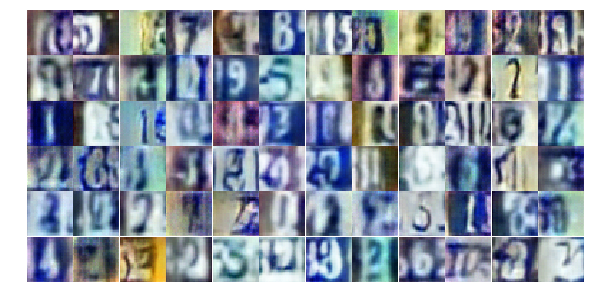

Epoch 11/25... Discriminator Loss: 0.6270... Generator Loss: 1.0952
Epoch 11/25... Discriminator Loss: 0.6382... Generator Loss: 1.2481
Epoch 11/25... Discriminator Loss: 0.7174... Generator Loss: 1.1906
Epoch 11/25... Discriminator Loss: 0.4733... Generator Loss: 1.4860
Epoch 11/25... Discriminator Loss: 0.7214... Generator Loss: 0.8983
Epoch 11/25... Discriminator Loss: 0.9141... Generator Loss: 0.8378
Epoch 11/25... Discriminator Loss: 1.7246... Generator Loss: 0.2936
Epoch 11/25... Discriminator Loss: 2.7862... Generator Loss: 0.1203
Epoch 11/25... Discriminator Loss: 0.7042... Generator Loss: 1.3797
Epoch 11/25... Discriminator Loss: 0.8903... Generator Loss: 0.7813


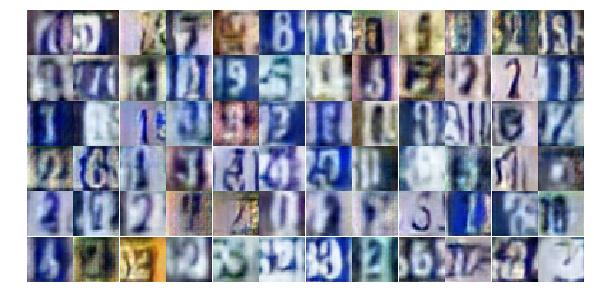

Epoch 11/25... Discriminator Loss: 0.6445... Generator Loss: 1.0777
Epoch 11/25... Discriminator Loss: 0.5017... Generator Loss: 1.6597
Epoch 11/25... Discriminator Loss: 1.0286... Generator Loss: 0.7259
Epoch 11/25... Discriminator Loss: 0.9229... Generator Loss: 0.7046
Epoch 11/25... Discriminator Loss: 0.7379... Generator Loss: 0.9442
Epoch 11/25... Discriminator Loss: 0.6340... Generator Loss: 1.3728
Epoch 11/25... Discriminator Loss: 0.3429... Generator Loss: 2.0194
Epoch 11/25... Discriminator Loss: 0.6110... Generator Loss: 1.1861
Epoch 11/25... Discriminator Loss: 1.3267... Generator Loss: 0.4723
Epoch 11/25... Discriminator Loss: 0.5056... Generator Loss: 1.2971


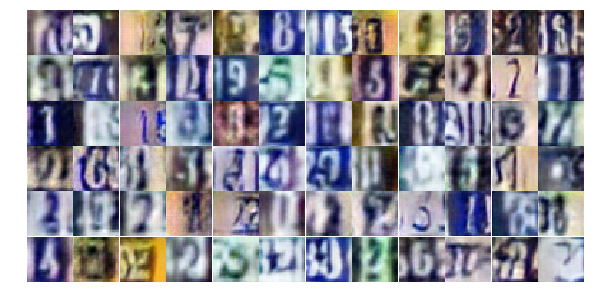

Epoch 11/25... Discriminator Loss: 0.6722... Generator Loss: 1.1227
Epoch 11/25... Discriminator Loss: 0.3640... Generator Loss: 1.9146
Epoch 11/25... Discriminator Loss: 0.6758... Generator Loss: 1.1495
Epoch 11/25... Discriminator Loss: 0.6008... Generator Loss: 1.0809
Epoch 11/25... Discriminator Loss: 1.1086... Generator Loss: 0.6194
Epoch 11/25... Discriminator Loss: 1.3954... Generator Loss: 0.3941
Epoch 11/25... Discriminator Loss: 0.7814... Generator Loss: 0.9696
Epoch 11/25... Discriminator Loss: 0.4361... Generator Loss: 1.8885
Epoch 11/25... Discriminator Loss: 0.7372... Generator Loss: 1.4088
Epoch 11/25... Discriminator Loss: 0.9955... Generator Loss: 0.7668


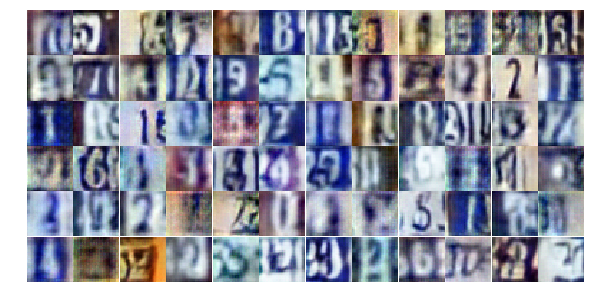

Epoch 12/25... Discriminator Loss: 0.6018... Generator Loss: 1.3720
Epoch 12/25... Discriminator Loss: 0.7186... Generator Loss: 0.9531
Epoch 12/25... Discriminator Loss: 0.7354... Generator Loss: 1.0189
Epoch 12/25... Discriminator Loss: 0.5931... Generator Loss: 1.2182
Epoch 12/25... Discriminator Loss: 0.5235... Generator Loss: 1.1668
Epoch 12/25... Discriminator Loss: 0.9520... Generator Loss: 0.7174
Epoch 12/25... Discriminator Loss: 0.5054... Generator Loss: 1.6608
Epoch 12/25... Discriminator Loss: 0.6564... Generator Loss: 1.3771
Epoch 12/25... Discriminator Loss: 0.6508... Generator Loss: 1.2396
Epoch 12/25... Discriminator Loss: 0.9642... Generator Loss: 0.7281


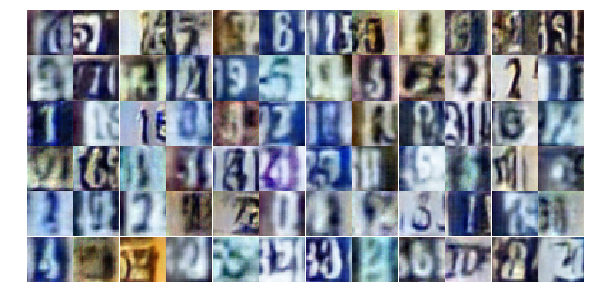

Epoch 12/25... Discriminator Loss: 0.5619... Generator Loss: 1.1546
Epoch 12/25... Discriminator Loss: 0.9496... Generator Loss: 0.6987
Epoch 12/25... Discriminator Loss: 0.5072... Generator Loss: 1.3122
Epoch 12/25... Discriminator Loss: 0.6293... Generator Loss: 1.1850
Epoch 12/25... Discriminator Loss: 0.3920... Generator Loss: 1.9893
Epoch 12/25... Discriminator Loss: 0.9169... Generator Loss: 0.7541
Epoch 12/25... Discriminator Loss: 1.4749... Generator Loss: 0.3502
Epoch 12/25... Discriminator Loss: 0.5552... Generator Loss: 2.1071
Epoch 12/25... Discriminator Loss: 0.5268... Generator Loss: 1.4443
Epoch 12/25... Discriminator Loss: 0.6636... Generator Loss: 0.9790


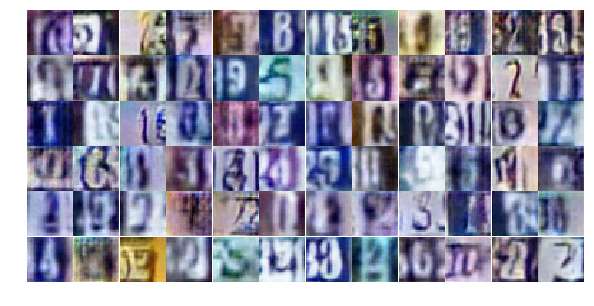

Epoch 12/25... Discriminator Loss: 0.5375... Generator Loss: 1.1893
Epoch 12/25... Discriminator Loss: 0.4920... Generator Loss: 1.3558
Epoch 12/25... Discriminator Loss: 0.6512... Generator Loss: 1.0287
Epoch 12/25... Discriminator Loss: 0.3626... Generator Loss: 1.8403
Epoch 12/25... Discriminator Loss: 0.3777... Generator Loss: 1.8783
Epoch 12/25... Discriminator Loss: 0.7032... Generator Loss: 0.9447
Epoch 12/25... Discriminator Loss: 0.7140... Generator Loss: 0.8927
Epoch 12/25... Discriminator Loss: 0.2817... Generator Loss: 1.9235
Epoch 12/25... Discriminator Loss: 0.4063... Generator Loss: 1.7210
Epoch 12/25... Discriminator Loss: 0.9213... Generator Loss: 0.7145


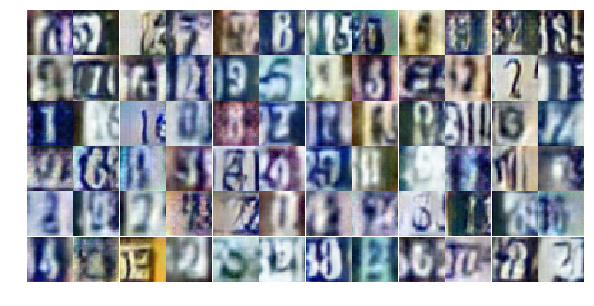

Epoch 12/25... Discriminator Loss: 0.5570... Generator Loss: 1.1904
Epoch 12/25... Discriminator Loss: 0.9722... Generator Loss: 0.6592
Epoch 12/25... Discriminator Loss: 0.7625... Generator Loss: 0.8263
Epoch 12/25... Discriminator Loss: 1.2538... Generator Loss: 0.6065
Epoch 12/25... Discriminator Loss: 0.6950... Generator Loss: 2.2100
Epoch 12/25... Discriminator Loss: 0.7473... Generator Loss: 1.1592
Epoch 12/25... Discriminator Loss: 1.0270... Generator Loss: 0.6484
Epoch 12/25... Discriminator Loss: 0.7442... Generator Loss: 1.0287
Epoch 12/25... Discriminator Loss: 0.8147... Generator Loss: 0.9058
Epoch 12/25... Discriminator Loss: 0.2842... Generator Loss: 2.2539


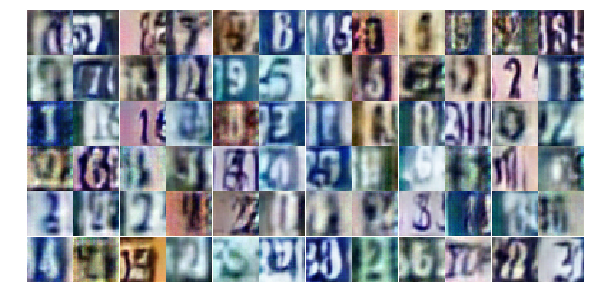

Epoch 12/25... Discriminator Loss: 1.1399... Generator Loss: 0.6125
Epoch 12/25... Discriminator Loss: 0.4198... Generator Loss: 1.7183
Epoch 12/25... Discriminator Loss: 0.4237... Generator Loss: 1.4597
Epoch 12/25... Discriminator Loss: 1.1225... Generator Loss: 0.6220
Epoch 12/25... Discriminator Loss: 0.6725... Generator Loss: 1.0759
Epoch 12/25... Discriminator Loss: 1.2375... Generator Loss: 0.4931
Epoch 12/25... Discriminator Loss: 0.8474... Generator Loss: 0.8665
Epoch 12/25... Discriminator Loss: 1.0186... Generator Loss: 0.6333
Epoch 12/25... Discriminator Loss: 0.5771... Generator Loss: 1.2152
Epoch 12/25... Discriminator Loss: 0.9433... Generator Loss: 0.6662


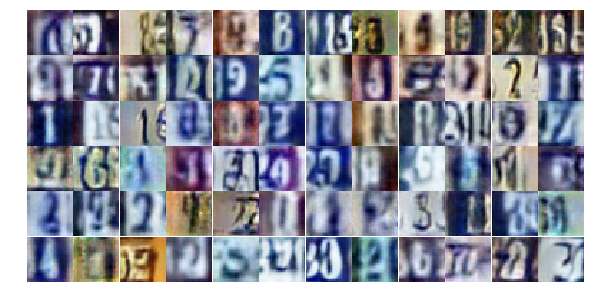

Epoch 12/25... Discriminator Loss: 0.9486... Generator Loss: 0.7340
Epoch 12/25... Discriminator Loss: 0.5490... Generator Loss: 1.3990
Epoch 12/25... Discriminator Loss: 0.7336... Generator Loss: 1.1004
Epoch 12/25... Discriminator Loss: 0.7001... Generator Loss: 1.1389
Epoch 12/25... Discriminator Loss: 0.6552... Generator Loss: 0.9993
Epoch 12/25... Discriminator Loss: 0.9753... Generator Loss: 2.1674
Epoch 12/25... Discriminator Loss: 0.8384... Generator Loss: 0.9147
Epoch 13/25... Discriminator Loss: 0.4542... Generator Loss: 1.4807
Epoch 13/25... Discriminator Loss: 0.5074... Generator Loss: 1.3868
Epoch 13/25... Discriminator Loss: 0.7637... Generator Loss: 0.9145


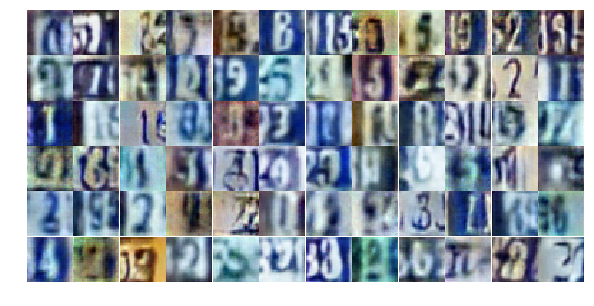

Epoch 13/25... Discriminator Loss: 0.5549... Generator Loss: 1.3739
Epoch 13/25... Discriminator Loss: 0.5250... Generator Loss: 1.2683
Epoch 13/25... Discriminator Loss: 0.8287... Generator Loss: 1.6556
Epoch 13/25... Discriminator Loss: 1.3671... Generator Loss: 0.3859
Epoch 13/25... Discriminator Loss: 0.5239... Generator Loss: 1.4199
Epoch 13/25... Discriminator Loss: 0.6025... Generator Loss: 1.4346
Epoch 13/25... Discriminator Loss: 0.2960... Generator Loss: 2.5025
Epoch 13/25... Discriminator Loss: 0.7304... Generator Loss: 0.9829
Epoch 13/25... Discriminator Loss: 0.5439... Generator Loss: 1.1958
Epoch 13/25... Discriminator Loss: 0.6041... Generator Loss: 1.2898


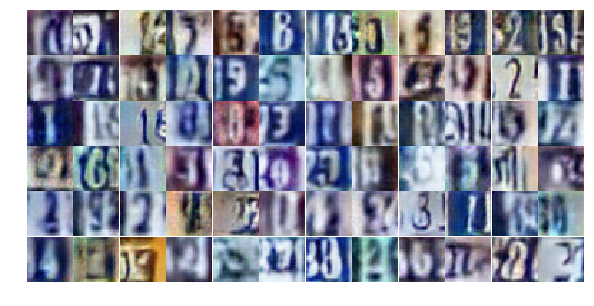

Epoch 13/25... Discriminator Loss: 0.5915... Generator Loss: 1.2173
Epoch 13/25... Discriminator Loss: 0.7590... Generator Loss: 1.8812
Epoch 13/25... Discriminator Loss: 1.9910... Generator Loss: 1.6941
Epoch 13/25... Discriminator Loss: 1.0534... Generator Loss: 0.7348
Epoch 13/25... Discriminator Loss: 0.4817... Generator Loss: 1.5540
Epoch 13/25... Discriminator Loss: 1.1646... Generator Loss: 0.5280
Epoch 13/25... Discriminator Loss: 0.6706... Generator Loss: 1.0940
Epoch 13/25... Discriminator Loss: 0.9651... Generator Loss: 0.7082
Epoch 13/25... Discriminator Loss: 0.5364... Generator Loss: 1.3469
Epoch 13/25... Discriminator Loss: 1.0870... Generator Loss: 0.5719


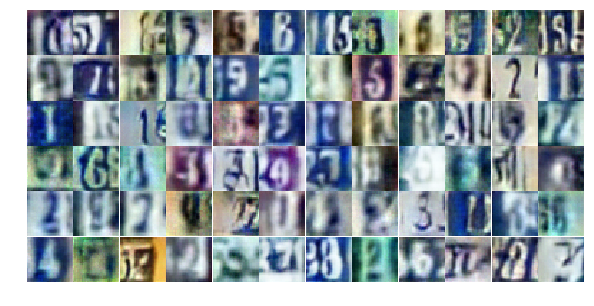

Epoch 13/25... Discriminator Loss: 0.6662... Generator Loss: 1.0354
Epoch 13/25... Discriminator Loss: 0.5805... Generator Loss: 1.3823
Epoch 13/25... Discriminator Loss: 0.6213... Generator Loss: 1.2091
Epoch 13/25... Discriminator Loss: 0.5126... Generator Loss: 1.2276
Epoch 13/25... Discriminator Loss: 0.5491... Generator Loss: 1.3246
Epoch 13/25... Discriminator Loss: 0.6883... Generator Loss: 0.9931
Epoch 13/25... Discriminator Loss: 0.7691... Generator Loss: 1.4353
Epoch 13/25... Discriminator Loss: 0.5457... Generator Loss: 1.2473
Epoch 13/25... Discriminator Loss: 0.6406... Generator Loss: 1.1665
Epoch 13/25... Discriminator Loss: 0.5178... Generator Loss: 1.7107


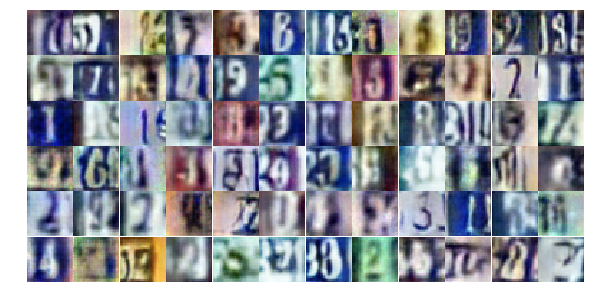

Epoch 13/25... Discriminator Loss: 1.1911... Generator Loss: 0.4969
Epoch 13/25... Discriminator Loss: 0.8737... Generator Loss: 0.7867
Epoch 13/25... Discriminator Loss: 1.2272... Generator Loss: 0.5341
Epoch 13/25... Discriminator Loss: 0.8801... Generator Loss: 0.7903
Epoch 13/25... Discriminator Loss: 0.6448... Generator Loss: 1.0256
Epoch 13/25... Discriminator Loss: 0.4526... Generator Loss: 1.5811
Epoch 13/25... Discriminator Loss: 0.6038... Generator Loss: 1.1946
Epoch 13/25... Discriminator Loss: 1.3355... Generator Loss: 0.4274
Epoch 13/25... Discriminator Loss: 0.6806... Generator Loss: 1.0150
Epoch 13/25... Discriminator Loss: 0.5415... Generator Loss: 1.4150


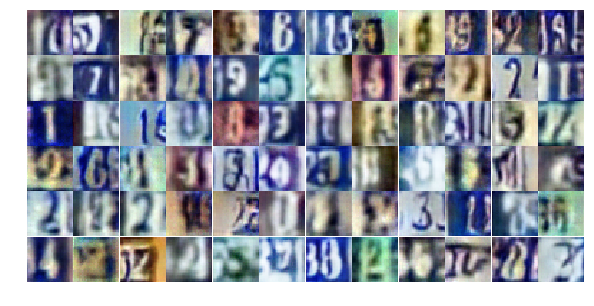

Epoch 13/25... Discriminator Loss: 0.6115... Generator Loss: 1.3434
Epoch 13/25... Discriminator Loss: 0.7488... Generator Loss: 1.0576
Epoch 13/25... Discriminator Loss: 1.1507... Generator Loss: 0.5536
Epoch 13/25... Discriminator Loss: 0.7495... Generator Loss: 1.1073
Epoch 13/25... Discriminator Loss: 0.9462... Generator Loss: 0.7737
Epoch 13/25... Discriminator Loss: 0.7693... Generator Loss: 0.8697
Epoch 13/25... Discriminator Loss: 1.1411... Generator Loss: 0.5303
Epoch 13/25... Discriminator Loss: 0.8599... Generator Loss: 0.7256
Epoch 13/25... Discriminator Loss: 0.9762... Generator Loss: 0.6788
Epoch 13/25... Discriminator Loss: 0.7018... Generator Loss: 0.9996


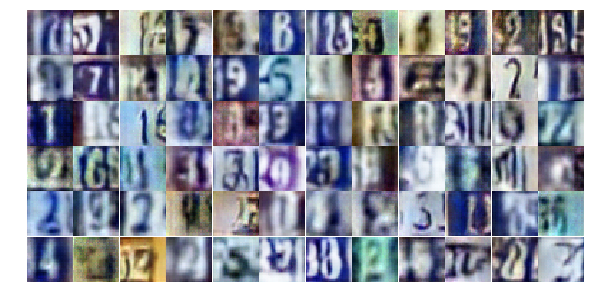

Epoch 13/25... Discriminator Loss: 0.3402... Generator Loss: 2.5027
Epoch 13/25... Discriminator Loss: 0.8849... Generator Loss: 0.7090
Epoch 13/25... Discriminator Loss: 0.8154... Generator Loss: 1.5861
Epoch 13/25... Discriminator Loss: 0.9433... Generator Loss: 0.6519
Epoch 14/25... Discriminator Loss: 1.1090... Generator Loss: 0.6167
Epoch 14/25... Discriminator Loss: 0.8667... Generator Loss: 0.8519
Epoch 14/25... Discriminator Loss: 1.0832... Generator Loss: 0.6080
Epoch 14/25... Discriminator Loss: 0.5168... Generator Loss: 1.7157
Epoch 14/25... Discriminator Loss: 0.6865... Generator Loss: 1.0125
Epoch 14/25... Discriminator Loss: 0.7716... Generator Loss: 0.8500


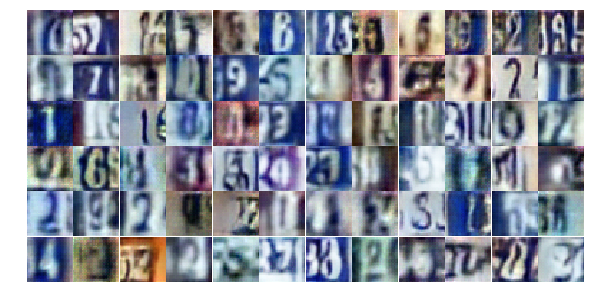

Epoch 14/25... Discriminator Loss: 1.4394... Generator Loss: 3.5347
Epoch 14/25... Discriminator Loss: 1.0551... Generator Loss: 0.9997
Epoch 14/25... Discriminator Loss: 0.9586... Generator Loss: 0.7408
Epoch 14/25... Discriminator Loss: 0.7518... Generator Loss: 1.0005
Epoch 14/25... Discriminator Loss: 1.0583... Generator Loss: 0.5768
Epoch 14/25... Discriminator Loss: 0.3021... Generator Loss: 2.4531
Epoch 14/25... Discriminator Loss: 0.4995... Generator Loss: 1.4848
Epoch 14/25... Discriminator Loss: 1.5122... Generator Loss: 0.3470
Epoch 14/25... Discriminator Loss: 1.0370... Generator Loss: 1.1320
Epoch 14/25... Discriminator Loss: 1.0559... Generator Loss: 0.6802


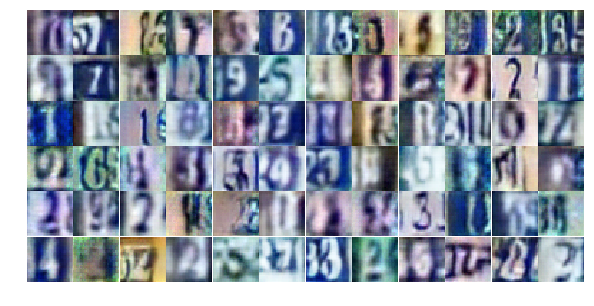

Epoch 14/25... Discriminator Loss: 0.6142... Generator Loss: 1.0195
Epoch 14/25... Discriminator Loss: 0.4588... Generator Loss: 1.7072
Epoch 14/25... Discriminator Loss: 0.8128... Generator Loss: 0.9214
Epoch 14/25... Discriminator Loss: 0.3227... Generator Loss: 2.3622
Epoch 14/25... Discriminator Loss: 0.8772... Generator Loss: 0.8060
Epoch 14/25... Discriminator Loss: 0.7309... Generator Loss: 1.0191
Epoch 14/25... Discriminator Loss: 0.6665... Generator Loss: 1.0613
Epoch 14/25... Discriminator Loss: 1.1343... Generator Loss: 0.5260
Epoch 14/25... Discriminator Loss: 0.5413... Generator Loss: 1.2986
Epoch 14/25... Discriminator Loss: 0.4112... Generator Loss: 1.9307


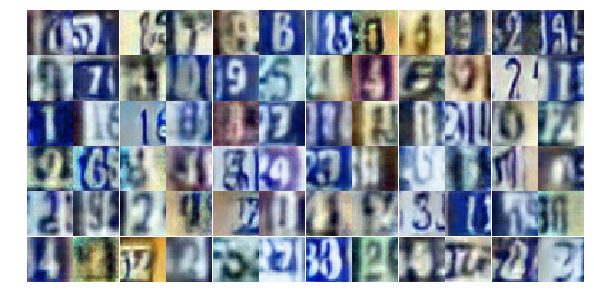

Epoch 14/25... Discriminator Loss: 0.9112... Generator Loss: 0.7430
Epoch 14/25... Discriminator Loss: 0.5093... Generator Loss: 1.2359
Epoch 14/25... Discriminator Loss: 0.4630... Generator Loss: 1.4985
Epoch 14/25... Discriminator Loss: 0.3755... Generator Loss: 1.5588
Epoch 14/25... Discriminator Loss: 0.6270... Generator Loss: 1.1204
Epoch 14/25... Discriminator Loss: 0.6502... Generator Loss: 1.1330
Epoch 14/25... Discriminator Loss: 0.8054... Generator Loss: 0.8862
Epoch 14/25... Discriminator Loss: 0.3462... Generator Loss: 1.8675
Epoch 14/25... Discriminator Loss: 0.4209... Generator Loss: 1.4077
Epoch 14/25... Discriminator Loss: 1.4326... Generator Loss: 1.8392


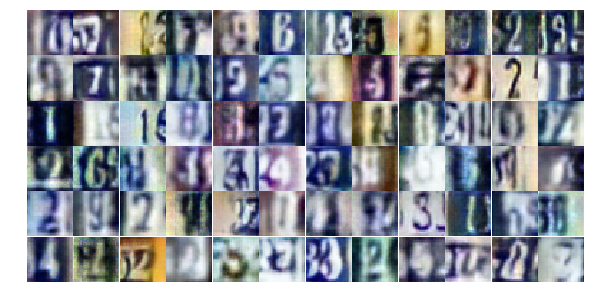

Epoch 14/25... Discriminator Loss: 1.4249... Generator Loss: 0.3963
Epoch 14/25... Discriminator Loss: 0.8209... Generator Loss: 1.6523
Epoch 14/25... Discriminator Loss: 1.0983... Generator Loss: 0.5728
Epoch 14/25... Discriminator Loss: 1.0590... Generator Loss: 0.5996
Epoch 14/25... Discriminator Loss: 0.5103... Generator Loss: 1.2727
Epoch 14/25... Discriminator Loss: 0.8447... Generator Loss: 0.7737
Epoch 14/25... Discriminator Loss: 0.6450... Generator Loss: 1.5176
Epoch 14/25... Discriminator Loss: 0.6344... Generator Loss: 1.0749
Epoch 14/25... Discriminator Loss: 1.7017... Generator Loss: 0.2808
Epoch 14/25... Discriminator Loss: 1.4297... Generator Loss: 0.3750


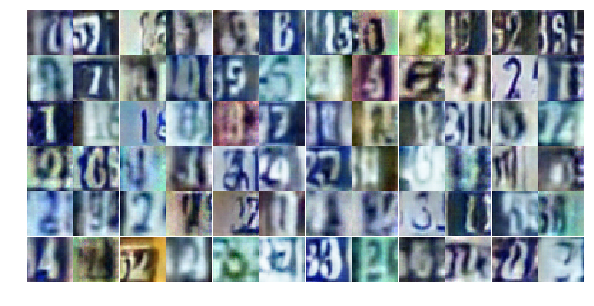

Epoch 14/25... Discriminator Loss: 0.8307... Generator Loss: 1.8986
Epoch 14/25... Discriminator Loss: 1.5232... Generator Loss: 0.3571
Epoch 14/25... Discriminator Loss: 0.6427... Generator Loss: 1.2512
Epoch 14/25... Discriminator Loss: 0.9568... Generator Loss: 0.6727
Epoch 14/25... Discriminator Loss: 0.7051... Generator Loss: 0.9950
Epoch 14/25... Discriminator Loss: 0.7010... Generator Loss: 0.9340
Epoch 14/25... Discriminator Loss: 0.8202... Generator Loss: 0.8311
Epoch 14/25... Discriminator Loss: 0.9347... Generator Loss: 0.7734
Epoch 14/25... Discriminator Loss: 1.2968... Generator Loss: 0.4996
Epoch 14/25... Discriminator Loss: 1.1855... Generator Loss: 0.5263


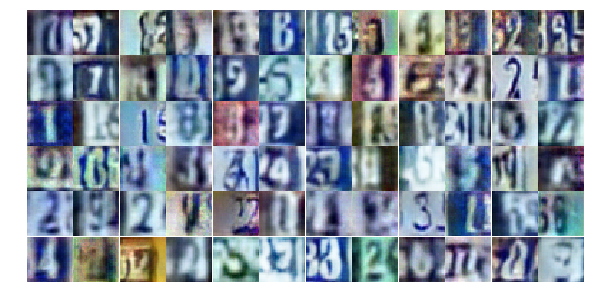

Epoch 14/25... Discriminator Loss: 1.3926... Generator Loss: 0.4491
Epoch 14/25... Discriminator Loss: 1.3186... Generator Loss: 0.4896
Epoch 15/25... Discriminator Loss: 0.8621... Generator Loss: 0.7652
Epoch 15/25... Discriminator Loss: 0.5843... Generator Loss: 1.4414
Epoch 15/25... Discriminator Loss: 0.5751... Generator Loss: 1.1547
Epoch 15/25... Discriminator Loss: 0.8563... Generator Loss: 0.7422
Epoch 15/25... Discriminator Loss: 0.5209... Generator Loss: 1.2140
Epoch 15/25... Discriminator Loss: 0.7582... Generator Loss: 0.9196
Epoch 15/25... Discriminator Loss: 1.9184... Generator Loss: 0.2829
Epoch 15/25... Discriminator Loss: 0.9460... Generator Loss: 0.7657


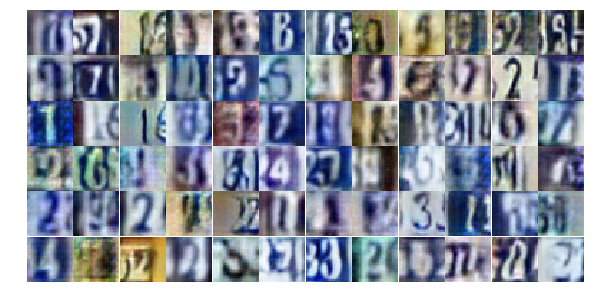

Epoch 15/25... Discriminator Loss: 0.7966... Generator Loss: 1.0430
Epoch 15/25... Discriminator Loss: 0.6203... Generator Loss: 1.2932
Epoch 15/25... Discriminator Loss: 0.9990... Generator Loss: 0.6603
Epoch 15/25... Discriminator Loss: 0.7165... Generator Loss: 1.0919
Epoch 15/25... Discriminator Loss: 1.0369... Generator Loss: 0.6954
Epoch 15/25... Discriminator Loss: 0.5045... Generator Loss: 1.3276
Epoch 15/25... Discriminator Loss: 0.5719... Generator Loss: 1.2285
Epoch 15/25... Discriminator Loss: 0.7155... Generator Loss: 2.1060
Epoch 15/25... Discriminator Loss: 0.5806... Generator Loss: 2.0953
Epoch 15/25... Discriminator Loss: 0.7514... Generator Loss: 1.0182


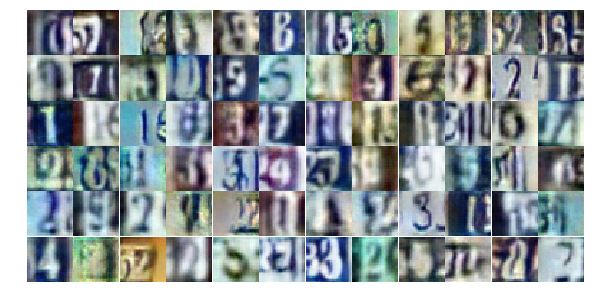

Epoch 15/25... Discriminator Loss: 0.8999... Generator Loss: 0.7163
Epoch 15/25... Discriminator Loss: 0.5864... Generator Loss: 1.2940
Epoch 15/25... Discriminator Loss: 0.5729... Generator Loss: 1.4644
Epoch 15/25... Discriminator Loss: 1.0421... Generator Loss: 0.6463
Epoch 15/25... Discriminator Loss: 0.7867... Generator Loss: 1.4153
Epoch 15/25... Discriminator Loss: 0.4123... Generator Loss: 1.7269
Epoch 15/25... Discriminator Loss: 1.2409... Generator Loss: 0.6032
Epoch 15/25... Discriminator Loss: 0.7029... Generator Loss: 1.2080
Epoch 15/25... Discriminator Loss: 0.5838... Generator Loss: 1.1905
Epoch 15/25... Discriminator Loss: 1.1466... Generator Loss: 0.7765


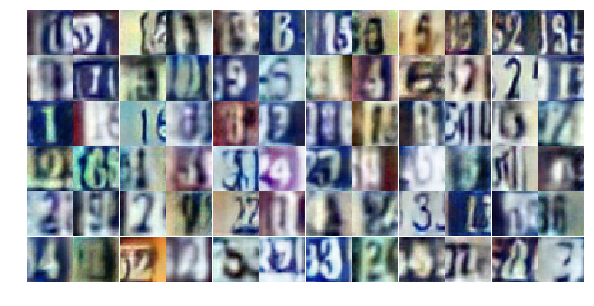

Epoch 15/25... Discriminator Loss: 0.6201... Generator Loss: 1.1182
Epoch 15/25... Discriminator Loss: 1.1055... Generator Loss: 0.6191
Epoch 15/25... Discriminator Loss: 0.4392... Generator Loss: 1.4446
Epoch 15/25... Discriminator Loss: 0.6790... Generator Loss: 1.3090
Epoch 15/25... Discriminator Loss: 0.5032... Generator Loss: 1.3024
Epoch 15/25... Discriminator Loss: 0.9264... Generator Loss: 2.7861
Epoch 15/25... Discriminator Loss: 0.5009... Generator Loss: 1.5580
Epoch 15/25... Discriminator Loss: 0.8172... Generator Loss: 1.2808
Epoch 15/25... Discriminator Loss: 0.5155... Generator Loss: 1.7785
Epoch 15/25... Discriminator Loss: 0.5776... Generator Loss: 1.3134


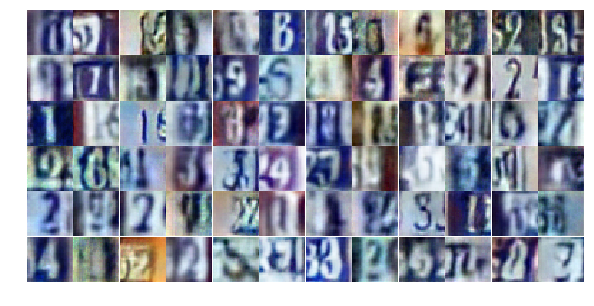

Epoch 15/25... Discriminator Loss: 0.6577... Generator Loss: 0.9691
Epoch 15/25... Discriminator Loss: 1.1617... Generator Loss: 0.5187
Epoch 15/25... Discriminator Loss: 0.6682... Generator Loss: 1.0284
Epoch 15/25... Discriminator Loss: 0.8296... Generator Loss: 0.8040
Epoch 15/25... Discriminator Loss: 0.8198... Generator Loss: 0.7665
Epoch 15/25... Discriminator Loss: 1.3393... Generator Loss: 0.4574
Epoch 15/25... Discriminator Loss: 0.6081... Generator Loss: 1.1280
Epoch 15/25... Discriminator Loss: 0.7285... Generator Loss: 1.3680
Epoch 15/25... Discriminator Loss: 0.7232... Generator Loss: 1.0234
Epoch 15/25... Discriminator Loss: 0.8927... Generator Loss: 0.9189


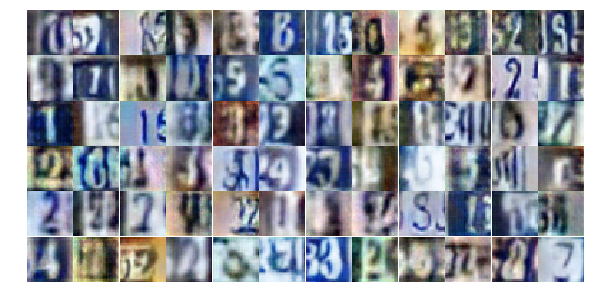

Epoch 15/25... Discriminator Loss: 1.0351... Generator Loss: 0.5809
Epoch 15/25... Discriminator Loss: 0.6351... Generator Loss: 1.8491
Epoch 15/25... Discriminator Loss: 0.4982... Generator Loss: 1.3935
Epoch 15/25... Discriminator Loss: 1.1422... Generator Loss: 0.9485
Epoch 15/25... Discriminator Loss: 0.6172... Generator Loss: 1.1757
Epoch 15/25... Discriminator Loss: 0.6401... Generator Loss: 1.4253
Epoch 15/25... Discriminator Loss: 1.2752... Generator Loss: 0.4733
Epoch 15/25... Discriminator Loss: 0.4692... Generator Loss: 1.5989
Epoch 15/25... Discriminator Loss: 1.7100... Generator Loss: 0.2650
Epoch 16/25... Discriminator Loss: 1.5045... Generator Loss: 0.3875


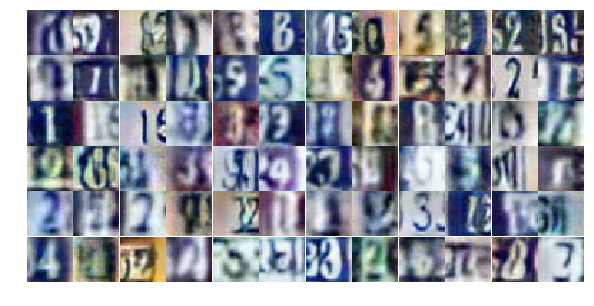

Epoch 16/25... Discriminator Loss: 0.7197... Generator Loss: 0.9227
Epoch 16/25... Discriminator Loss: 0.6621... Generator Loss: 1.0531
Epoch 16/25... Discriminator Loss: 1.2410... Generator Loss: 0.5251
Epoch 16/25... Discriminator Loss: 0.5718... Generator Loss: 1.2449
Epoch 16/25... Discriminator Loss: 0.4644... Generator Loss: 1.4424
Epoch 16/25... Discriminator Loss: 0.7581... Generator Loss: 1.3129
Epoch 16/25... Discriminator Loss: 1.7136... Generator Loss: 0.2618
Epoch 16/25... Discriminator Loss: 0.9989... Generator Loss: 0.6469
Epoch 16/25... Discriminator Loss: 0.6977... Generator Loss: 0.9634
Epoch 16/25... Discriminator Loss: 0.5764... Generator Loss: 1.1440


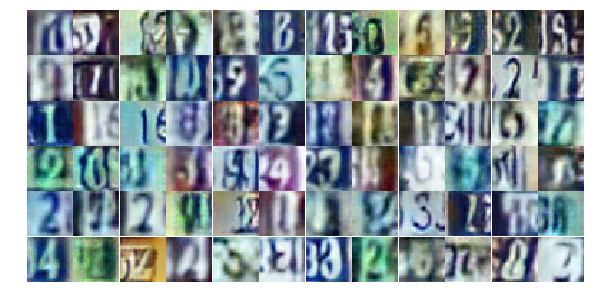

Epoch 16/25... Discriminator Loss: 0.8889... Generator Loss: 1.7323
Epoch 16/25... Discriminator Loss: 0.6194... Generator Loss: 1.2532
Epoch 16/25... Discriminator Loss: 0.7458... Generator Loss: 1.2555
Epoch 16/25... Discriminator Loss: 0.9650... Generator Loss: 0.6514
Epoch 16/25... Discriminator Loss: 0.4966... Generator Loss: 1.3433
Epoch 16/25... Discriminator Loss: 0.6649... Generator Loss: 1.2610
Epoch 16/25... Discriminator Loss: 2.7567... Generator Loss: 0.2811
Epoch 16/25... Discriminator Loss: 0.6980... Generator Loss: 2.4298
Epoch 16/25... Discriminator Loss: 0.5429... Generator Loss: 1.5722
Epoch 16/25... Discriminator Loss: 0.7187... Generator Loss: 1.2962


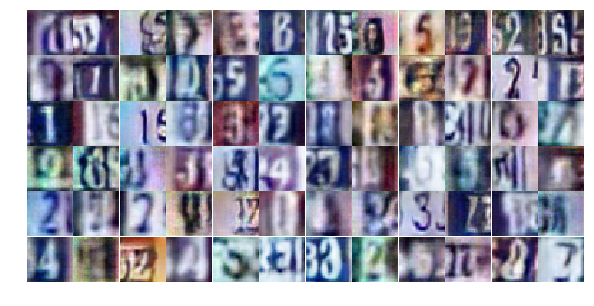

Epoch 16/25... Discriminator Loss: 0.7545... Generator Loss: 1.0087
Epoch 16/25... Discriminator Loss: 0.7201... Generator Loss: 0.9840
Epoch 16/25... Discriminator Loss: 0.7316... Generator Loss: 1.5083
Epoch 16/25... Discriminator Loss: 1.4090... Generator Loss: 0.3816
Epoch 16/25... Discriminator Loss: 0.9167... Generator Loss: 0.7695
Epoch 16/25... Discriminator Loss: 0.8275... Generator Loss: 0.8106
Epoch 16/25... Discriminator Loss: 0.7841... Generator Loss: 1.0164
Epoch 16/25... Discriminator Loss: 0.5624... Generator Loss: 1.1527
Epoch 16/25... Discriminator Loss: 0.8618... Generator Loss: 0.8319
Epoch 16/25... Discriminator Loss: 0.7283... Generator Loss: 0.9535


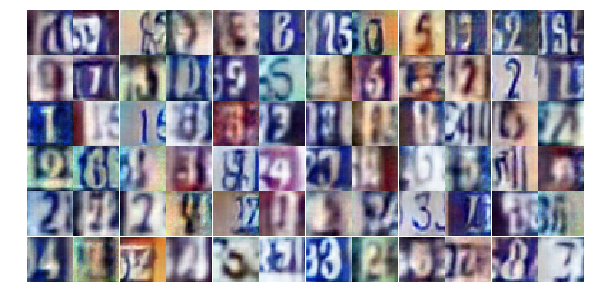

Epoch 16/25... Discriminator Loss: 0.7955... Generator Loss: 0.7936
Epoch 16/25... Discriminator Loss: 0.7433... Generator Loss: 0.9945
Epoch 16/25... Discriminator Loss: 0.7087... Generator Loss: 1.5341
Epoch 16/25... Discriminator Loss: 0.8279... Generator Loss: 0.8376
Epoch 16/25... Discriminator Loss: 1.4445... Generator Loss: 0.3905
Epoch 16/25... Discriminator Loss: 0.7531... Generator Loss: 2.1938
Epoch 16/25... Discriminator Loss: 0.9084... Generator Loss: 0.7359
Epoch 16/25... Discriminator Loss: 0.7281... Generator Loss: 0.8444
Epoch 16/25... Discriminator Loss: 1.1520... Generator Loss: 0.6002
Epoch 16/25... Discriminator Loss: 0.4727... Generator Loss: 1.4340


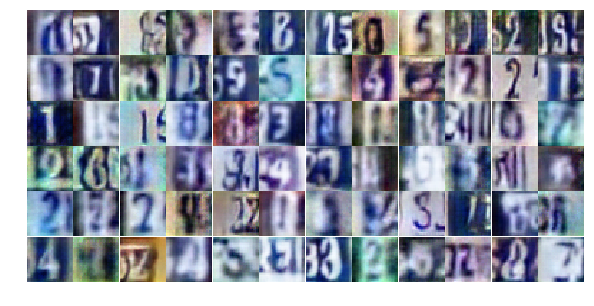

Epoch 16/25... Discriminator Loss: 0.6135... Generator Loss: 1.3123
Epoch 16/25... Discriminator Loss: 0.6290... Generator Loss: 1.2147
Epoch 16/25... Discriminator Loss: 1.3662... Generator Loss: 0.5094
Epoch 16/25... Discriminator Loss: 1.0977... Generator Loss: 0.6264
Epoch 16/25... Discriminator Loss: 0.6097... Generator Loss: 1.1446
Epoch 16/25... Discriminator Loss: 1.2122... Generator Loss: 0.4774
Epoch 16/25... Discriminator Loss: 0.4804... Generator Loss: 2.0105
Epoch 16/25... Discriminator Loss: 1.1107... Generator Loss: 0.5970
Epoch 16/25... Discriminator Loss: 0.7033... Generator Loss: 0.9186
Epoch 16/25... Discriminator Loss: 0.8073... Generator Loss: 0.9058


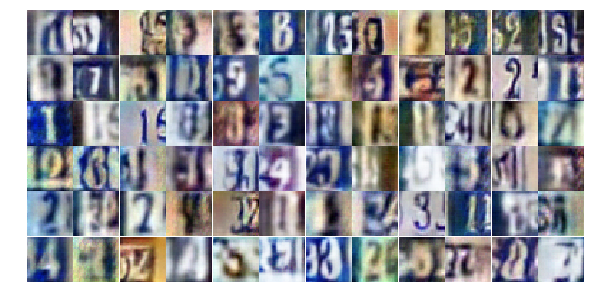

Epoch 16/25... Discriminator Loss: 1.2829... Generator Loss: 0.4519
Epoch 16/25... Discriminator Loss: 0.5726... Generator Loss: 1.7232
Epoch 16/25... Discriminator Loss: 1.5531... Generator Loss: 0.3206
Epoch 16/25... Discriminator Loss: 0.4477... Generator Loss: 1.4325
Epoch 16/25... Discriminator Loss: 0.7331... Generator Loss: 1.0900
Epoch 16/25... Discriminator Loss: 0.4642... Generator Loss: 2.5421
Epoch 17/25... Discriminator Loss: 0.9008... Generator Loss: 0.7655
Epoch 17/25... Discriminator Loss: 0.8256... Generator Loss: 0.9099
Epoch 17/25... Discriminator Loss: 0.8700... Generator Loss: 0.7802
Epoch 17/25... Discriminator Loss: 1.2797... Generator Loss: 0.4631


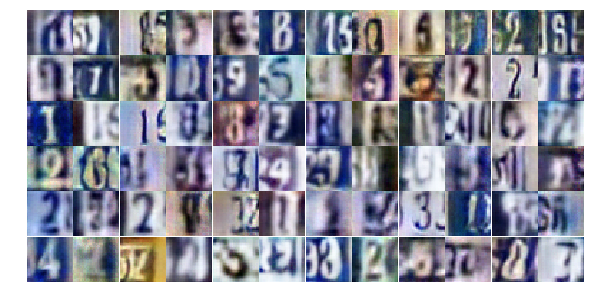

Epoch 17/25... Discriminator Loss: 0.5544... Generator Loss: 1.4794
Epoch 17/25... Discriminator Loss: 0.7213... Generator Loss: 1.0023
Epoch 17/25... Discriminator Loss: 0.7085... Generator Loss: 1.1466
Epoch 17/25... Discriminator Loss: 0.6371... Generator Loss: 1.1317
Epoch 17/25... Discriminator Loss: 1.1610... Generator Loss: 0.5316
Epoch 17/25... Discriminator Loss: 1.3966... Generator Loss: 0.4310
Epoch 17/25... Discriminator Loss: 1.1069... Generator Loss: 0.5394
Epoch 17/25... Discriminator Loss: 0.8778... Generator Loss: 0.7728
Epoch 17/25... Discriminator Loss: 0.3673... Generator Loss: 1.6671
Epoch 17/25... Discriminator Loss: 0.4875... Generator Loss: 1.6462


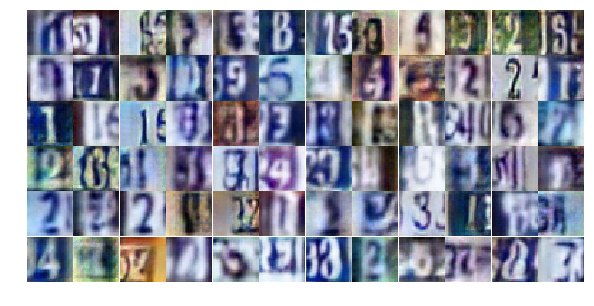

Epoch 17/25... Discriminator Loss: 1.0206... Generator Loss: 0.6721
Epoch 17/25... Discriminator Loss: 1.5027... Generator Loss: 4.3542
Epoch 17/25... Discriminator Loss: 0.5975... Generator Loss: 1.6158
Epoch 17/25... Discriminator Loss: 0.6925... Generator Loss: 1.1813
Epoch 17/25... Discriminator Loss: 0.7982... Generator Loss: 1.1631
Epoch 17/25... Discriminator Loss: 1.0715... Generator Loss: 0.6831
Epoch 17/25... Discriminator Loss: 0.5723... Generator Loss: 1.2327
Epoch 17/25... Discriminator Loss: 0.5528... Generator Loss: 1.1989
Epoch 17/25... Discriminator Loss: 0.8061... Generator Loss: 0.8602
Epoch 17/25... Discriminator Loss: 0.6034... Generator Loss: 1.0294


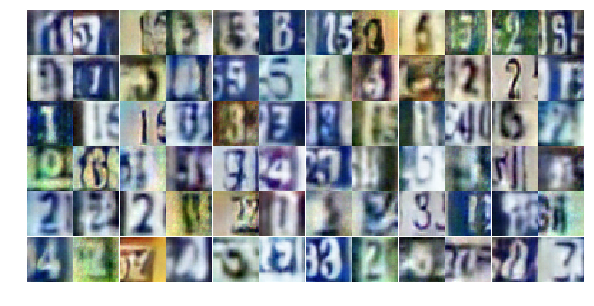

Epoch 17/25... Discriminator Loss: 1.4329... Generator Loss: 0.4094
Epoch 17/25... Discriminator Loss: 0.4941... Generator Loss: 1.5065
Epoch 17/25... Discriminator Loss: 0.6301... Generator Loss: 1.1788
Epoch 17/25... Discriminator Loss: 0.9791... Generator Loss: 0.6708
Epoch 17/25... Discriminator Loss: 0.8893... Generator Loss: 0.7820
Epoch 17/25... Discriminator Loss: 0.5658... Generator Loss: 1.1888
Epoch 17/25... Discriminator Loss: 0.6113... Generator Loss: 1.2509
Epoch 17/25... Discriminator Loss: 1.1134... Generator Loss: 0.6003
Epoch 17/25... Discriminator Loss: 1.0447... Generator Loss: 0.6014
Epoch 17/25... Discriminator Loss: 0.3772... Generator Loss: 1.8844


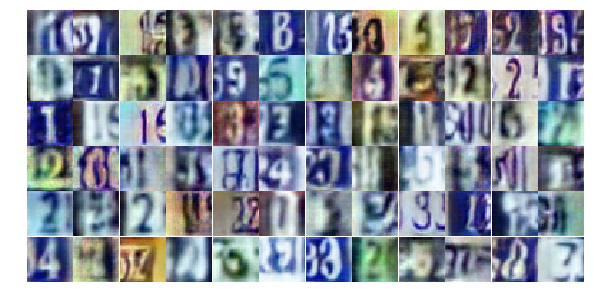

Epoch 17/25... Discriminator Loss: 0.7556... Generator Loss: 0.9822
Epoch 17/25... Discriminator Loss: 0.9467... Generator Loss: 0.8626
Epoch 17/25... Discriminator Loss: 0.7215... Generator Loss: 0.9396
Epoch 17/25... Discriminator Loss: 0.8183... Generator Loss: 0.9538
Epoch 17/25... Discriminator Loss: 0.8197... Generator Loss: 0.8178
Epoch 17/25... Discriminator Loss: 0.7020... Generator Loss: 0.9658
Epoch 17/25... Discriminator Loss: 1.3481... Generator Loss: 0.4357
Epoch 17/25... Discriminator Loss: 0.5144... Generator Loss: 1.4157
Epoch 17/25... Discriminator Loss: 0.3170... Generator Loss: 2.0472
Epoch 17/25... Discriminator Loss: 0.7860... Generator Loss: 0.8674


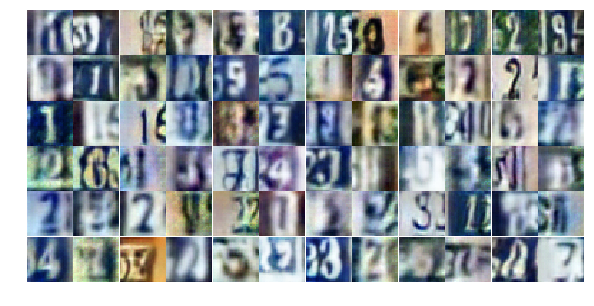

Epoch 17/25... Discriminator Loss: 0.7634... Generator Loss: 1.3498
Epoch 17/25... Discriminator Loss: 0.2881... Generator Loss: 1.9304
Epoch 17/25... Discriminator Loss: 0.8902... Generator Loss: 1.7368
Epoch 17/25... Discriminator Loss: 0.5898... Generator Loss: 1.0330
Epoch 17/25... Discriminator Loss: 0.7728... Generator Loss: 0.9255
Epoch 17/25... Discriminator Loss: 1.2354... Generator Loss: 0.4626
Epoch 17/25... Discriminator Loss: 1.0045... Generator Loss: 0.6135
Epoch 17/25... Discriminator Loss: 0.5217... Generator Loss: 1.3688
Epoch 17/25... Discriminator Loss: 0.6152... Generator Loss: 1.2310
Epoch 17/25... Discriminator Loss: 1.4242... Generator Loss: 0.5729


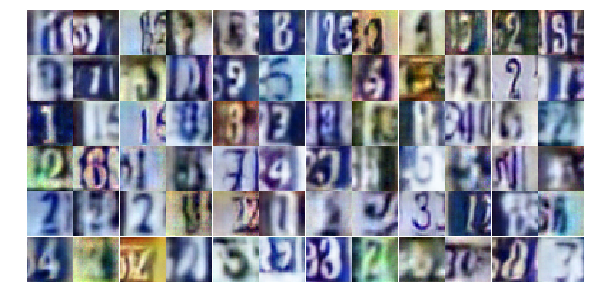

Epoch 17/25... Discriminator Loss: 0.7210... Generator Loss: 1.1069
Epoch 17/25... Discriminator Loss: 1.2320... Generator Loss: 0.5252
Epoch 17/25... Discriminator Loss: 0.5761... Generator Loss: 1.1628
Epoch 17/25... Discriminator Loss: 0.5349... Generator Loss: 1.9834
Epoch 18/25... Discriminator Loss: 1.0306... Generator Loss: 0.6636
Epoch 18/25... Discriminator Loss: 0.9767... Generator Loss: 0.7292
Epoch 18/25... Discriminator Loss: 1.0267... Generator Loss: 0.6184
Epoch 18/25... Discriminator Loss: 0.5490... Generator Loss: 1.1946
Epoch 18/25... Discriminator Loss: 1.2793... Generator Loss: 0.4296
Epoch 18/25... Discriminator Loss: 0.8133... Generator Loss: 0.8793


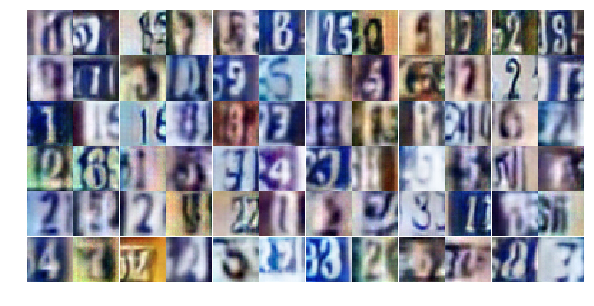

Epoch 18/25... Discriminator Loss: 0.4896... Generator Loss: 1.3868
Epoch 18/25... Discriminator Loss: 1.2970... Generator Loss: 0.4314
Epoch 18/25... Discriminator Loss: 0.7836... Generator Loss: 0.9192
Epoch 18/25... Discriminator Loss: 0.5933... Generator Loss: 1.0713
Epoch 18/25... Discriminator Loss: 0.7795... Generator Loss: 0.8063
Epoch 18/25... Discriminator Loss: 1.1177... Generator Loss: 0.5783
Epoch 18/25... Discriminator Loss: 0.5999... Generator Loss: 1.2080
Epoch 18/25... Discriminator Loss: 1.1515... Generator Loss: 0.5115
Epoch 18/25... Discriminator Loss: 0.7193... Generator Loss: 2.2653
Epoch 18/25... Discriminator Loss: 0.3558... Generator Loss: 1.7769


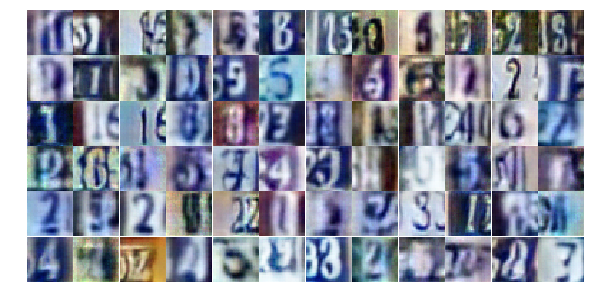

Epoch 18/25... Discriminator Loss: 0.6192... Generator Loss: 1.1479
Epoch 18/25... Discriminator Loss: 0.6918... Generator Loss: 1.2106
Epoch 18/25... Discriminator Loss: 0.9472... Generator Loss: 0.7088
Epoch 18/25... Discriminator Loss: 0.5877... Generator Loss: 1.2372
Epoch 18/25... Discriminator Loss: 0.9319... Generator Loss: 0.7449
Epoch 18/25... Discriminator Loss: 0.9329... Generator Loss: 0.6774
Epoch 18/25... Discriminator Loss: 1.0712... Generator Loss: 0.6509
Epoch 18/25... Discriminator Loss: 0.9753... Generator Loss: 0.6329
Epoch 18/25... Discriminator Loss: 0.8051... Generator Loss: 0.8700
Epoch 18/25... Discriminator Loss: 0.5531... Generator Loss: 1.1940


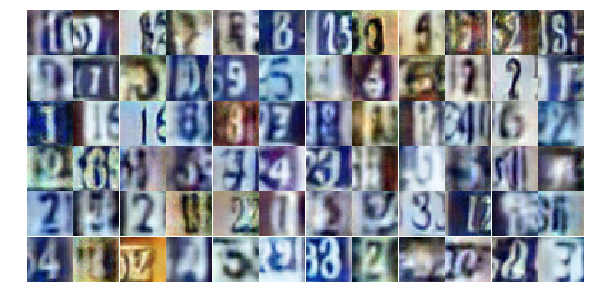

Epoch 18/25... Discriminator Loss: 0.5522... Generator Loss: 1.2753
Epoch 18/25... Discriminator Loss: 0.7614... Generator Loss: 1.3053
Epoch 18/25... Discriminator Loss: 0.5545... Generator Loss: 1.3538
Epoch 18/25... Discriminator Loss: 0.9192... Generator Loss: 0.7448
Epoch 18/25... Discriminator Loss: 1.0292... Generator Loss: 0.5980
Epoch 18/25... Discriminator Loss: 0.5294... Generator Loss: 1.4080
Epoch 18/25... Discriminator Loss: 0.6331... Generator Loss: 1.2251
Epoch 18/25... Discriminator Loss: 0.4783... Generator Loss: 1.4012
Epoch 18/25... Discriminator Loss: 0.4672... Generator Loss: 1.2942
Epoch 18/25... Discriminator Loss: 0.6145... Generator Loss: 1.2423


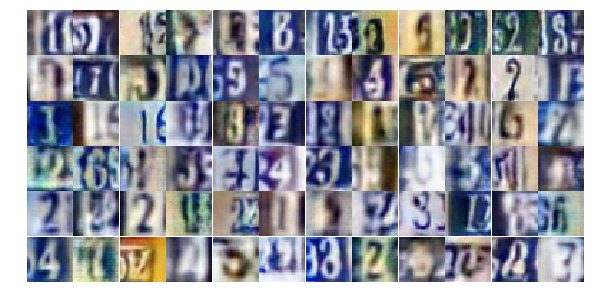

Epoch 18/25... Discriminator Loss: 0.7574... Generator Loss: 0.9373
Epoch 18/25... Discriminator Loss: 0.7815... Generator Loss: 0.8637
Epoch 18/25... Discriminator Loss: 0.6982... Generator Loss: 0.9575
Epoch 18/25... Discriminator Loss: 0.8067... Generator Loss: 0.7941
Epoch 18/25... Discriminator Loss: 0.7251... Generator Loss: 1.0410
Epoch 18/25... Discriminator Loss: 0.3795... Generator Loss: 1.5096
Epoch 18/25... Discriminator Loss: 0.9378... Generator Loss: 0.6855
Epoch 18/25... Discriminator Loss: 3.0136... Generator Loss: 4.4886
Epoch 18/25... Discriminator Loss: 1.4989... Generator Loss: 0.4184
Epoch 18/25... Discriminator Loss: 0.6053... Generator Loss: 1.2849


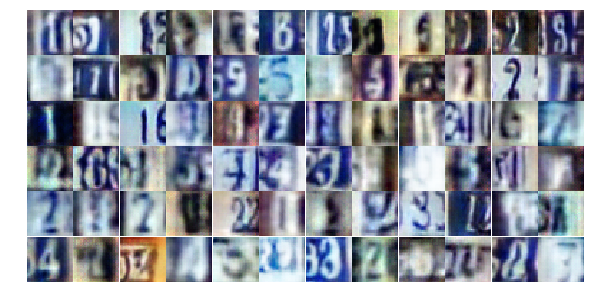

Epoch 18/25... Discriminator Loss: 0.7741... Generator Loss: 0.9164
Epoch 18/25... Discriminator Loss: 1.0790... Generator Loss: 0.5696
Epoch 18/25... Discriminator Loss: 1.0857... Generator Loss: 0.5863
Epoch 18/25... Discriminator Loss: 0.8610... Generator Loss: 0.9101
Epoch 18/25... Discriminator Loss: 0.6817... Generator Loss: 1.0643
Epoch 18/25... Discriminator Loss: 0.9670... Generator Loss: 2.0504
Epoch 18/25... Discriminator Loss: 0.5116... Generator Loss: 1.4438
Epoch 18/25... Discriminator Loss: 0.4853... Generator Loss: 1.3650
Epoch 18/25... Discriminator Loss: 1.1875... Generator Loss: 0.5331
Epoch 18/25... Discriminator Loss: 1.0572... Generator Loss: 0.5985


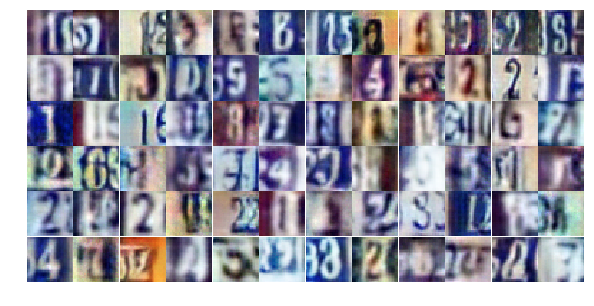

Epoch 18/25... Discriminator Loss: 0.4607... Generator Loss: 1.7978
Epoch 19/25... Discriminator Loss: 1.2569... Generator Loss: 0.4507
Epoch 19/25... Discriminator Loss: 1.4672... Generator Loss: 0.3903
Epoch 19/25... Discriminator Loss: 0.7309... Generator Loss: 1.0396
Epoch 19/25... Discriminator Loss: 0.5129... Generator Loss: 1.2095
Epoch 19/25... Discriminator Loss: 0.9965... Generator Loss: 0.6961
Epoch 19/25... Discriminator Loss: 0.4238... Generator Loss: 1.6881
Epoch 19/25... Discriminator Loss: 0.9529... Generator Loss: 0.7721
Epoch 19/25... Discriminator Loss: 0.6831... Generator Loss: 2.3818
Epoch 19/25... Discriminator Loss: 1.1914... Generator Loss: 0.5122


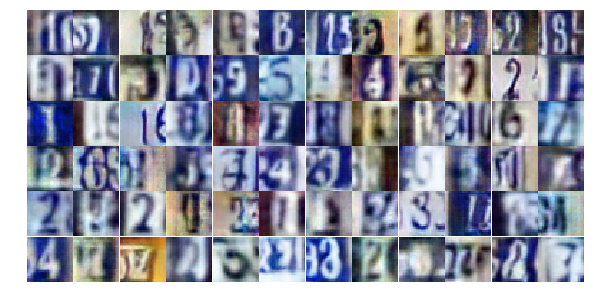

Epoch 19/25... Discriminator Loss: 0.9129... Generator Loss: 0.7019
Epoch 19/25... Discriminator Loss: 0.9447... Generator Loss: 0.6574
Epoch 19/25... Discriminator Loss: 0.6168... Generator Loss: 1.3266
Epoch 19/25... Discriminator Loss: 1.0153... Generator Loss: 0.6294
Epoch 19/25... Discriminator Loss: 0.7801... Generator Loss: 0.8490
Epoch 19/25... Discriminator Loss: 0.7105... Generator Loss: 0.9612
Epoch 19/25... Discriminator Loss: 1.2864... Generator Loss: 0.4230
Epoch 19/25... Discriminator Loss: 0.7006... Generator Loss: 0.9878
Epoch 19/25... Discriminator Loss: 0.5768... Generator Loss: 1.4442
Epoch 19/25... Discriminator Loss: 1.1821... Generator Loss: 0.5415


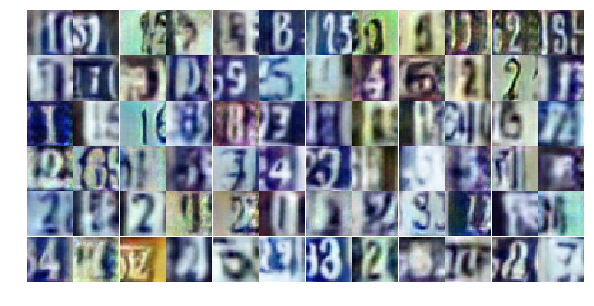

Epoch 19/25... Discriminator Loss: 0.7294... Generator Loss: 0.9359
Epoch 19/25... Discriminator Loss: 1.1268... Generator Loss: 0.5852
Epoch 19/25... Discriminator Loss: 1.2770... Generator Loss: 0.5142
Epoch 19/25... Discriminator Loss: 0.6667... Generator Loss: 1.1294
Epoch 19/25... Discriminator Loss: 1.0630... Generator Loss: 0.6423
Epoch 19/25... Discriminator Loss: 0.7345... Generator Loss: 1.5176
Epoch 19/25... Discriminator Loss: 0.8514... Generator Loss: 0.8852
Epoch 19/25... Discriminator Loss: 0.6564... Generator Loss: 1.0457
Epoch 19/25... Discriminator Loss: 0.7445... Generator Loss: 0.9342
Epoch 19/25... Discriminator Loss: 1.4123... Generator Loss: 0.4515


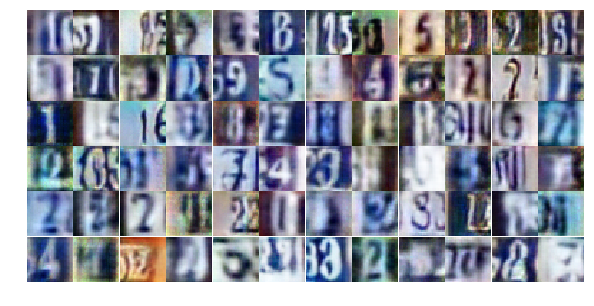

Epoch 19/25... Discriminator Loss: 0.9147... Generator Loss: 0.7718
Epoch 19/25... Discriminator Loss: 0.7305... Generator Loss: 0.9199
Epoch 19/25... Discriminator Loss: 0.9287... Generator Loss: 0.6879
Epoch 19/25... Discriminator Loss: 0.6958... Generator Loss: 1.0023
Epoch 19/25... Discriminator Loss: 0.7441... Generator Loss: 0.9786
Epoch 19/25... Discriminator Loss: 1.2953... Generator Loss: 0.4952
Epoch 19/25... Discriminator Loss: 0.9014... Generator Loss: 0.8644
Epoch 19/25... Discriminator Loss: 0.7764... Generator Loss: 0.9722
Epoch 19/25... Discriminator Loss: 0.7102... Generator Loss: 1.0233
Epoch 19/25... Discriminator Loss: 0.5608... Generator Loss: 1.1016


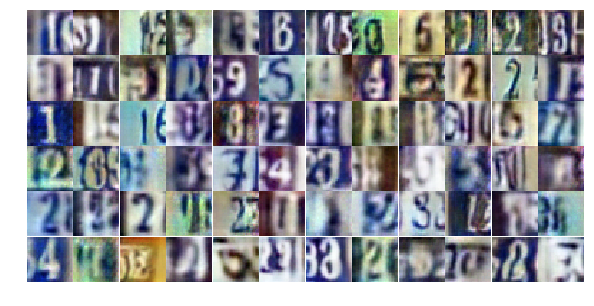

Epoch 19/25... Discriminator Loss: 0.5556... Generator Loss: 1.1434
Epoch 19/25... Discriminator Loss: 1.1356... Generator Loss: 0.5987
Epoch 19/25... Discriminator Loss: 0.8150... Generator Loss: 0.8688
Epoch 19/25... Discriminator Loss: 0.5465... Generator Loss: 1.2311
Epoch 19/25... Discriminator Loss: 0.6301... Generator Loss: 1.4439
Epoch 19/25... Discriminator Loss: 0.7709... Generator Loss: 0.9359
Epoch 19/25... Discriminator Loss: 0.9320... Generator Loss: 0.7142
Epoch 19/25... Discriminator Loss: 0.4656... Generator Loss: 1.7153
Epoch 19/25... Discriminator Loss: 0.5607... Generator Loss: 1.2943
Epoch 19/25... Discriminator Loss: 0.7799... Generator Loss: 0.9099


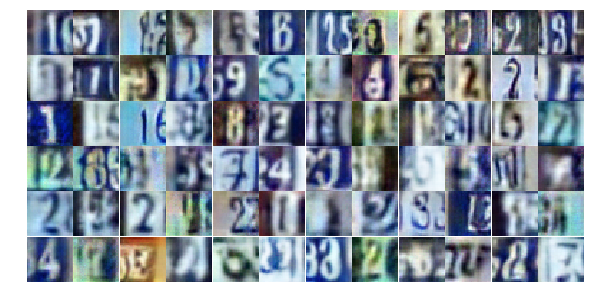

Epoch 19/25... Discriminator Loss: 0.7695... Generator Loss: 0.8936
Epoch 19/25... Discriminator Loss: 0.6162... Generator Loss: 1.2492
Epoch 19/25... Discriminator Loss: 0.8309... Generator Loss: 1.0050
Epoch 19/25... Discriminator Loss: 0.9051... Generator Loss: 0.8375
Epoch 19/25... Discriminator Loss: 0.6181... Generator Loss: 1.1669
Epoch 19/25... Discriminator Loss: 0.8596... Generator Loss: 0.8534
Epoch 19/25... Discriminator Loss: 1.7855... Generator Loss: 0.3114
Epoch 19/25... Discriminator Loss: 1.9053... Generator Loss: 1.1343
Epoch 20/25... Discriminator Loss: 1.3838... Generator Loss: 2.3262
Epoch 20/25... Discriminator Loss: 0.7213... Generator Loss: 1.2223


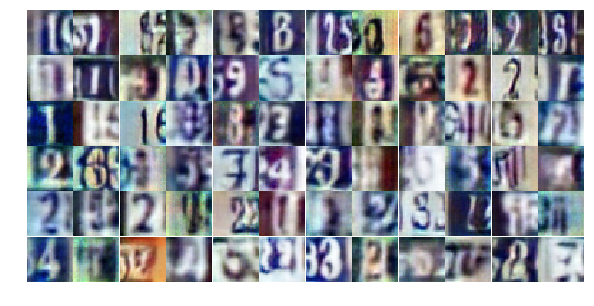

Epoch 20/25... Discriminator Loss: 0.8476... Generator Loss: 0.8288
Epoch 20/25... Discriminator Loss: 1.0228... Generator Loss: 0.7092
Epoch 20/25... Discriminator Loss: 1.3893... Generator Loss: 0.3956
Epoch 20/25... Discriminator Loss: 1.0491... Generator Loss: 0.6708
Epoch 20/25... Discriminator Loss: 0.6542... Generator Loss: 1.0464
Epoch 20/25... Discriminator Loss: 0.9125... Generator Loss: 0.7292
Epoch 20/25... Discriminator Loss: 0.6604... Generator Loss: 1.0485
Epoch 20/25... Discriminator Loss: 0.6950... Generator Loss: 2.0203
Epoch 20/25... Discriminator Loss: 1.2346... Generator Loss: 0.4866
Epoch 20/25... Discriminator Loss: 0.8262... Generator Loss: 0.8090


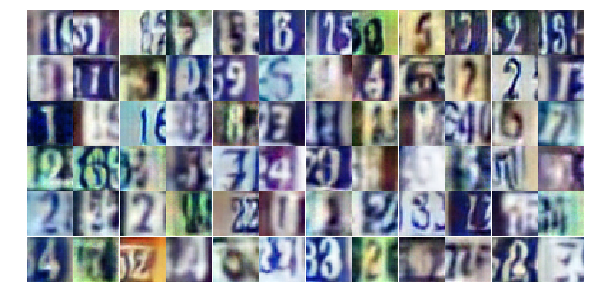

Epoch 20/25... Discriminator Loss: 1.1291... Generator Loss: 0.6699
Epoch 20/25... Discriminator Loss: 0.7445... Generator Loss: 0.9768
Epoch 20/25... Discriminator Loss: 0.7918... Generator Loss: 0.9441
Epoch 20/25... Discriminator Loss: 1.9342... Generator Loss: 0.2692
Epoch 20/25... Discriminator Loss: 1.4139... Generator Loss: 0.4213
Epoch 20/25... Discriminator Loss: 1.1809... Generator Loss: 0.5698
Epoch 20/25... Discriminator Loss: 1.2859... Generator Loss: 0.5126
Epoch 20/25... Discriminator Loss: 0.6316... Generator Loss: 1.0566
Epoch 20/25... Discriminator Loss: 0.5465... Generator Loss: 1.2902
Epoch 20/25... Discriminator Loss: 0.9958... Generator Loss: 0.7830


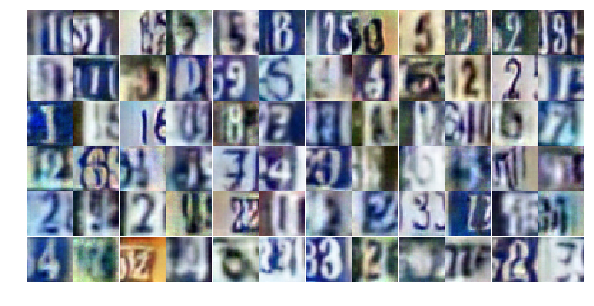

Epoch 20/25... Discriminator Loss: 0.6533... Generator Loss: 1.0955
Epoch 20/25... Discriminator Loss: 0.7871... Generator Loss: 0.9336
Epoch 20/25... Discriminator Loss: 0.4153... Generator Loss: 1.3740
Epoch 20/25... Discriminator Loss: 1.5698... Generator Loss: 0.3404
Epoch 20/25... Discriminator Loss: 0.8104... Generator Loss: 0.9047
Epoch 20/25... Discriminator Loss: 0.5650... Generator Loss: 1.2177
Epoch 20/25... Discriminator Loss: 0.5868... Generator Loss: 1.2353
Epoch 20/25... Discriminator Loss: 1.9638... Generator Loss: 0.2375
Epoch 20/25... Discriminator Loss: 1.1617... Generator Loss: 0.5188
Epoch 20/25... Discriminator Loss: 0.4904... Generator Loss: 1.2145


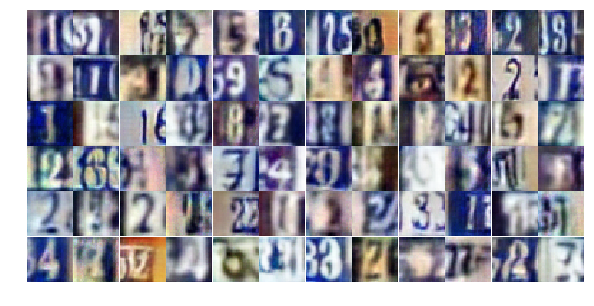

Epoch 20/25... Discriminator Loss: 0.8728... Generator Loss: 1.0625
Epoch 20/25... Discriminator Loss: 0.6405... Generator Loss: 1.1740
Epoch 20/25... Discriminator Loss: 0.8737... Generator Loss: 0.8965
Epoch 20/25... Discriminator Loss: 0.7307... Generator Loss: 0.9613
Epoch 20/25... Discriminator Loss: 0.7485... Generator Loss: 1.0223
Epoch 20/25... Discriminator Loss: 0.5696... Generator Loss: 1.4082
Epoch 20/25... Discriminator Loss: 0.8977... Generator Loss: 0.8200
Epoch 20/25... Discriminator Loss: 0.8426... Generator Loss: 0.8682
Epoch 20/25... Discriminator Loss: 0.7264... Generator Loss: 0.9697
Epoch 20/25... Discriminator Loss: 0.9133... Generator Loss: 0.6892


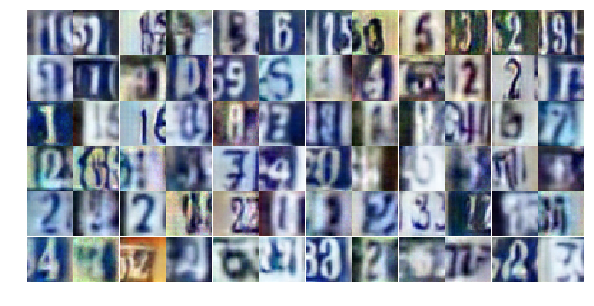

Epoch 20/25... Discriminator Loss: 0.5316... Generator Loss: 1.2684
Epoch 20/25... Discriminator Loss: 0.9837... Generator Loss: 0.6637
Epoch 20/25... Discriminator Loss: 0.6276... Generator Loss: 1.4974
Epoch 20/25... Discriminator Loss: 0.9759... Generator Loss: 0.8268
Epoch 20/25... Discriminator Loss: 0.9810... Generator Loss: 0.7032
Epoch 20/25... Discriminator Loss: 1.0465... Generator Loss: 0.6876
Epoch 20/25... Discriminator Loss: 0.9452... Generator Loss: 0.7271
Epoch 20/25... Discriminator Loss: 0.4498... Generator Loss: 1.4782
Epoch 20/25... Discriminator Loss: 0.7421... Generator Loss: 0.9057
Epoch 20/25... Discriminator Loss: 0.6768... Generator Loss: 0.9875


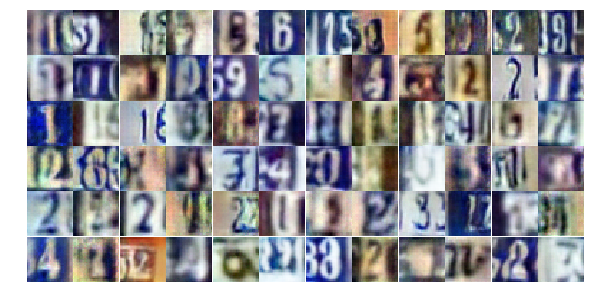

Epoch 20/25... Discriminator Loss: 0.5582... Generator Loss: 1.3036
Epoch 20/25... Discriminator Loss: 0.5837... Generator Loss: 1.6040
Epoch 20/25... Discriminator Loss: 0.5132... Generator Loss: 1.3210
Epoch 20/25... Discriminator Loss: 1.1787... Generator Loss: 0.5667
Epoch 20/25... Discriminator Loss: 0.5894... Generator Loss: 1.2569
Epoch 20/25... Discriminator Loss: 0.7845... Generator Loss: 0.8994
Epoch 21/25... Discriminator Loss: 1.2101... Generator Loss: 0.5818
Epoch 21/25... Discriminator Loss: 1.0168... Generator Loss: 0.7189
Epoch 21/25... Discriminator Loss: 1.1795... Generator Loss: 0.5719
Epoch 21/25... Discriminator Loss: 0.9070... Generator Loss: 0.7894


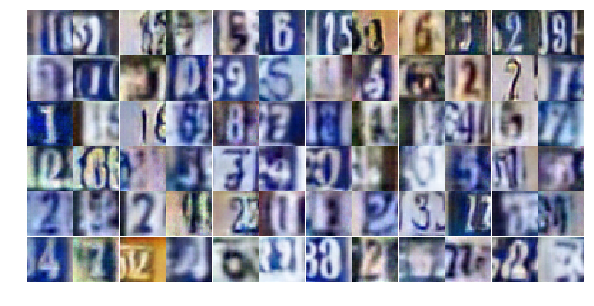

Epoch 21/25... Discriminator Loss: 0.7002... Generator Loss: 0.9788
Epoch 21/25... Discriminator Loss: 1.3575... Generator Loss: 0.4967
Epoch 21/25... Discriminator Loss: 0.4184... Generator Loss: 1.6151
Epoch 21/25... Discriminator Loss: 0.4620... Generator Loss: 1.3176
Epoch 21/25... Discriminator Loss: 0.6222... Generator Loss: 1.2798
Epoch 21/25... Discriminator Loss: 0.4750... Generator Loss: 1.4051
Epoch 21/25... Discriminator Loss: 0.9607... Generator Loss: 0.7454
Epoch 21/25... Discriminator Loss: 0.8719... Generator Loss: 0.8186
Epoch 21/25... Discriminator Loss: 0.5892... Generator Loss: 1.1351
Epoch 21/25... Discriminator Loss: 1.1812... Generator Loss: 0.5544


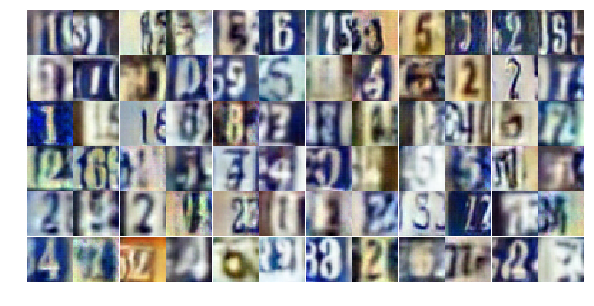

Epoch 21/25... Discriminator Loss: 0.4726... Generator Loss: 1.3085
Epoch 21/25... Discriminator Loss: 1.2746... Generator Loss: 0.5414
Epoch 21/25... Discriminator Loss: 1.6453... Generator Loss: 0.3861
Epoch 21/25... Discriminator Loss: 0.9461... Generator Loss: 0.8438
Epoch 21/25... Discriminator Loss: 0.7002... Generator Loss: 1.1965
Epoch 21/25... Discriminator Loss: 0.8467... Generator Loss: 0.7937
Epoch 21/25... Discriminator Loss: 0.9414... Generator Loss: 0.7550
Epoch 21/25... Discriminator Loss: 0.3880... Generator Loss: 1.8361
Epoch 21/25... Discriminator Loss: 0.6583... Generator Loss: 1.0065
Epoch 21/25... Discriminator Loss: 0.7016... Generator Loss: 1.0843


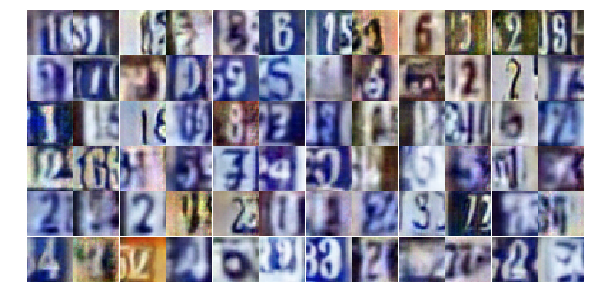

Epoch 21/25... Discriminator Loss: 1.6729... Generator Loss: 0.3460
Epoch 21/25... Discriminator Loss: 0.4315... Generator Loss: 1.4369
Epoch 21/25... Discriminator Loss: 1.3040... Generator Loss: 0.4612
Epoch 21/25... Discriminator Loss: 0.9396... Generator Loss: 0.7672
Epoch 21/25... Discriminator Loss: 0.8746... Generator Loss: 0.7740
Epoch 21/25... Discriminator Loss: 0.9568... Generator Loss: 0.7769
Epoch 21/25... Discriminator Loss: 0.5727... Generator Loss: 1.1634
Epoch 21/25... Discriminator Loss: 1.1764... Generator Loss: 0.5795
Epoch 21/25... Discriminator Loss: 1.7893... Generator Loss: 0.3082
Epoch 21/25... Discriminator Loss: 1.1393... Generator Loss: 0.6234


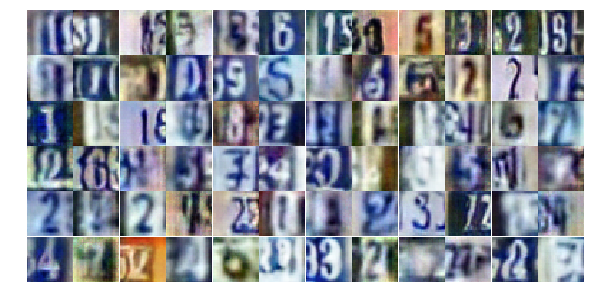

Epoch 21/25... Discriminator Loss: 1.4026... Generator Loss: 0.3845
Epoch 21/25... Discriminator Loss: 0.6757... Generator Loss: 1.1254
Epoch 21/25... Discriminator Loss: 1.1745... Generator Loss: 0.6487
Epoch 21/25... Discriminator Loss: 0.6869... Generator Loss: 1.2855
Epoch 21/25... Discriminator Loss: 0.5548... Generator Loss: 1.2345
Epoch 21/25... Discriminator Loss: 0.7364... Generator Loss: 1.0690
Epoch 21/25... Discriminator Loss: 1.0625... Generator Loss: 0.7047
Epoch 21/25... Discriminator Loss: 1.4939... Generator Loss: 0.3805
Epoch 21/25... Discriminator Loss: 1.3199... Generator Loss: 0.4828
Epoch 21/25... Discriminator Loss: 0.2546... Generator Loss: 2.9526


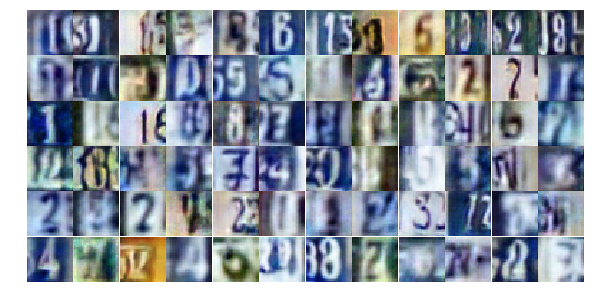

Epoch 21/25... Discriminator Loss: 6.7550... Generator Loss: 7.9487
Epoch 21/25... Discriminator Loss: 1.8026... Generator Loss: 0.3601
Epoch 21/25... Discriminator Loss: 1.1051... Generator Loss: 1.2040
Epoch 21/25... Discriminator Loss: 1.1666... Generator Loss: 0.7453
Epoch 21/25... Discriminator Loss: 0.6794... Generator Loss: 1.3442
Epoch 21/25... Discriminator Loss: 0.8658... Generator Loss: 1.2041
Epoch 21/25... Discriminator Loss: 1.2367... Generator Loss: 0.5566
Epoch 21/25... Discriminator Loss: 1.2338... Generator Loss: 0.6259
Epoch 21/25... Discriminator Loss: 1.3417... Generator Loss: 0.4950
Epoch 21/25... Discriminator Loss: 0.9354... Generator Loss: 0.7664


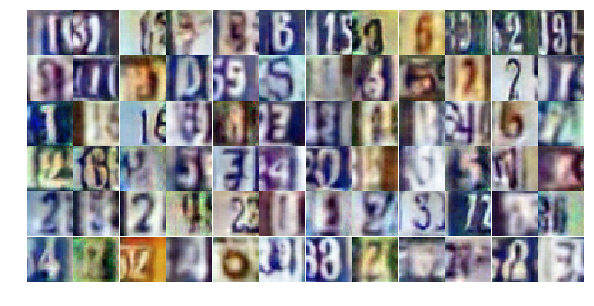

Epoch 21/25... Discriminator Loss: 0.6524... Generator Loss: 1.5901
Epoch 21/25... Discriminator Loss: 1.1488... Generator Loss: 0.6301
Epoch 21/25... Discriminator Loss: 0.5837... Generator Loss: 1.3649
Epoch 22/25... Discriminator Loss: 0.8372... Generator Loss: 1.7558
Epoch 22/25... Discriminator Loss: 0.8366... Generator Loss: 1.0020
Epoch 22/25... Discriminator Loss: 0.8984... Generator Loss: 0.8170
Epoch 22/25... Discriminator Loss: 0.6205... Generator Loss: 1.2006
Epoch 22/25... Discriminator Loss: 0.6743... Generator Loss: 1.0913
Epoch 22/25... Discriminator Loss: 0.9354... Generator Loss: 0.7819
Epoch 22/25... Discriminator Loss: 0.7082... Generator Loss: 1.0441


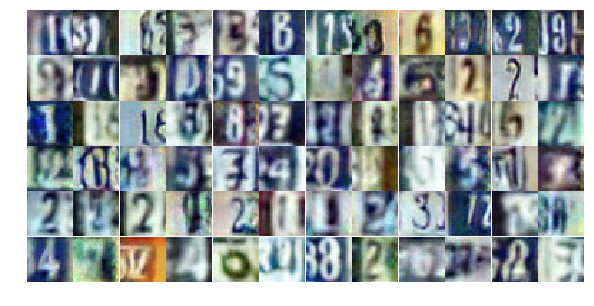

Epoch 22/25... Discriminator Loss: 0.6474... Generator Loss: 1.4794
Epoch 22/25... Discriminator Loss: 0.9511... Generator Loss: 0.8741
Epoch 22/25... Discriminator Loss: 1.4807... Generator Loss: 0.3689
Epoch 22/25... Discriminator Loss: 1.0282... Generator Loss: 0.6764
Epoch 22/25... Discriminator Loss: 0.8039... Generator Loss: 1.1532
Epoch 22/25... Discriminator Loss: 0.7480... Generator Loss: 0.9457
Epoch 22/25... Discriminator Loss: 0.7983... Generator Loss: 0.9629
Epoch 22/25... Discriminator Loss: 0.5674... Generator Loss: 1.2170
Epoch 22/25... Discriminator Loss: 1.0884... Generator Loss: 0.6147
Epoch 22/25... Discriminator Loss: 1.6207... Generator Loss: 0.3385


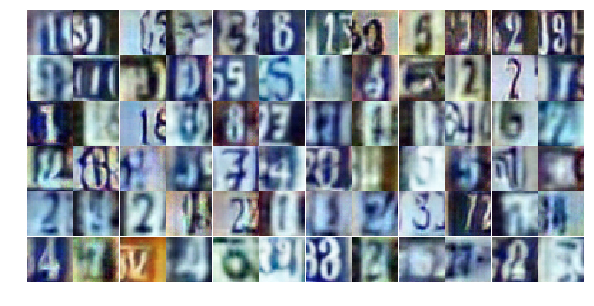

Epoch 22/25... Discriminator Loss: 0.4589... Generator Loss: 1.7929
Epoch 22/25... Discriminator Loss: 0.9359... Generator Loss: 0.7179
Epoch 22/25... Discriminator Loss: 0.6966... Generator Loss: 1.0621
Epoch 22/25... Discriminator Loss: 0.6796... Generator Loss: 1.2059
Epoch 22/25... Discriminator Loss: 0.8382... Generator Loss: 0.7056
Epoch 22/25... Discriminator Loss: 0.9111... Generator Loss: 0.8081
Epoch 22/25... Discriminator Loss: 0.4995... Generator Loss: 1.3764
Epoch 22/25... Discriminator Loss: 0.4695... Generator Loss: 1.5726
Epoch 22/25... Discriminator Loss: 0.7554... Generator Loss: 0.9301
Epoch 22/25... Discriminator Loss: 0.9465... Generator Loss: 0.6831


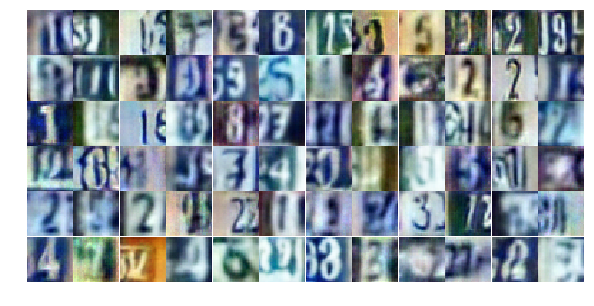

Epoch 22/25... Discriminator Loss: 0.5912... Generator Loss: 1.0753
Epoch 22/25... Discriminator Loss: 0.4480... Generator Loss: 1.4491
Epoch 22/25... Discriminator Loss: 1.1810... Generator Loss: 0.5262
Epoch 22/25... Discriminator Loss: 1.1281... Generator Loss: 0.5828
Epoch 22/25... Discriminator Loss: 0.8433... Generator Loss: 0.8316
Epoch 22/25... Discriminator Loss: 1.1257... Generator Loss: 0.7437
Epoch 22/25... Discriminator Loss: 1.6717... Generator Loss: 0.3071
Epoch 22/25... Discriminator Loss: 0.5013... Generator Loss: 1.7351
Epoch 22/25... Discriminator Loss: 1.1828... Generator Loss: 0.5662
Epoch 22/25... Discriminator Loss: 1.0384... Generator Loss: 0.6271


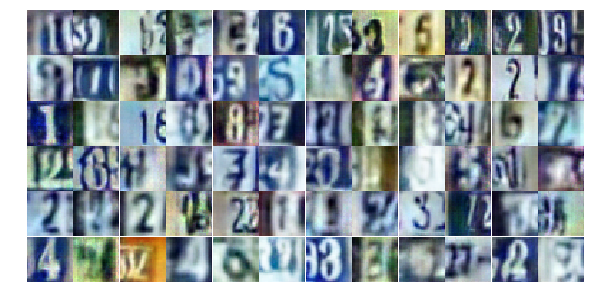

Epoch 22/25... Discriminator Loss: 0.7144... Generator Loss: 1.0283
Epoch 22/25... Discriminator Loss: 0.6341... Generator Loss: 1.1659
Epoch 22/25... Discriminator Loss: 0.4529... Generator Loss: 1.4116
Epoch 22/25... Discriminator Loss: 0.5939... Generator Loss: 1.1632
Epoch 22/25... Discriminator Loss: 0.4009... Generator Loss: 1.6060
Epoch 22/25... Discriminator Loss: 0.5921... Generator Loss: 1.1476
Epoch 22/25... Discriminator Loss: 0.7239... Generator Loss: 1.0000
Epoch 22/25... Discriminator Loss: 0.8782... Generator Loss: 0.8087
Epoch 22/25... Discriminator Loss: 0.6547... Generator Loss: 1.4114
Epoch 22/25... Discriminator Loss: 1.1461... Generator Loss: 0.6455


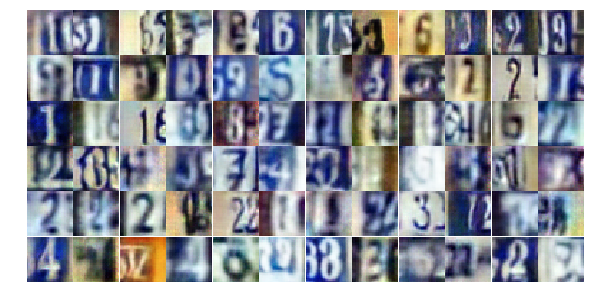

Epoch 22/25... Discriminator Loss: 0.9022... Generator Loss: 0.7425
Epoch 22/25... Discriminator Loss: 0.5758... Generator Loss: 1.4589
Epoch 22/25... Discriminator Loss: 1.2717... Generator Loss: 0.4684
Epoch 22/25... Discriminator Loss: 0.9951... Generator Loss: 0.7196
Epoch 22/25... Discriminator Loss: 0.7001... Generator Loss: 1.1571
Epoch 22/25... Discriminator Loss: 0.8442... Generator Loss: 1.8637
Epoch 22/25... Discriminator Loss: 1.2170... Generator Loss: 0.5912
Epoch 22/25... Discriminator Loss: 0.6542... Generator Loss: 1.1761
Epoch 22/25... Discriminator Loss: 0.7131... Generator Loss: 1.2789
Epoch 22/25... Discriminator Loss: 0.7569... Generator Loss: 0.9429


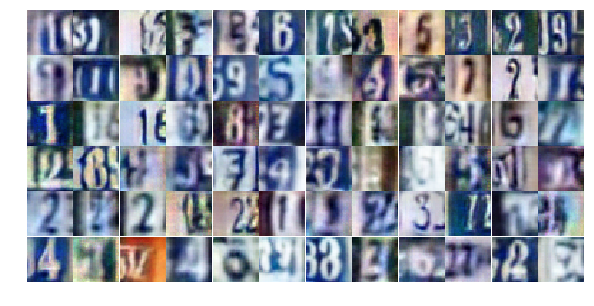

Epoch 23/25... Discriminator Loss: 0.5805... Generator Loss: 1.2969
Epoch 23/25... Discriminator Loss: 0.5252... Generator Loss: 1.4189
Epoch 23/25... Discriminator Loss: 0.9706... Generator Loss: 0.7271
Epoch 23/25... Discriminator Loss: 0.7290... Generator Loss: 0.8991
Epoch 23/25... Discriminator Loss: 0.9093... Generator Loss: 0.8042
Epoch 23/25... Discriminator Loss: 1.1419... Generator Loss: 0.5937
Epoch 23/25... Discriminator Loss: 0.9863... Generator Loss: 0.7107
Epoch 23/25... Discriminator Loss: 0.9016... Generator Loss: 0.8386
Epoch 23/25... Discriminator Loss: 0.7797... Generator Loss: 0.9389
Epoch 23/25... Discriminator Loss: 0.6063... Generator Loss: 1.2632


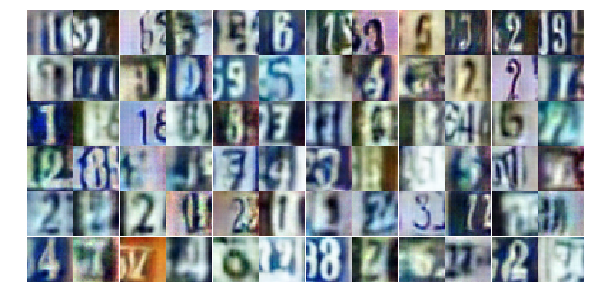

Epoch 23/25... Discriminator Loss: 0.5506... Generator Loss: 1.2235
Epoch 23/25... Discriminator Loss: 0.8707... Generator Loss: 0.7622
Epoch 23/25... Discriminator Loss: 0.8574... Generator Loss: 0.8546
Epoch 23/25... Discriminator Loss: 0.6313... Generator Loss: 1.1702
Epoch 23/25... Discriminator Loss: 0.4227... Generator Loss: 1.6120
Epoch 23/25... Discriminator Loss: 0.7918... Generator Loss: 0.8480
Epoch 23/25... Discriminator Loss: 0.9791... Generator Loss: 0.6489
Epoch 23/25... Discriminator Loss: 0.8635... Generator Loss: 0.8404
Epoch 23/25... Discriminator Loss: 1.0679... Generator Loss: 0.6559
Epoch 23/25... Discriminator Loss: 1.0543... Generator Loss: 0.6341


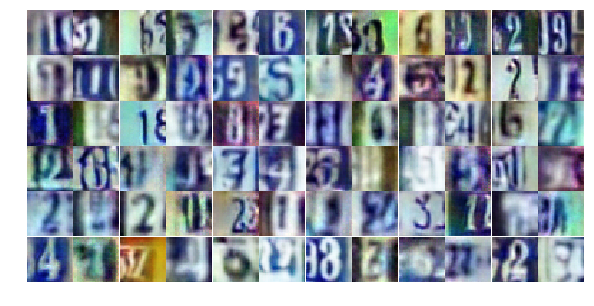

Epoch 23/25... Discriminator Loss: 1.3454... Generator Loss: 0.4666
Epoch 23/25... Discriminator Loss: 0.6278... Generator Loss: 1.0319
Epoch 23/25... Discriminator Loss: 1.1880... Generator Loss: 0.5191
Epoch 23/25... Discriminator Loss: 0.7176... Generator Loss: 1.2041
Epoch 23/25... Discriminator Loss: 0.7760... Generator Loss: 1.1051
Epoch 23/25... Discriminator Loss: 0.6959... Generator Loss: 1.4879
Epoch 23/25... Discriminator Loss: 1.3795... Generator Loss: 0.4324
Epoch 23/25... Discriminator Loss: 0.9263... Generator Loss: 0.7841
Epoch 23/25... Discriminator Loss: 0.9050... Generator Loss: 0.7529
Epoch 23/25... Discriminator Loss: 0.7547... Generator Loss: 1.2012


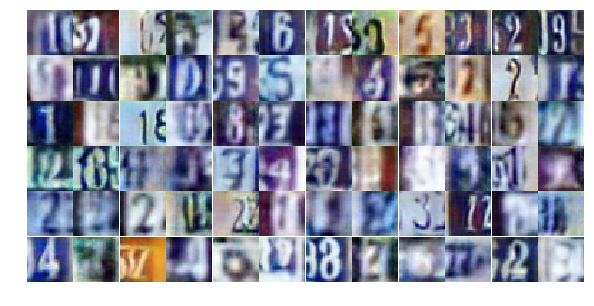

Epoch 23/25... Discriminator Loss: 0.5556... Generator Loss: 1.3250
Epoch 23/25... Discriminator Loss: 0.6650... Generator Loss: 0.9717
Epoch 23/25... Discriminator Loss: 0.7625... Generator Loss: 0.9823
Epoch 23/25... Discriminator Loss: 1.6514... Generator Loss: 0.3698
Epoch 23/25... Discriminator Loss: 0.8786... Generator Loss: 0.9219
Epoch 23/25... Discriminator Loss: 1.9809... Generator Loss: 0.2478
Epoch 23/25... Discriminator Loss: 1.1804... Generator Loss: 0.6730
Epoch 23/25... Discriminator Loss: 0.9559... Generator Loss: 0.7192
Epoch 23/25... Discriminator Loss: 0.4346... Generator Loss: 1.6126
Epoch 23/25... Discriminator Loss: 0.6072... Generator Loss: 1.1458


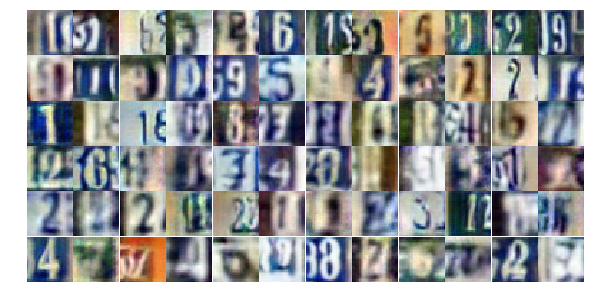

Epoch 23/25... Discriminator Loss: 0.9747... Generator Loss: 0.7409
Epoch 23/25... Discriminator Loss: 0.8437... Generator Loss: 0.7573
Epoch 23/25... Discriminator Loss: 1.0299... Generator Loss: 3.3394
Epoch 23/25... Discriminator Loss: 1.1020... Generator Loss: 0.6541
Epoch 23/25... Discriminator Loss: 0.8289... Generator Loss: 0.8554
Epoch 23/25... Discriminator Loss: 1.2318... Generator Loss: 0.5176
Epoch 23/25... Discriminator Loss: 0.7390... Generator Loss: 1.0818
Epoch 23/25... Discriminator Loss: 1.7776... Generator Loss: 0.2907
Epoch 23/25... Discriminator Loss: 0.7613... Generator Loss: 1.5163
Epoch 23/25... Discriminator Loss: 0.5670... Generator Loss: 1.1834


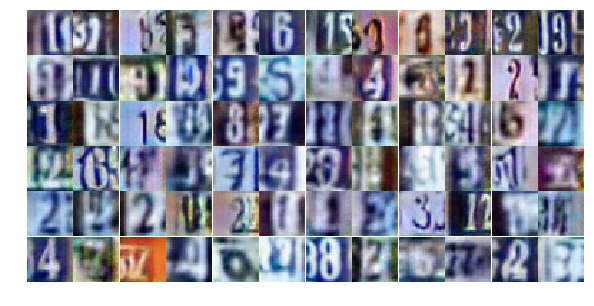

Epoch 23/25... Discriminator Loss: 0.7417... Generator Loss: 0.9662
Epoch 23/25... Discriminator Loss: 1.7379... Generator Loss: 0.2788
Epoch 23/25... Discriminator Loss: 1.0290... Generator Loss: 0.7324
Epoch 23/25... Discriminator Loss: 0.4179... Generator Loss: 1.7984
Epoch 23/25... Discriminator Loss: 1.2492... Generator Loss: 0.4507
Epoch 23/25... Discriminator Loss: 0.5058... Generator Loss: 1.4401
Epoch 23/25... Discriminator Loss: 0.6382... Generator Loss: 1.0747
Epoch 24/25... Discriminator Loss: 1.0433... Generator Loss: 0.6232
Epoch 24/25... Discriminator Loss: 0.7648... Generator Loss: 0.9623
Epoch 24/25... Discriminator Loss: 0.9508... Generator Loss: 0.7568


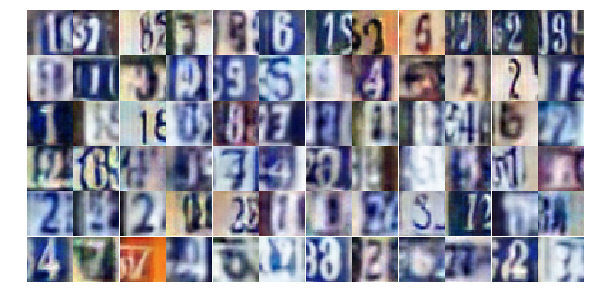

Epoch 24/25... Discriminator Loss: 0.6588... Generator Loss: 1.4729
Epoch 24/25... Discriminator Loss: 0.7747... Generator Loss: 0.8550
Epoch 24/25... Discriminator Loss: 0.6194... Generator Loss: 1.2173
Epoch 24/25... Discriminator Loss: 0.8802... Generator Loss: 1.5841
Epoch 24/25... Discriminator Loss: 1.2357... Generator Loss: 0.5160
Epoch 24/25... Discriminator Loss: 0.6079... Generator Loss: 1.3115
Epoch 24/25... Discriminator Loss: 0.7316... Generator Loss: 0.9355
Epoch 24/25... Discriminator Loss: 1.1135... Generator Loss: 0.5410
Epoch 24/25... Discriminator Loss: 0.5719... Generator Loss: 1.1053
Epoch 24/25... Discriminator Loss: 0.5612... Generator Loss: 1.3005


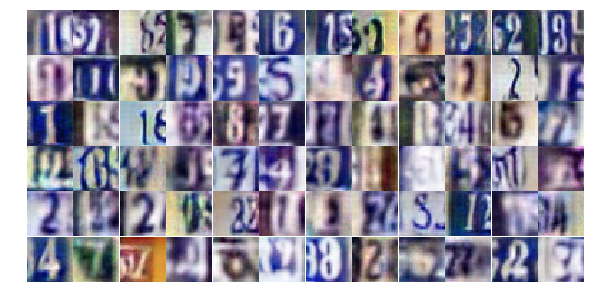

Epoch 24/25... Discriminator Loss: 1.3878... Generator Loss: 0.3954
Epoch 24/25... Discriminator Loss: 1.2744... Generator Loss: 0.4768
Epoch 24/25... Discriminator Loss: 1.1000... Generator Loss: 0.6926
Epoch 24/25... Discriminator Loss: 0.7004... Generator Loss: 0.9876
Epoch 24/25... Discriminator Loss: 0.6087... Generator Loss: 3.2360
Epoch 24/25... Discriminator Loss: 1.1208... Generator Loss: 0.6045
Epoch 24/25... Discriminator Loss: 0.7409... Generator Loss: 0.8935
Epoch 24/25... Discriminator Loss: 1.1190... Generator Loss: 0.5690
Epoch 24/25... Discriminator Loss: 1.0121... Generator Loss: 2.4026
Epoch 24/25... Discriminator Loss: 0.8404... Generator Loss: 0.7763


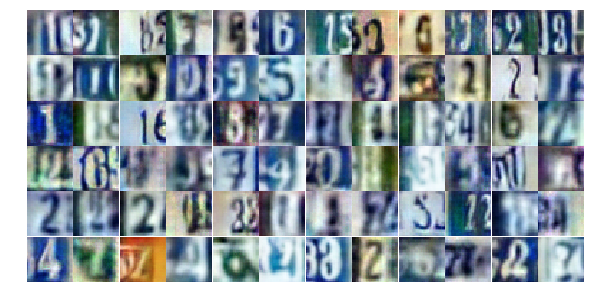

Epoch 24/25... Discriminator Loss: 0.8941... Generator Loss: 0.7733
Epoch 24/25... Discriminator Loss: 0.6226... Generator Loss: 1.3445
Epoch 24/25... Discriminator Loss: 0.9633... Generator Loss: 3.2975
Epoch 24/25... Discriminator Loss: 1.2843... Generator Loss: 0.4911
Epoch 24/25... Discriminator Loss: 1.0265... Generator Loss: 0.6783
Epoch 24/25... Discriminator Loss: 0.7453... Generator Loss: 0.8280
Epoch 24/25... Discriminator Loss: 0.4932... Generator Loss: 1.3024
Epoch 24/25... Discriminator Loss: 0.6209... Generator Loss: 1.3378
Epoch 24/25... Discriminator Loss: 0.7861... Generator Loss: 0.8104
Epoch 24/25... Discriminator Loss: 0.9330... Generator Loss: 0.7179


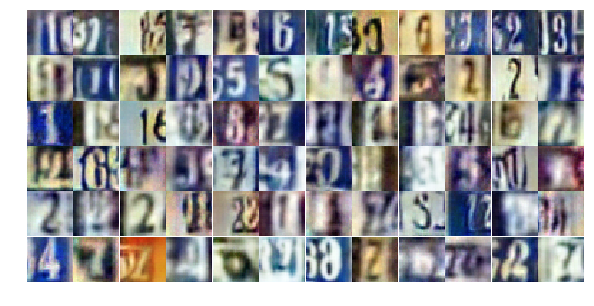

Epoch 24/25... Discriminator Loss: 0.4726... Generator Loss: 2.4605
Epoch 24/25... Discriminator Loss: 0.5872... Generator Loss: 2.6535
Epoch 24/25... Discriminator Loss: 0.6980... Generator Loss: 1.2562
Epoch 24/25... Discriminator Loss: 1.4265... Generator Loss: 0.4259
Epoch 24/25... Discriminator Loss: 1.0609... Generator Loss: 0.5782
Epoch 24/25... Discriminator Loss: 0.7918... Generator Loss: 0.8509
Epoch 24/25... Discriminator Loss: 0.9666... Generator Loss: 0.7248
Epoch 24/25... Discriminator Loss: 0.7082... Generator Loss: 1.1356
Epoch 24/25... Discriminator Loss: 1.2807... Generator Loss: 0.5082
Epoch 24/25... Discriminator Loss: 0.4951... Generator Loss: 1.7082


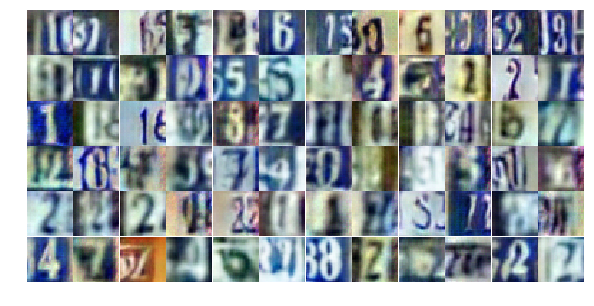

Epoch 24/25... Discriminator Loss: 0.7833... Generator Loss: 0.9575
Epoch 24/25... Discriminator Loss: 1.5252... Generator Loss: 0.4292
Epoch 24/25... Discriminator Loss: 1.4245... Generator Loss: 0.4362
Epoch 24/25... Discriminator Loss: 1.3061... Generator Loss: 0.4977
Epoch 24/25... Discriminator Loss: 0.8401... Generator Loss: 0.8556
Epoch 24/25... Discriminator Loss: 0.7456... Generator Loss: 1.7295
Epoch 24/25... Discriminator Loss: 1.1628... Generator Loss: 0.6924
Epoch 24/25... Discriminator Loss: 0.9624... Generator Loss: 0.6664
Epoch 24/25... Discriminator Loss: 0.8157... Generator Loss: 0.8294
Epoch 24/25... Discriminator Loss: 1.3292... Generator Loss: 0.5797


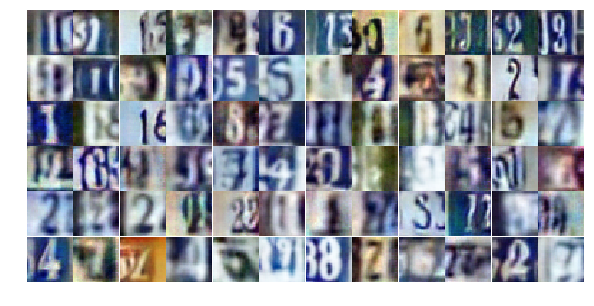

Epoch 24/25... Discriminator Loss: 0.9238... Generator Loss: 0.7008
Epoch 24/25... Discriminator Loss: 1.1418... Generator Loss: 0.6011
Epoch 24/25... Discriminator Loss: 1.2340... Generator Loss: 0.5305
Epoch 24/25... Discriminator Loss: 1.0446... Generator Loss: 0.6825
Epoch 24/25... Discriminator Loss: 1.0629... Generator Loss: 0.6215
Epoch 25/25... Discriminator Loss: 0.6440... Generator Loss: 1.0622
Epoch 25/25... Discriminator Loss: 0.7140... Generator Loss: 2.2208
Epoch 25/25... Discriminator Loss: 1.0270... Generator Loss: 0.6708
Epoch 25/25... Discriminator Loss: 0.9203... Generator Loss: 0.7422
Epoch 25/25... Discriminator Loss: 1.6317... Generator Loss: 0.3124


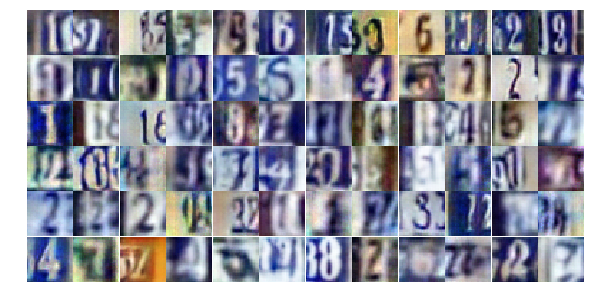

Epoch 25/25... Discriminator Loss: 1.1764... Generator Loss: 0.5234
Epoch 25/25... Discriminator Loss: 1.5261... Generator Loss: 0.4496
Epoch 25/25... Discriminator Loss: 0.5942... Generator Loss: 1.2468
Epoch 25/25... Discriminator Loss: 0.6691... Generator Loss: 1.1918
Epoch 25/25... Discriminator Loss: 0.8351... Generator Loss: 1.2731
Epoch 25/25... Discriminator Loss: 0.8056... Generator Loss: 1.0080
Epoch 25/25... Discriminator Loss: 0.6877... Generator Loss: 2.3995
Epoch 25/25... Discriminator Loss: 0.8603... Generator Loss: 2.0394
Epoch 25/25... Discriminator Loss: 0.5673... Generator Loss: 1.4394
Epoch 25/25... Discriminator Loss: 0.8193... Generator Loss: 0.9019


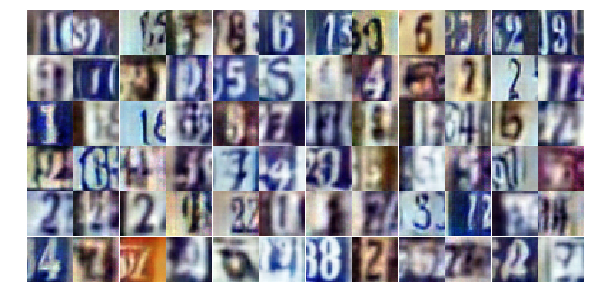

Epoch 25/25... Discriminator Loss: 0.8224... Generator Loss: 0.9987
Epoch 25/25... Discriminator Loss: 0.4572... Generator Loss: 1.9144
Epoch 25/25... Discriminator Loss: 0.7761... Generator Loss: 0.9112
Epoch 25/25... Discriminator Loss: 0.8188... Generator Loss: 0.8492
Epoch 25/25... Discriminator Loss: 0.7329... Generator Loss: 1.0855
Epoch 25/25... Discriminator Loss: 0.7286... Generator Loss: 1.0104
Epoch 25/25... Discriminator Loss: 0.8789... Generator Loss: 1.4294
Epoch 25/25... Discriminator Loss: 1.3844... Generator Loss: 0.4472
Epoch 25/25... Discriminator Loss: 0.4858... Generator Loss: 1.3479
Epoch 25/25... Discriminator Loss: 0.7757... Generator Loss: 0.9575


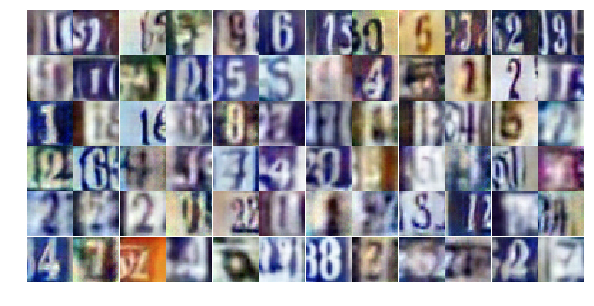

Epoch 25/25... Discriminator Loss: 0.8783... Generator Loss: 0.8075
Epoch 25/25... Discriminator Loss: 0.7266... Generator Loss: 1.0753
Epoch 25/25... Discriminator Loss: 1.6707... Generator Loss: 0.3581
Epoch 25/25... Discriminator Loss: 0.6259... Generator Loss: 1.1302
Epoch 25/25... Discriminator Loss: 0.9645... Generator Loss: 0.6722
Epoch 25/25... Discriminator Loss: 0.4967... Generator Loss: 1.3009
Epoch 25/25... Discriminator Loss: 1.5333... Generator Loss: 0.3864
Epoch 25/25... Discriminator Loss: 0.6540... Generator Loss: 1.0010
Epoch 25/25... Discriminator Loss: 1.7574... Generator Loss: 3.6991
Epoch 25/25... Discriminator Loss: 0.2819... Generator Loss: 2.2626


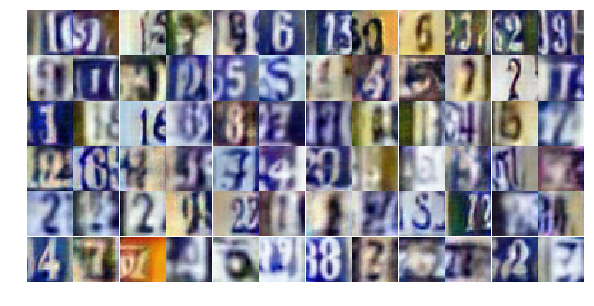

Epoch 25/25... Discriminator Loss: 5.4714... Generator Loss: 0.0297
Epoch 25/25... Discriminator Loss: 0.6992... Generator Loss: 1.2851
Epoch 25/25... Discriminator Loss: 0.6879... Generator Loss: 1.3593
Epoch 25/25... Discriminator Loss: 0.6893... Generator Loss: 1.0788
Epoch 25/25... Discriminator Loss: 0.8878... Generator Loss: 0.8294
Epoch 25/25... Discriminator Loss: 0.9108... Generator Loss: 0.7925
Epoch 25/25... Discriminator Loss: 0.7123... Generator Loss: 1.0914
Epoch 25/25... Discriminator Loss: 0.7933... Generator Loss: 0.9208
Epoch 25/25... Discriminator Loss: 1.7409... Generator Loss: 0.3007
Epoch 25/25... Discriminator Loss: 0.8054... Generator Loss: 0.8119


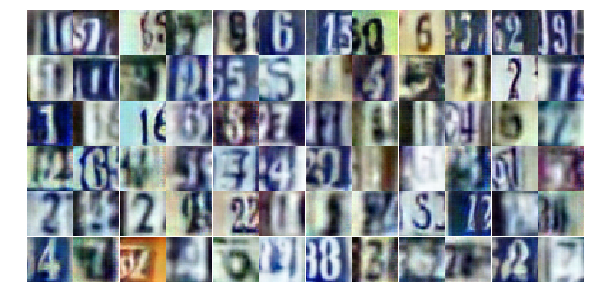

Epoch 25/25... Discriminator Loss: 0.9922... Generator Loss: 0.8856
Epoch 25/25... Discriminator Loss: 0.7836... Generator Loss: 0.8919
Epoch 25/25... Discriminator Loss: 1.1553... Generator Loss: 0.5705
Epoch 25/25... Discriminator Loss: 0.6456... Generator Loss: 1.1067


In [ ]:
dataset = Dataset(trainset, testset)

losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))

In [ ]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))